# Analyis for the Dark Machines Collider Unsupervised Challenge
This notebook examines the results for the [hackathon dataset](https://zenodo.org/record/3961917#.X2tooJNKhQM). The methods were trained on background only samples and then applied to a mix of background and signal. In this step of the challenge, truth information was available. This was used to determine the receiver operating characteristic (ROC) curve, the area under the ROC curve (AUC), and the signal effeficency at different fixed background rejection working points.

There are 1040 different models which were submitted. They are applied to 19 different dark matter signals across 4 channels, for a combined 34 unique channel + signature combinations.

Notebook author: Bryan Ostdiek (bostdiek at g.harvard.edu)

In [1]:
import pickle
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gs
from matplotlib.patches import Patch
from matplotlib.lines import Line2D
import matplotlib.markers as mmark

from scipy.interpolate import interp1d

from os import walk, path

from sklearn.metrics import roc_curve, auc
from sklearn.cluster import KMeans, DBSCAN
from sklearn.preprocessing import MinMaxScaler

In [2]:
print(f'Using numpy version {np.version.version}: known to work with 1.19.1')
print(f'Using pandas version {pd.__version__}: known to work with 1.1.1')

Using numpy version 1.19.1: known to work with 1.19.1
Using pandas version 1.1.1: known to work with 1.1.1


Some functions may not work with different versions of numpy or pandas

In [3]:
plt.rcParams.update({'font.family': 'cmr10',
                     'font.size': 12,
                     'axes.unicode_minus': False,
                     'axes.labelsize': 12,
                     'axes.labelsize': 12,
                     'figure.figsize': (4, 4),
                     'figure.dpi': 160,
                     'mathtext.fontset': 'cm',
                     'mathtext.rm': 'serif',
                     'xtick.direction': 'in',
                     'ytick.direction': 'in',
                     'xtick.top': True,
                     'ytick.right': True
                     })

# Load Data Files
## Adam Leinweber - Anomaly detection in the Latent Space of a VAE

In [4]:
AL = pd.read_csv('../data/all_csv/Adam_Leinweber_latent_combined_scores_all.csv',
            names=['Signal', 'Model', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']
           )
AL['Model'] = 'LS_' + AL['Model']

In [5]:
print(list(AL['Model'].unique()))

['LS_IF_13_0.001_1000', 'LS_IF_13_0.001_10000', 'LS_IF_13_0.1_1000', 'LS_IF_13_0.1_10000', 'LS_IF_13_1.0_1000', 'LS_IF_13_1.0_10000', 'LS_IF_13_1e-05_1000', 'LS_IF_13_1e-05_10000', 'LS_IF_20_0.001_1000', 'LS_IF_20_0.001_10000', 'LS_IF_20_0.1_1000', 'LS_IF_20_0.1_10000', 'LS_IF_20_1.0_1000', 'LS_IF_20_1.0_10000', 'LS_IF_20_1e-05_1000', 'LS_IF_20_1e-05_10000', 'LS_IF_30_0.001_1000', 'LS_IF_30_0.001_10000', 'LS_IF_30_0.1_1000', 'LS_IF_30_0.1_10000', 'LS_IF_30_1.0_1000', 'LS_IF_30_1.0_10000', 'LS_IF_30_1e-05_1000', 'LS_IF_30_1e-05_10000', 'LS_IF_4_0.001_1000', 'LS_IF_4_0.001_10000', 'LS_IF_4_0.1_1000', 'LS_IF_4_0.1_10000', 'LS_IF_4_1.0_1000', 'LS_IF_4_1.0_10000', 'LS_IF_4_1e-05_1000', 'LS_IF_4_1e-05_10000', 'LS_GMM_13_0.001_1000', 'LS_GMM_13_0.001_10000', 'LS_GMM_13_0.1_1000', 'LS_GMM_13_0.1_10000', 'LS_GMM_13_1.0_1000', 'LS_GMM_13_1.0_10000', 'LS_GMM_13_1e-05_1000', 'LS_GMM_13_1e-05_10000', 'LS_GMM_20_0.001_1000', 'LS_GMM_20_0.001_10000', 'LS_GMM_20_0.1_1000', 'LS_GMM_20_0.1_10000', 'LS_G

In [6]:
LatentSpaceModels = list(AL['Model'].unique())

## Pratik Jawahar - Normalizing Flows

In [7]:
PJ = pd.read_csv('../data/all_csv/VAEwNormFlows_Results.csv',
                 names=['Signal', 'Model', 'AUC', '1e-2', '1e-3', '1e-4']
           )
snames = list(PJ['Signal'])
chan = [s.split('/')[0].replace('chan', '').replace('_sig', '') for s in snames]
snames = [s.split('/')[-1] for s in snames]

snames = ['_'.join(s.split('_')[:-1]) for s in snames]
PJ['Signal'] = snames
PJ['Chan'] = chan

In [8]:
print(list(PJ['Model'].unique()))

['VAE_NoF', 'VAE_PlanarFlow', 'VAE_HouseholderSNF', 'VAE_OrthogonalSNF', 'VAE_TriangularSNF', 'VAE_IAF', 'VAE_ConvolutionalFlow']


In [9]:
NormalizingFlowModels = list(PJ['Model'].unique())

## Alessandro Morandini - Density based models

In [10]:
AM = pd.read_csv('../data/all_csv/DE_scores.csv',
                 names=['Signal', 'Model', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']
                )

In [11]:
AM['Model'] = 'Density_' + AM['Model']

In [12]:
print(list(AM['Model'].unique()))

['Density_PCA_D=2', 'Density_PCA_D=3', 'Density_PCA_D=4', 'Density_PCA_D=5', 'Density_PCA_D=6', 'Density_PCA_D=7', 'Density_PCA_D=8', 'Density_PCA_D=9', 'Density_PCA_D=10', 'Density_VAE_b=1e-5_D=2', 'Density_VAE_b=1e-5_D=3', 'Density_VAE_b=1e-5_D=4', 'Density_VAE_b=1e-5_D=5', 'Density_VAE_b=1e-5_D=6', 'Density_VAE_b=1e-5_D=7', 'Density_VAE_b=1e-5_D=8', 'Density_VAE_b=1e-5_D=9', 'Density_VAE_b=1e-5_D=10', 'Density_VAE_b=1e-3_D=2', 'Density_VAE_b=1e-3_D=3', 'Density_VAE_b=1e-3_D=4', 'Density_VAE_b=1e-3_D=5', 'Density_VAE_b=1e-3_D=6', 'Density_VAE_b=1e-3_D=7', 'Density_VAE_b=1e-3_D=8', 'Density_VAE_b=1e-3_D=9', 'Density_VAE_b=1e-3_D=10', 'Density_VAE_b=1e-1_D=2', 'Density_VAE_b=1e-1_D=3', 'Density_VAE_b=1e-1_D=4', 'Density_VAE_b=1e-1_D=5', 'Density_VAE_b=1e-1_D=6', 'Density_VAE_b=1e-1_D=7', 'Density_VAE_b=1e-1_D=8', 'Density_VAE_b=1e-1_D=9', 'Density_VAE_b=1e-1_D=10']


In [13]:
DensityBasedModels = list(AM['Model'].unique())

## Luc Hendrix - Beta Variational Autoencoders

In [14]:
LH_VAE = pd.read_csv('../data/all_csv/vae_auc_scores.csv', 
                     names=['Signal', 'Modelt', 'Metric', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']
                    )
LH_VAE['Model'] = LH_VAE['Modelt'] + '_' + LH_VAE['Metric']
LH_VAE['Model'] = [s.replace('VAE Radius', 'Fixed target KL') for s in list(LH_VAE['Model'])]

In [15]:
print(list(LH_VAE['Model'].unique()))
VAE_MODELS = list(LH_VAE['Model'].unique())

['VAE-static-beta1e-06-z5_RL', 'VAE-static-beta1e-06-z5_Radius', 'VAE-dynamic-beta1e-06-z5_RL', 'VAE-dynamic-beta1e-06-z5_Radius', 'VAE-static-beta1e-06-z8_RL', 'VAE-static-beta1e-06-z8_Radius', 'VAE-dynamic-beta1e-06-z8_RL', 'VAE-dynamic-beta1e-06-z8_Radius', 'VAE-static-beta1e-06-z13_RL', 'VAE-static-beta1e-06-z13_Radius', 'VAE-dynamic-beta1e-06-z13_RL', 'VAE-dynamic-beta1e-06-z13_Radius', 'VAE-static-beta1e-06-z21_RL', 'VAE-static-beta1e-06-z21_Radius', 'VAE-dynamic-beta1e-06-z21_RL', 'VAE-dynamic-beta1e-06-z21_Radius', 'VAE-static-beta1e-06-z34_RL', 'VAE-static-beta1e-06-z34_Radius', 'VAE-dynamic-beta1e-06-z34_RL', 'VAE-dynamic-beta1e-06-z34_Radius', 'VAE-static-beta0.001-z5_RL', 'VAE-static-beta0.001-z5_Radius', 'VAE-dynamic-beta0.001-z5_RL', 'VAE-dynamic-beta0.001-z5_Radius', 'VAE-static-beta0.001-z8_RL', 'VAE-static-beta0.001-z8_Radius', 'VAE-dynamic-beta0.001-z8_RL', 'VAE-dynamic-beta0.001-z8_Radius', 'VAE-static-beta0.001-z13_RL', 'VAE-static-beta0.001-z13_Radius', 'VAE-dynami

## Luc Hendrix - Flow based likelihoods

In [16]:
LH_Flow = pd.read_csv('../data/all_csv/lh_flow_scores.csv',  # flow_auc_scores.csv
                     names=['Signal', 'Modelt', 'Metric', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']
                    )
LH_Flow['Model'] = LH_Flow['Modelt'] + '_' + LH_Flow['Metric']
LH_Flow['Model'] = [s.replace('VAE Radius', 'Fixed target KL') for s in list(LH_Flow['Model'])]

In [17]:
LH_Flow = LH_Flow[~LH_Flow.duplicated()]

In [18]:
print(list(LH_Flow['Model'].unique()))

['Flow-Efficient_Likelihood', 'Flow-Efficient-No-E_Likelihood']


## Luc Hendrix - Combined

In [19]:
LH_Combined = pd.read_csv('../data/all_csv/lh_combined_scores.csv',  # combined_scores.csv
                     names=['Signal', 'Modelt', 'Metric', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']
                    )
LH_Combined['Model'] = LH_Combined['Modelt'] + '_' + LH_Combined['Metric']
LH_Combined['Model'] = [s.replace('VAE Radius', 'Fixed target KL') for s in list(LH_Combined['Model'])]

In [20]:
print(list(LH_Combined['Model'].unique()))
CombinedModels = list(LH_Combined['Model'].unique())

['Combined-FixedTarget-Flow-AND_Fixed target MSE + Flow Likelihood', 'Combined-FixedTarget-Flow-OR_Fixed target MSE + Flow Likelihood', 'Combined-FixedTarget-Flow-PROD_Fixed target MSE + Flow Likelihood', 'Combined-FixedTarget-Flow-AVG_Fixed target MSE + Flow Likelihood', 'Combined-FixedTargetKL-Flow-AND_Fixed target KL + Flow Likelihood', 'Combined-FixedTargetKL-Flow-OR_Fixed target KL + Flow Likelihood', 'Combined-FixedTargetKL-Flow-PROD_Fixed target KL + Flow Likelihood', 'Combined-FixedTargetKL-Flow-AVG_Fixed target KL + Flow Likelihood']


## Luc Hendrix - Fixed Target

In [21]:
LH_Fixed = pd.read_csv('../data/all_csv/results-fixed-target.csv',
                     names=['Signal', 'Modelt', 'Metric', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']
                    )
LH_Fixed['Model'] = LH_Fixed['Modelt'] + '_' + LH_Fixed['Metric']

In [22]:
print(list(LH_Fixed['Model']))
FixedTargetModels = list(LH_Fixed['Model'])

['Fixed-combined-z5_MSE', 'Fixed-combined-z8_MSE', 'Fixed-combined-z13_MSE', 'Fixed-combined-z21_MSE', 'Fixed-combined-z34_MSE', 'Fixed-combined-z55_MSE', 'Fixed-combined-z89_MSE', 'Fixed-combined-z144_MSE', 'Fixed-combined-z233_MSE', 'Fixed-combined-z377_MSE', 'Fixed-MSE0-z5_MSE', 'Fixed-MSE0-z8_MSE', 'Fixed-MSE0-z13_MSE', 'Fixed-MSE0-z21_MSE', 'Fixed-MSE0-z34_MSE', 'Fixed-MSE0-z55_MSE', 'Fixed-MSE0-z89_MSE', 'Fixed-MSE0-z144_MSE', 'Fixed-MSE0-z233_MSE', 'Fixed-MSE0-z377_MSE', 'Fixed-MSE1-z5_MSE', 'Fixed-MSE1-z8_MSE', 'Fixed-MSE1-z13_MSE', 'Fixed-MSE1-z21_MSE', 'Fixed-MSE1-z34_MSE', 'Fixed-MSE1-z55_MSE', 'Fixed-MSE1-z89_MSE', 'Fixed-MSE1-z144_MSE', 'Fixed-MSE1-z233_MSE', 'Fixed-MSE1-z377_MSE', 'Fixed-MSE2-z5_MSE', 'Fixed-MSE2-z8_MSE', 'Fixed-MSE2-z13_MSE', 'Fixed-MSE2-z21_MSE', 'Fixed-MSE2-z34_MSE', 'Fixed-MSE2-z55_MSE', 'Fixed-MSE2-z89_MSE', 'Fixed-MSE2-z144_MSE', 'Fixed-MSE2-z233_MSE', 'Fixed-MSE2-z377_MSE', 'Fixed-MSE3-z5_MSE', 'Fixed-MSE3-z8_MSE', 'Fixed-MSE3-z13_MSE', 'Fixed-MSE3

## Bryan Ostdiek - Deep Sets

In [23]:
BO = pd.read_csv('../data/all_csv/DeepSetsVAE_8d_results_combined.csv')
snames = list(BO['Signal'])
chan = [s.split('_')[-1].replace('chan', '') for s in snames]
sig = ['_'.join(s.split('_')[:-1]) for s in snames]
BO['Signal'] = sig
BO['Chan'] = chan
BO['Model'] = BO['ModelName']
BO['1e-2'] = BO['S1e-2']
BO['1e-3'] = BO['S1e-3']
BO['1e-4'] = BO['S1e-4']

In [24]:
BO['Model'] = [s.replace('VAE_beta_1.0_', ' Fixed target KL ') for s in list(BO['Model'])]

In [25]:
print(list(BO['Model'].unique()))
DeepSetModels = list(BO['Model'].unique())

['DeepSet Fixed target KL weight_1.0', 'DeepSet Fixed target KL weight_10.0', 'DeepSetVAE_beta_0.001_weight_1.0', 'DeepSetVAE_beta_0.001_weight_10.0']


## Baptiste Ravina - Standard Autoencoder

In [26]:
BR = pd.read_csv('../data/all_csv/CrudeAE_data.csv')
snames = list(BR['Signal'])
chan = [s.split('_')[-1].replace('chan', '') for s in snames]
sig = ['_'.join(s.split('_')[:-1]) for s in snames]
BR['Signal'] = sig
BR['Chan'] = chan
BR['Model'] = BR['ModelName']
BR['1e-2'] = BR['S1e-2']
BR['1e-3'] = BR['S1e-3']
BR['1e-4'] = BR['S1e-4']

In [27]:
print(list(BR['Model'].unique()))

['crude_AE']


## Joe Davies - CNN BVAE

In [28]:
JD_BVAE = pd.read_csv('../data/all_csv/cnn_bvae_results.csv')
JD_BVAE['Channel'] = JD_BVAE['Channel'].fillna(method='ffill')
JD_BVAE.fillna(0, inplace=True)
JD_BVAE['Chan'] = JD_BVAE['Channel']
JD_BVAE['1e-2'] = JD_BVAE['epsilon1']
JD_BVAE['1e-3'] = JD_BVAE['epsilon2']

# fix bad file format
JD_BVAE['1e-4'] = [float(x.strip().split(',')[0].replace('E', 'e')) for x in JD_BVAE['epsilon3']]

JD_BVAE['Model'] = 'CNN_BVAE'

In [29]:
print(list(JD_BVAE['Model'].unique()))

['CNN_BVAE']


Data cleaning to clear up white spaces in file columns

In [30]:
# find singals with non-standardized notation to fix
l1 = list(JD_BVAE['Signal'].unique())
lall = list(BO['Signal'].unique())

for s in lall:
    if s not in l1:
        print(f'New signal {s}')
        
print()
for s in l1:
    if s not in lall:
        print(f'New signal {s}')

New signal monoV_Zp2000.0_DM_1.0

New signal monotop_200
New signal stop2b1000
New signal sqsq1_sq1400
New signal monoV_Zp2000.0_DM_1.0 


In [31]:
for s in lall:
    if 'sqsq1_sq1400' in s: print(s)

sqsq1_sq1400_neut800


In [32]:
JD_BVAE.loc[JD_BVAE['Signal'] == 'monoV_Zp2000.0_DM_1.0 ', 'Signal'] = 'monoV_Zp2000.0_DM_1.0'
JD_BVAE.loc[JD_BVAE['Signal'] == 'monotop_200', 'Signal'] = 'monotop_200_A'
JD_BVAE.loc[JD_BVAE['Signal'] == 'stop2b1000', 'Signal'] = 'stop2b1000_neutralino300'
JD_BVAE.loc[JD_BVAE['Signal'] == 'sqsq1_sq1400', 'Signal'] = 'sqsq1_sq1400_neut800'

l1 = list(JD_BVAE['Signal'].unique())
lall = list(BO['Signal'].unique())

for s in lall:
    if s not in l1:
        print(f'New signal {s}')
        
print()
for s in l1:
    if s not in lall:
        print(f'New signal {s}')

## JD - CNN Variational Autoencoder

In [33]:
JD_VAE = pd.read_csv('../data/all_csv/cnnvae_results.csv')
JD_VAE.fillna(method='ffill', inplace=True)
JD_VAE.fillna(0, inplace=True)
JD_VAE['Chan'] = JD_VAE['Channel']
JD_VAE['1e-2'] = JD_VAE['epsilon1']
JD_VAE['1e-3'] = JD_VAE['epsilon2']
JD_VAE['1e-4'] = JD_VAE['epsilon3']
JD_VAE['Model'] = 'CNN_VAE'

# Clean up extra spaces in signal name
JD_VAE.loc[JD_VAE['Signal'] == 'stlp_st1000 ', 'Signal'] = 'stlp_st1000'
JD_VAE.loc[JD_VAE['Signal'] == 'stop2b1000', 'Signal'] = 'stop2b1000_neutralino300'
JD_VAE.loc[JD_VAE['Signal'] == 'sqsq1_sq1400', 'Signal'] = 'sqsq1_sq1400_neut800'
JD_VAE.loc[JD_VAE['Signal'] == 'chaneut_cha250_neut150 ', 'Signal'] = 'chaneut_cha250_neut150'
JD_VAE.loc[JD_VAE['Signal'] == 'monotop_200_A ', 'Signal'] = 'monotop_200_A'

In [34]:
print(list(JD_VAE['Model'].unique()))

['CNN_VAE']


In [35]:
for s in lall:
    if 'chaneut_cha250_neut150' in s: print(s)

chaneut_cha250_neut150


## Roberto Ruiz - ALAD

In [36]:
RR_ALAD = pd.read_csv('../data/all_csv/alad_scores.csv',
                      names=['Signal', 'Modelt', 'Chan', 'Metric', 'AUC', '1e-2', '1e-3', '1e-4']
                     )
RR_ALAD['Model'] = RR_ALAD['Modelt'] + '_' + RR_ALAD['Metric']
chan = [s.split('_')[-1].replace('chan', '') for s in list(RR_ALAD['Chan'])]
RR_ALAD['Chan'] = chan
RR_ALAD.loc[RR_ALAD['Signal'] == 'monoV_Zp2000', 'Signal'] = 'monoV_Zp2000.0_DM_1.0'
RR_ALAD.loc[RR_ALAD['Signal'] == 'monojet_Zp2000.0_DM_50', 'Signal'] = 'monojet_Zp2000.0_DM_50.0'
RR_ALAD['Model'] = 'ALAD_' + RR_ALAD['Model']

There were incomplete section in a previous version, this code checks for those.

In [37]:
incomplete_models = []
for Chan in ['1', '2a' ,'2b', '3']:
    with open(f'Missing_ALAD_chan{Chan}.txt', 'w') as f:
        for mod in list(RR_ALAD['Model'].unique()):
            if mod not in list(RR_ALAD[RR_ALAD['Chan'] == Chan]['Model']):
                print(f'Missing Chan {Chan} for {mod}')
                f.write(f'Missing Chan {Chan} for {mod}')
                f.write('\n')
                incomplete_models.append(mod)

In [38]:
print(list(RR_ALAD['Model'].unique()))

['ALAD_ld20_lr1e-5_bs100_epoch2000_enc512_L_1', 'ALAD_ld20_lr1e-5_bs100_epoch2000_enc512_L_2', 'ALAD_ld20_lr1e-5_bs100_epoch2000_enc512_L_sc', 'ALAD_ld20_lr1e-5_bs100_epoch2000_enc512_F_sc', 'ALAD_ld20_lr1e-5_bs10000_epoch2000_enc512_L_1', 'ALAD_ld20_lr1e-5_bs10000_epoch2000_enc512_L_2', 'ALAD_ld20_lr1e-5_bs10000_epoch2000_enc512_L_sc', 'ALAD_ld20_lr1e-5_bs10000_epoch2000_enc512_F_sc', 'ALAD_ld30_lr1e-5_bs500_epoch2000_enc512_L_1', 'ALAD_ld30_lr1e-5_bs500_epoch2000_enc512_L_2', 'ALAD_ld30_lr1e-5_bs500_epoch2000_enc512_L_sc', 'ALAD_ld30_lr1e-5_bs500_epoch2000_enc512_F_sc', 'ALAD_ld40_lr1e-5_bs10000_epoch2000_enc512_L_1', 'ALAD_ld40_lr1e-5_bs10000_epoch2000_enc512_L_2', 'ALAD_ld40_lr1e-5_bs10000_epoch2000_enc512_L_sc', 'ALAD_ld40_lr1e-5_bs10000_epoch2000_enc512_F_sc', 'ALAD_ld10_lr1e-5_bs100_epoch2000_enc512_L_1', 'ALAD_ld10_lr1e-5_bs100_epoch2000_enc512_L_2', 'ALAD_ld10_lr1e-5_bs100_epoch2000_enc512_L_sc', 'ALAD_ld10_lr1e-5_bs100_epoch2000_enc512_F_sc', 'ALAD_ld20_lr1e-5_bs500_epoch2000

## Roberto Ruiz - DAGMM

In [39]:
RR_DAGM = pd.read_csv('../data/all_csv/dagmm_scores.csv',
                      names=['Signal', 'Model', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']
                     )
chan = [s.replace('chan', '') for s in list(RR_DAGM['Chan'])]
RR_DAGM['Chan'] = chan

RR_DAGM['Model'] = 'DAGMM_' + RR_DAGM['Model']

In [40]:
print(list(RR_DAGM['Model'].unique()))

['DAGMM_20_1e-07_5000_0.01_0.01_50_10_8', 'DAGMM_20_1e-07_1000_0.01_0.01_100_15_4', 'DAGMM_10_1e-07_5000_0.01_0.01_50_15_4', 'DAGMM_10_1e-07_5000_0.01_0.01_100_10_8', 'DAGMM_20_1e-06_5000_0.01_0.01_50_15_4', 'DAGMM_10_1e-07_5000_0.01_0.01_100_10_4', 'DAGMM_10_1e-07_5000_0.01_0.001_100_15_8', 'DAGMM_20_1e-06_500_0.001_0.001_100_15_8', 'DAGMM_20_1e-07_5000_0.001_0.001_100_10_4', 'DAGMM_10_1e-07_1000_0.01_0.001_50_10_4', 'DAGMM_20_1e-07_1000_0.01_0.01_50_15_4', 'DAGMM_10_1e-07_500_0.001_0.01_100_10_8', 'DAGMM_10_1e-07_500_0.01_0.001_50_10_4', 'DAGMM_20_1e-06_500_0.01_0.01_50_10_8', 'DAGMM_20_1e-06_500_0.01_0.01_50_10_4', 'DAGMM_20_1e-07_500_0.01_0.001_50_15_8', 'DAGMM_10_1e-06_5000_0.01_0.01_100_10_4', 'DAGMM_20_1e-07_500_0.001_0.01_100_15_4', 'DAGMM_10_1e-06_5000_0.001_0.001_50_10_8', 'DAGMM_10_1e-07_1000_0.01_0.001_50_10_8', 'DAGMM_20_1e-06_500_0.01_0.001_50_10_8', 'DAGMM_10_1e-06_5000_0.001_0.001_100_10_4', 'DAGMM_10_1e-06_1000_0.001_0.001_50_10_8', 'DAGMM_20_1e-06_500_0.001_0.01_100_1

In [41]:
incomplete_models = []
for Chan in ['1', '2a' ,'2b', '3']:
    with open(f'Missing_DAGM_chan{Chan}.txt', 'w') as f:
        for mod in list(RR_DAGM['Model'].unique()):
            if mod not in list(RR_DAGM[RR_DAGM['Chan'] == Chan]['Model']):
                print(f'Missing Chan {Chan} for {mod}')
                f.write(f'Missing Chan {Chan} for {mod}')
                f.write('\n')
                incomplete_models.append(mod)

## Combine All Submissions

In [42]:
names = ['Signal', 'Model', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']
AllCombined = np.array(AL[names])
AllCombined = np.vstack([AllCombined, PJ[names]])
AllCombined = np.vstack([AllCombined, AM[names]])
AllCombined = np.vstack([AllCombined, LH_VAE[names]])
AllCombined = np.vstack([AllCombined, LH_Flow[names]])
AllCombined = np.vstack([AllCombined, LH_Combined[names]])
AllCombined = np.vstack([AllCombined, LH_Fixed[names]])
AllCombined = np.vstack([AllCombined, BO[names]])
AllCombined = np.vstack([AllCombined, RR_ALAD[names]])  
AllCombined = np.vstack([AllCombined, RR_DAGM[names]]) 
AllCombined = np.vstack([AllCombined, BR[names]])
AllCombined = np.vstack([AllCombined, JD_VAE[names]])
AllCombined = np.vstack([AllCombined, JD_BVAE[names]])
AllCombined = pd.DataFrame(AllCombined, columns=names)

Check for models which were not applied to all of the signals.

In [43]:
incomplete_models = []
for Chan in ['1', '2a', '2b', '3']:
    for mod in list(AllCombined['Model'].unique()):
        if mod not in list(AllCombined[AllCombined['Chan'] == Chan]['Model']):
            print(f'Missing Chan {Chan} for {mod}')
            incomplete_models.append(mod)

Missing Chan 3 for Fixed-combined-z377_MSE
Missing Chan 3 for Fixed-MSE0-z377_MSE
Missing Chan 3 for Fixed-MSE1-z377_MSE
Missing Chan 3 for Fixed-MSE2-z377_MSE
Missing Chan 3 for Fixed-MSE3-z377_MSE
Missing Chan 3 for Fixed-MSE4-z377_MSE
Missing Chan 3 for Fixed-MSE10-z377_MSE
Missing Chan 3 for Fixed-MSE25-z377_MSE


Remove the incomplete models

In [44]:
AllCombined = AllCombined[~AllCombined['Model'].isin(incomplete_models)]
AllCombined = AllCombined[AllCombined['Signal'] != 'Secret'].copy()

In [45]:
AllCombined.Model.unique().shape

(1040,)

There are over 1000 models which are being analyzed

In [46]:
AllCombined['Signal'].unique().shape

(19,)

In [47]:
(AllCombined['Chan'] + AllCombined['Signal']).unique().shape

(34,)

There are 19 different signals across the 4 channels, with 34 unique chan + signal combinations.

In [48]:
chansiglist = []
for chan in list(AllCombined['Chan'].unique()):
    tmpdf = AllCombined[AllCombined['Chan'] == chan]
    for sig in list(tmpdf['Signal'].unique()):
        chansiglist.append(f'{chan}/{sig}')
        
print(chansiglist)

['1/stop2b1000_neutralino300', '1/glgl1400_neutralino1100', '1/monotop_200_A', '1/glgl1600_neutralino800', '1/sqsq1_sq1400_neut800', '1/monojet_Zp2000.0_DM_50.0', '1/stlp_st1000', '1/sqsq_sq1800_neut800', '2a/pp24mt_50', '2a/chaneut_cha400_neut200', '2a/chaneut_cha200_neut50', '2a/gluino_1000.0_neutralino_1.0', '2a/chaneut_cha250_neut150', '2a/pp23mt_50', '2a/chaneut_cha300_neut100', '2b/chaneut_cha250_neut150', '2b/gluino_1000.0_neutralino_1.0', '2b/chaneut_cha200_neut50', '2b/pp23mt_50', '2b/pp24mt_50', '2b/stlp_st1000', '2b/chacha_cha400_neut60', '2b/chacha_cha300_neut140', '2b/chacha_cha600_neut200', '3/monoV_Zp2000.0_DM_1.0', '3/stop2b1000_neutralino300', '3/stlp_st1000', '3/sqsq_sq1800_neut800', '3/gluino_1000.0_neutralino_1.0', '3/glgl1400_neutralino1100', '3/glgl1600_neutralino800', '3/monotop_200_A', '3/monojet_Zp2000.0_DM_50.0', '3/sqsq1_sq1400_neut800']


# Build Analysis Function
It is not obvious what the best metric is to use for quantifying which model performs the best. This will examine the area under the ROC curve (AUC), and the signal efficiency at three different background efficiencies $\epsilon_{s}\big(\epsilon_b = 10^{-2(-3)[-4]}\big)$. For each metric, we will then find the model which has the highest score for each signal, the models which have the top 5 scores for each signal, the average rank, the average score, and the minimum score.

The plots will combine the best models under each metric into a single plot, then the plot is iterated, for each metric, highlighting the specific models that are best under that metric.

In [49]:
def Analyze(CombinedDataFrame, Chan, Metric, MetricNumberDict, Plot):
    """
    Inputs:
        CombineedDataFrame: Pandas dataframe with columns ['Model', 'Signal', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']
        Chan: String with which signal chanel is being analyzed. Must be one of ['1', '2a', '2b', '3', 'All']
        Metric: String indicating the metric to use, must be one of ['AUC', '1e-2', '1e-3', '1e-4']
        MetricNumberDict: The number of models to include for each sorting. Will usually include 5, 
            but some of the rankings need different numbers.
            example: MetricNumberDict = {'top1': 5, 
                                         'top5': 5,
                                         'AverageRank': 5,
                                         'MeanScore': 5,
                                         'MedianScore': 5,
                                         'MinScore': 5}
        Plot: Boolean if to make bar plots or not
        
    """
    for col in ['Model', 'Signal', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']:
        if col not in CombinedDataFrame.columns:
            print(f'CombinedDataFrame is missing column {col}')
            return 0
    if Chan not in ['1', '2a', '2b', '3', 'All']:
        print(f'Invalid "Chan" selection: {Chan}')
        return 0
    if Metric not in ['AUC', '1e-2', '1e-3', '1e-4']:
        print(f'Invalid "Metric" selection: {Metric}')
        return 0
    
    if Chan != 'All':
        AnalyzeFrame = CombinedDataFrame[CombinedDataFrame['Chan'] == Chan]
    else:
        AnalyzeFrame = CombinedDataFrame
    
    # This helper variable combines the channel and signal since some signals appear in multiple channels
    chansig = AnalyzeFrame['Chan'] + '/' + AnalyzeFrame['Signal']
    chansig = np.unique(chansig)
    sigs = AnalyzeFrame.Signal.unique()
    mods = AnalyzeFrame.Model.unique()
    SortedScores = pd.DataFrame()
    SortedScores['Model'] = mods
    
    # Go through each of the signals to find the ranking of the models
    for sig in chansig:
        chan, sig = sig.split('/')
        print(chan, sig )
        cs = AnalyzeFrame[(AnalyzeFrame['Signal'] == sig) & (AnalyzeFrame['Chan']==chan)]
        scorelist = cs[Metric]
        score_ranking = np.zeros_like(scorelist)
        for i, score in enumerate(np.argsort(-scorelist)):  # argsort gives the ordering to sort them, we want the orthogonal information
            score_ranking[score] = i
        SortedScores[sig] = score_ranking
    SortedScores['AverageRank'] = SortedScores[[col for col in SortedScores.columns if 'Model' not in col]].mean(axis=1)
    SortedScores['top1'] = (SortedScores[[col for col in SortedScores.columns if (('AverageRank' not in col)
                                                                                  and ('Model' not in col)
                                                                                 )]] < 1).sum(axis=1)
    SortedScores['top5'] = (SortedScores[[col for col in SortedScores.columns if (('AverageRank' not in col) and 
                                                                                  ('top1' not in col) and
                                                                                  ('Model' not in col)
                                                                                 )]] < 5).sum(axis=1)

    meanscore = []
    medianscore = []
    minscore = []
    for m in mods:
        tmpdf = AnalyzeFrame[AnalyzeFrame['Model'] == m]
        tmpscores = tmpdf[Metric]
        meanscore.append(tmpscores.mean())
        medianscore.append(tmpscores.median())
        minscore.append(tmpscores.min())
    SortedScores['MeanScore'] = meanscore
    SortedScores['MedianScore'] = medianscore
    SortedScores['MinScore'] = minscore
    
    BestC = []
    TopDict = {}

    for key in ['top1', 'top5', 'AverageRank', 'MeanScore', 'MedianScore', 'MinScore']:
        num = MetricNumberDict[key]
        if num == 0: continue
        TopDict[key] = SortedScores.sort_values(by=key,ascending=True if key =='AverageRank' else False)[['Model']][:num].to_numpy().reshape(num)
        BestC += list(TopDict[key])
        print('*'*40)
        print(f'Models from chan={Chan} ranked by metric={Metric} sorted by {key}')
        print(SortedScores.sort_values(by=key,ascending=True if key =='AverageRank' else False)[['Model', key]][:num])
        print('*'*40)
        print()
        
    if Plot:
        BestC = np.array(BestC).flatten()
        BestCU = np.unique(BestC)
        
        Criteria = [['Top score on a signal', TopDict['top1']],
                    ['Top 5 score on a signal', TopDict['top5']],
                    ['Average Rank', TopDict['AverageRank']],
                    ['Mean Score', TopDict['MeanScore']],
                    ['Median Score', TopDict['MedianScore']],
                    ['Minimum Score', TopDict['MinScore'] if MetricNumberDict['MinScore'] else []]
                   ]
        if MetricNumberDict['MinScore'] == 0:
            Criteria=Criteria[:-1]

        for (name, crit) in Criteria:
            plt.figure(figsize=(8, 5))
            colors = ['grey' if m not in crit else 'C0' for m in BestCU]

            for colnum, col in enumerate(['AUC', '1e-2', '1e-3', '1e-4']):
                ax = plt.subplot(1, 4, colnum + 1)
                if col == Metric:
                    ax.set_facecolor('lavenderblush')
                yvs=[]
                names = []
                data_all = []
                for i,m in enumerate(BestCU):
                    tmp_data = []
                    tmpdf = AnalyzeFrame[AnalyzeFrame['Model']==m].copy()
                    for s in chansig:
                        chan, s = s.split('/')
                        tmpauc = tmpdf[(tmpdf['Signal'] == s) & (tmpdf['Chan']==chan)][col]
                        tmp_data.append(tmpauc)
                    data_all.append(np.array([float(x) for x in tmp_data]).reshape(len(chansig)))
                    yvs.append(i)
                    names.append(m)
                databp = np.array(data_all).reshape(len(BestCU), len(chansig))
                databp[databp == 0] = 1e-10
                bbox1 = plt.boxplot(databp.T,
                            vert=False,
                            manage_ticks=False,
                            patch_artist=True,
                            medianprops={'color':'k'},
                            positions=yvs
                           )

                if colnum == 0:
                    plt.yticks(yvs, [n.replace('_', r'$\_$') for n in names])
                    plt.xlim(0, 1)
                else:
                    plt.yticks(yvs, [])
                    plt.xscale('log')
                    plt.xlim(1e-4, 1)
                    plt.xticks([1e-4, 1e-3, 1e-2, 1e-1, 1e0])


                for patch, color in zip(bbox1['boxes'], colors):
                    patch.set_facecolor(color)
                    plt.minorticks_on()
                plt.grid()
                plt.xlabel(col)

            plt.suptitle(f'Best Models on Chan:{Chan} based on {Metric}: {name}')
            plt.savefig(f'../reports/Plots/TopChan{Chan}_{Metric}_{name.replace(" ", "_")}_boxplot.pdf', bbox_inches='tight')   

In [50]:
AllCombined[AllCombined['Chan']=='1']['Model'].unique().shape

(1040,)

# Do the analysis
## Chan 1
### AUC

1 glgl1400_neutralino1100
1 glgl1600_neutralino800
1 monojet_Zp2000.0_DM_50.0
1 monotop_200_A
1 sqsq1_sq1400_neut800
1 sqsq_sq1800_neut800
1 stlp_st1000
1 stop2b1000_neutralino300
****************************************
Models from chan=1 ranked by metric=AUC sorted by top1
                                                 Model  top1
474  Combined-FixedTarget-Flow-OR_Fixed target MSE ...     4
471                          Flow-Efficient_Likelihood     2
476  Combined-FixedTarget-Flow-AVG_Fixed target MSE...     1
472                     Flow-Efficient-No-E_Likelihood     1
****************************************

****************************************
Models from chan=1 ranked by metric=AUC sorted by top5
                                                 Model  top5
471                          Flow-Efficient_Likelihood     8
474  Combined-FixedTarget-Flow-OR_Fixed target MSE ...     8
476  Combined-FixedTarget-Flow-AVG_Fixed target MSE...     8
472                     Flow-Efficien

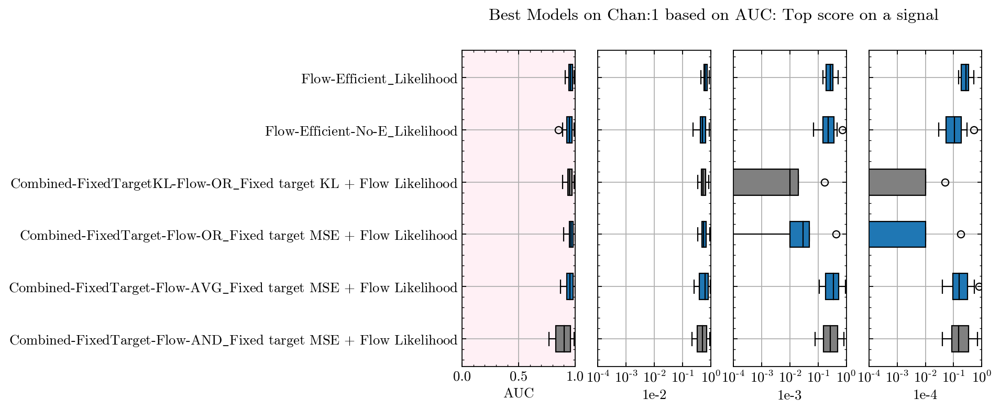

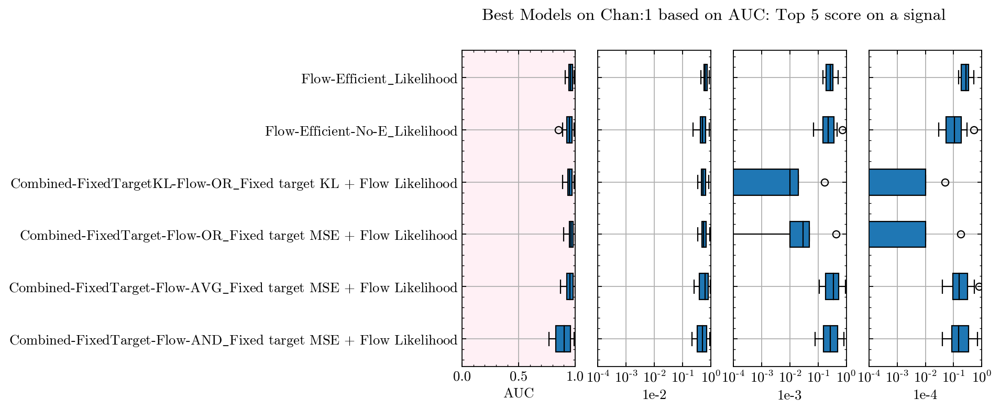

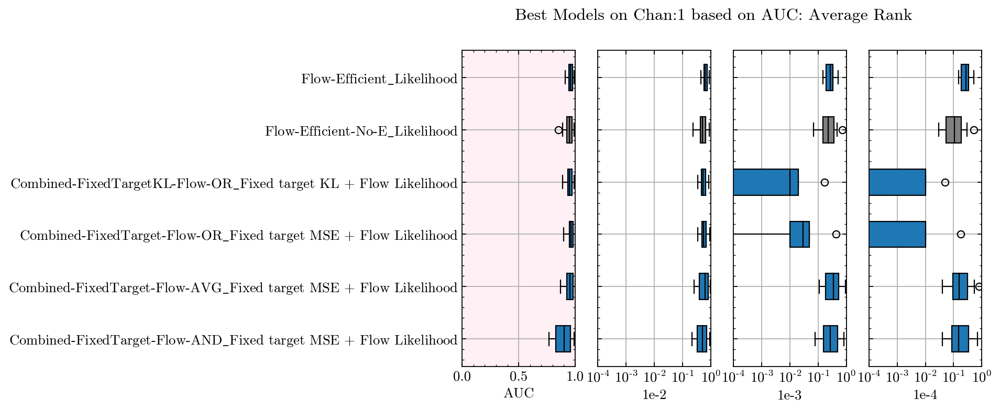

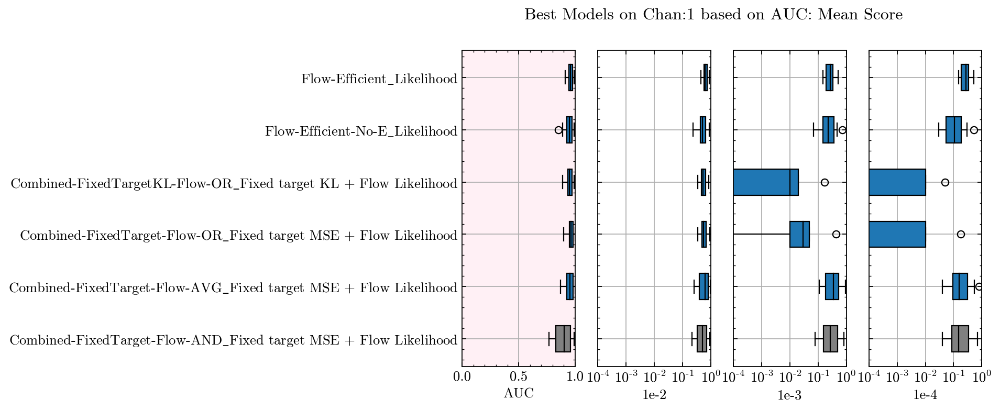

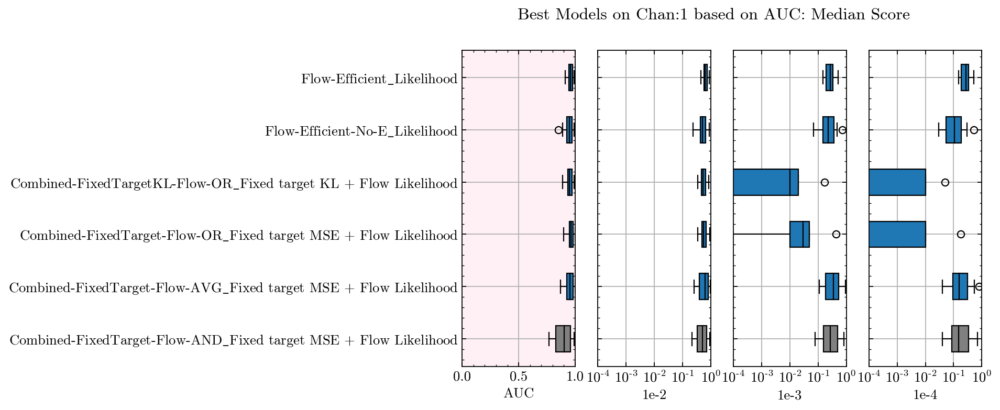

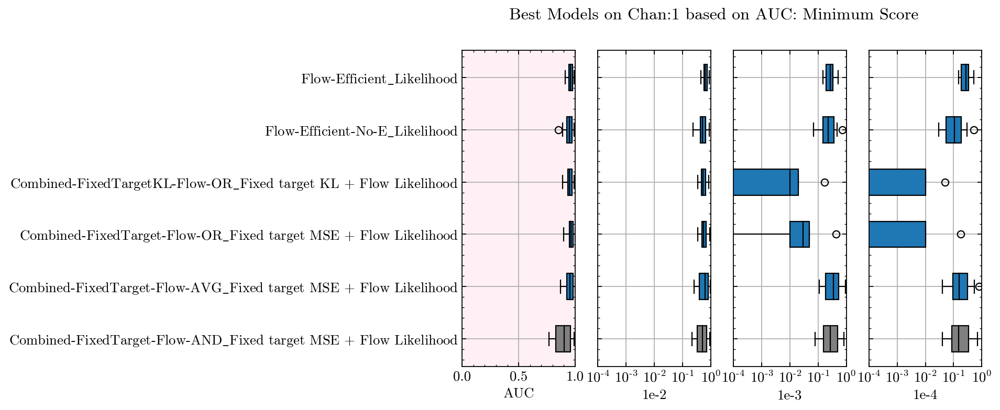

In [51]:
Analyze(AllCombined, 
        Chan='1', 
        Metric='AUC',
        MetricNumberDict = {'top1': 4,
                            'top5': 6,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-2

1 glgl1400_neutralino1100
1 glgl1600_neutralino800
1 monojet_Zp2000.0_DM_50.0
1 monotop_200_A
1 sqsq1_sq1400_neut800
1 sqsq_sq1800_neut800
1 stlp_st1000
1 stop2b1000_neutralino300
****************************************
Models from chan=1 ranked by metric=1e-2 sorted by top1
                                                 Model  top1
476  Combined-FixedTarget-Flow-AVG_Fixed target MSE...     5
471                          Flow-Efficient_Likelihood     2
472                     Flow-Efficient-No-E_Likelihood     1
0                                  LS_IF_13_0.001_1000     0
687             DAGMM_10_1e-06_5000_0.01_0.01_100_15_4     0
****************************************

****************************************
Models from chan=1 ranked by metric=1e-2 sorted by top5
                                                 Model  top5
471                          Flow-Efficient_Likelihood     8
474  Combined-FixedTarget-Flow-OR_Fixed target MSE ...     8
476  Combined-FixedTarget-Flow-AVG_

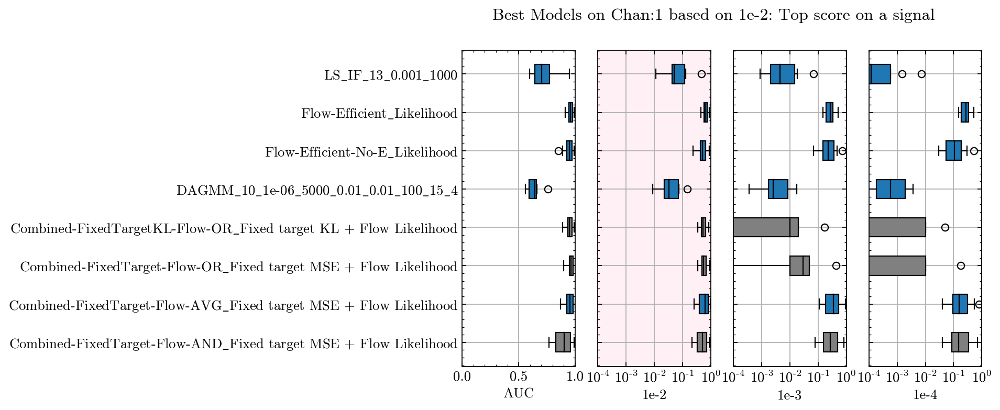

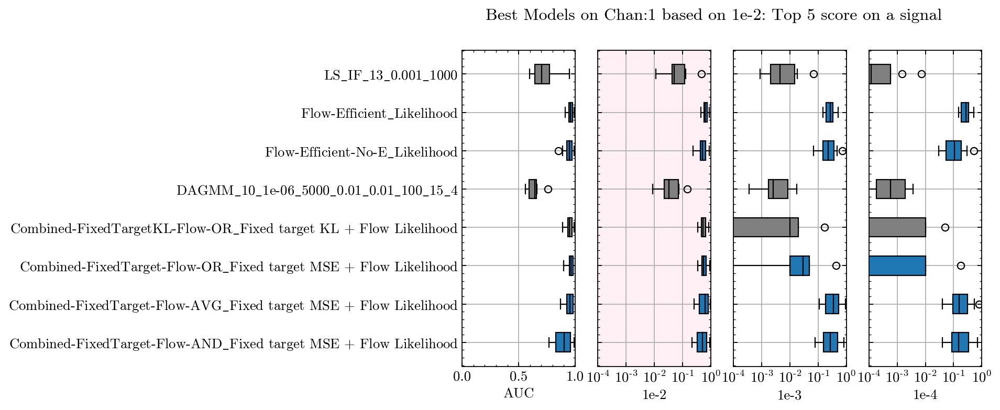

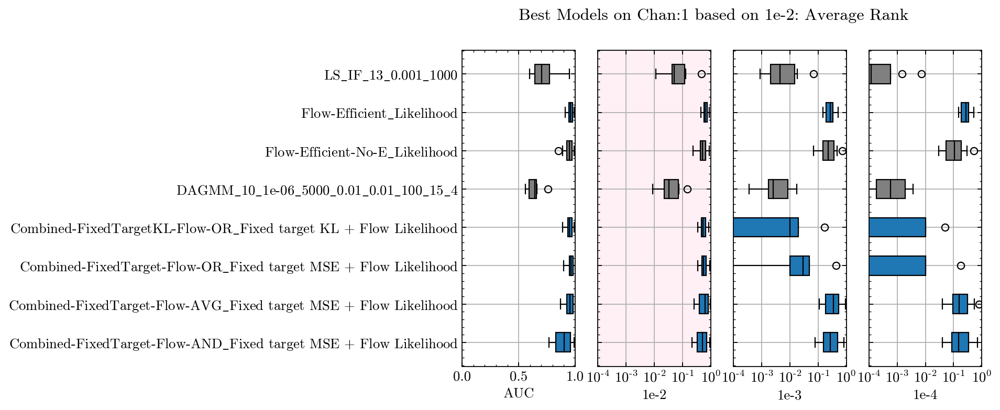

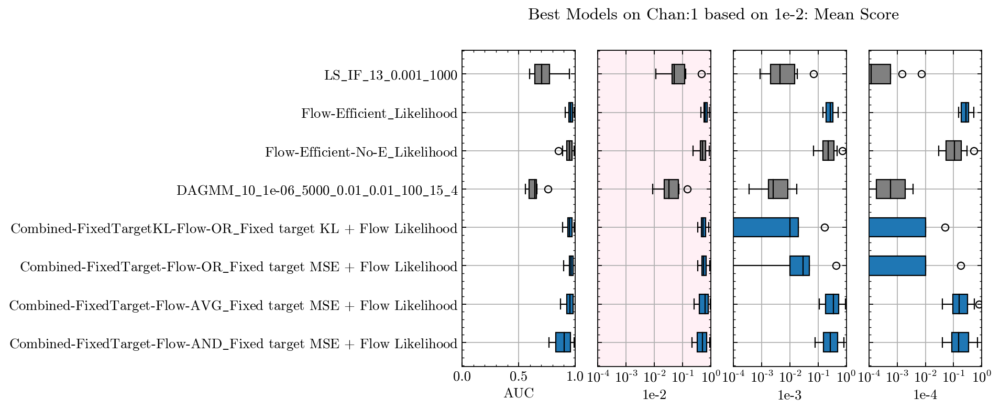

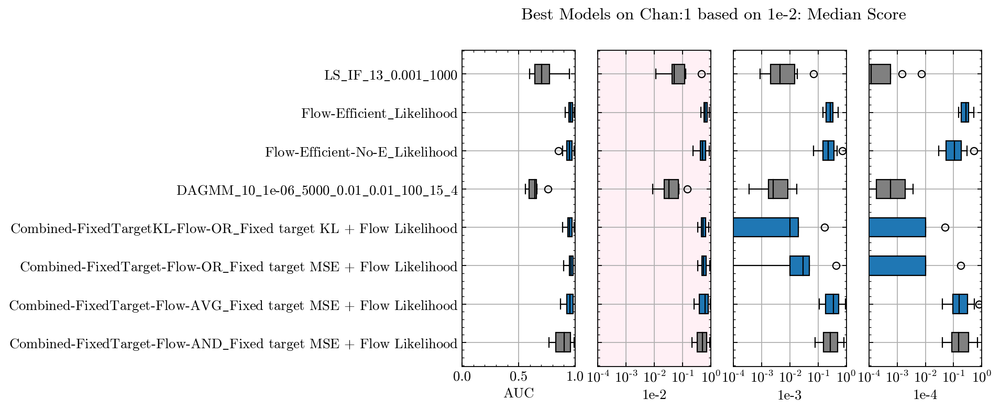

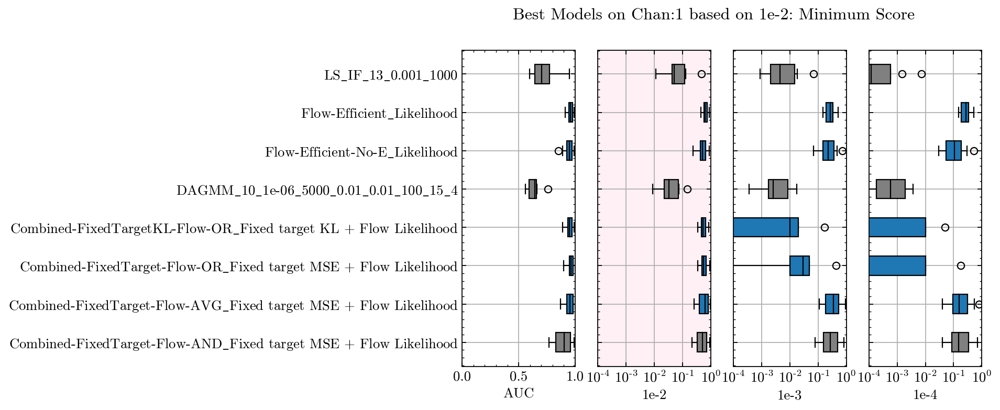

In [52]:
Analyze(AllCombined, 
        Chan='1', 
        Metric='1e-2',
        MetricNumberDict = {'top1': 5,
                            'top5': 5,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-3

1 glgl1400_neutralino1100
1 glgl1600_neutralino800
1 monojet_Zp2000.0_DM_50.0
1 monotop_200_A
1 sqsq1_sq1400_neut800
1 sqsq_sq1800_neut800
1 stlp_st1000
1 stop2b1000_neutralino300
****************************************
Models from chan=1 ranked by metric=1e-3 sorted by top1
                                                 Model  top1
476  Combined-FixedTarget-Flow-AVG_Fixed target MSE...     5
471                          Flow-Efficient_Likelihood     2
472                     Flow-Efficient-No-E_Likelihood     1
0                                  LS_IF_13_0.001_1000     0
687             DAGMM_10_1e-06_5000_0.01_0.01_100_15_4     0
688              DAGMM_20_1e-06_500_0.001_0.01_50_15_4     0
****************************************

****************************************
Models from chan=1 ranked by metric=1e-3 sorted by top5
                                                  Model  top5
473   Combined-FixedTarget-Flow-AND_Fixed target MSE...     8
476   Combined-FixedTarget-Flow-A

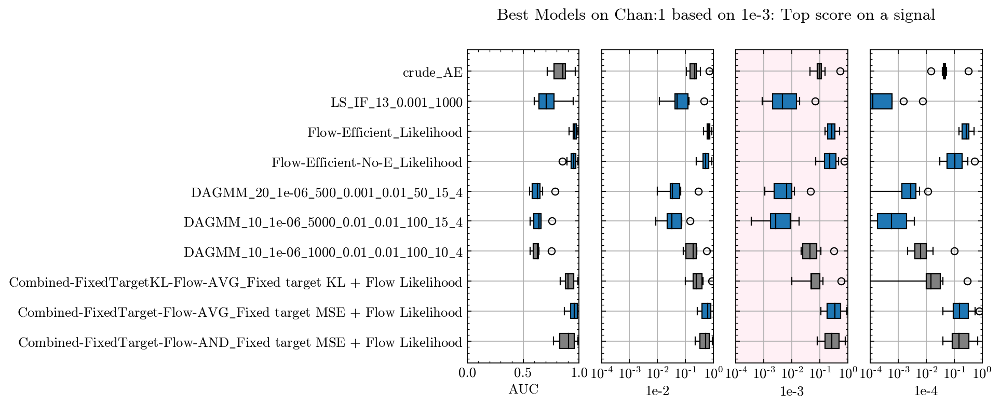

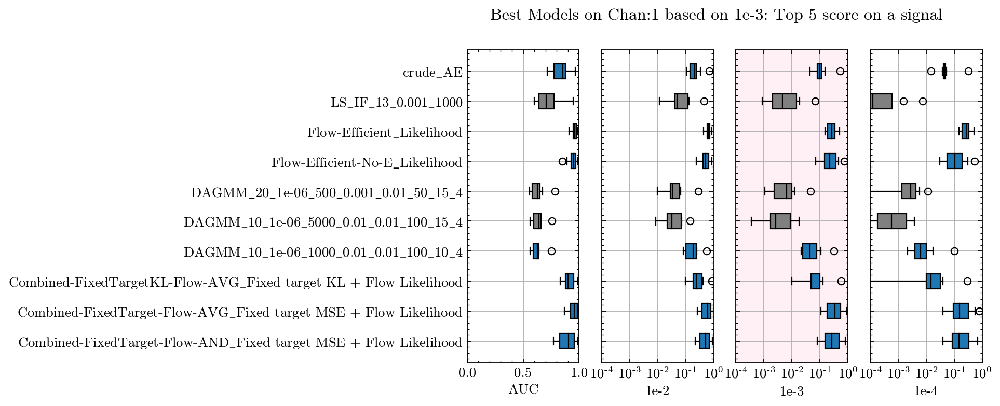

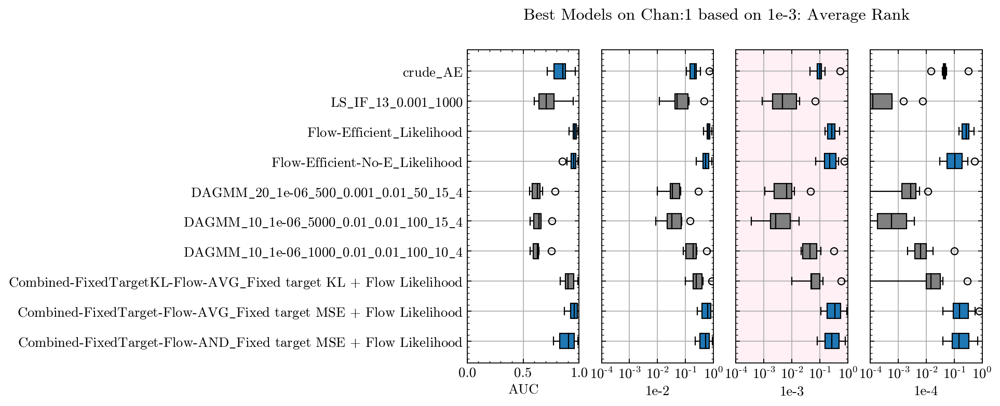

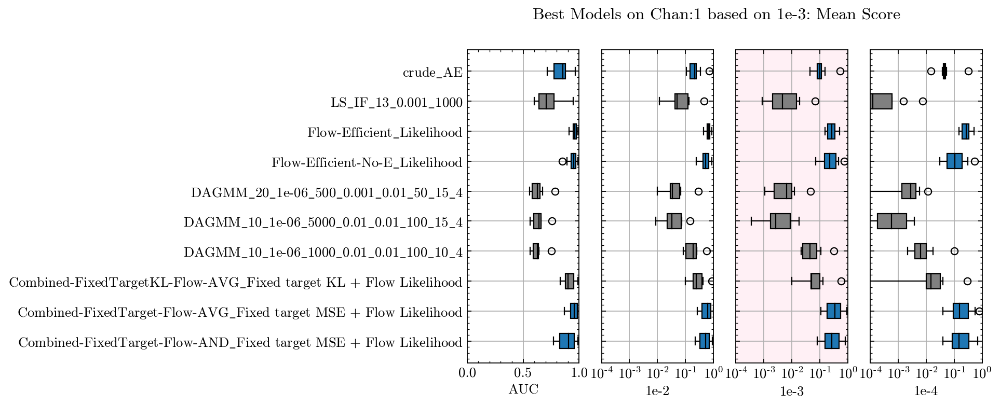

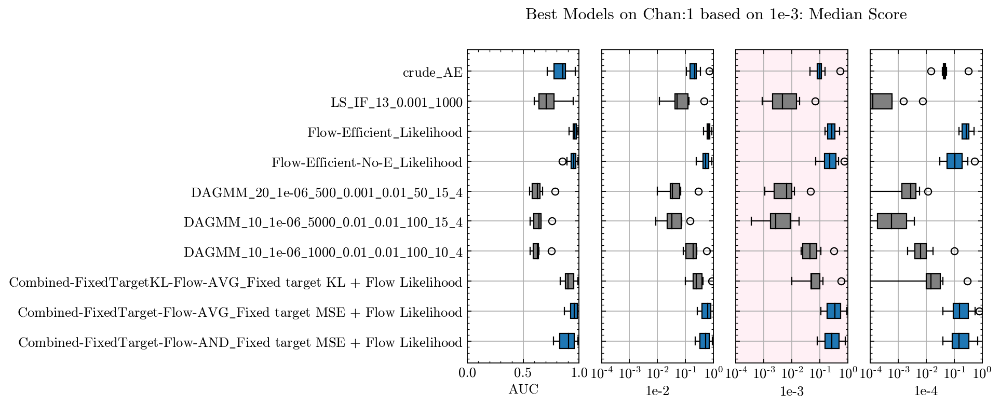

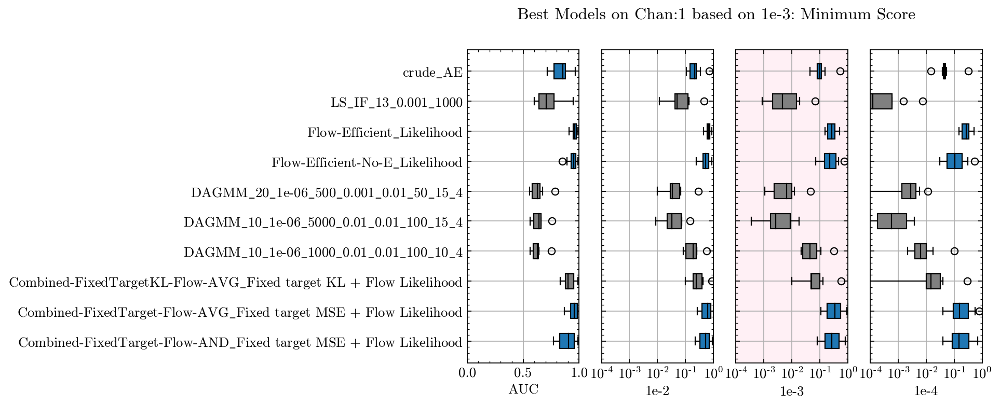

In [53]:
Analyze(AllCombined, 
        Chan='1', 
        Metric='1e-3',
        MetricNumberDict = {'top1': 6,
                            'top5': 7,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-4

1 glgl1400_neutralino1100
1 glgl1600_neutralino800
1 monojet_Zp2000.0_DM_50.0
1 monotop_200_A
1 sqsq1_sq1400_neut800
1 sqsq_sq1800_neut800
1 stlp_st1000
1 stop2b1000_neutralino300
****************************************
Models from chan=1 ranked by metric=1e-4 sorted by top1
                                                 Model  top1
471                          Flow-Efficient_Likelihood     4
476  Combined-FixedTarget-Flow-AVG_Fixed target MSE...     3
472                     Flow-Efficient-No-E_Likelihood     1
0                                  LS_IF_13_0.001_1000     0
****************************************

****************************************
Models from chan=1 ranked by metric=1e-4 sorted by top5
                                                  Model  top5
471                           Flow-Efficient_Likelihood     8
473   Combined-FixedTarget-Flow-AND_Fixed target MSE...     8
476   Combined-FixedTarget-Flow-AVG_Fixed target MSE...     8
472                      Flow-E

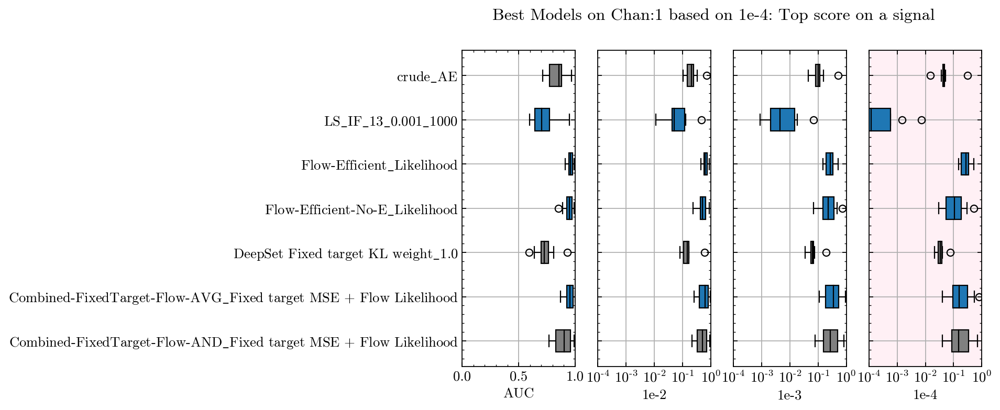

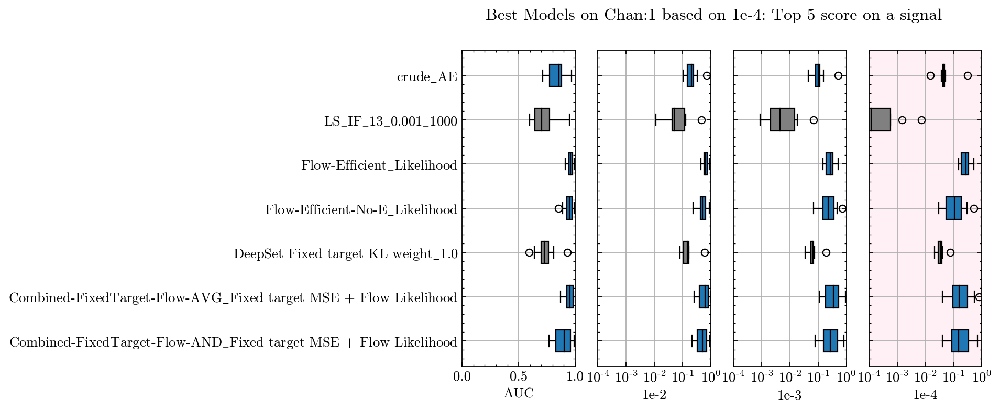

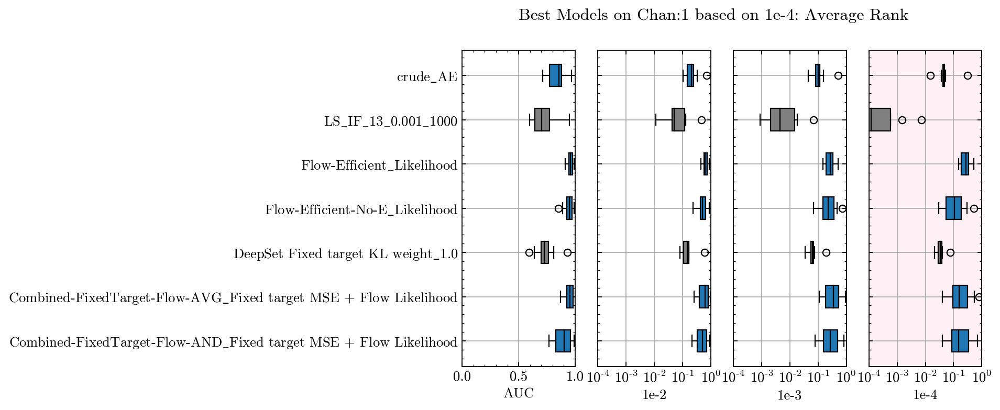

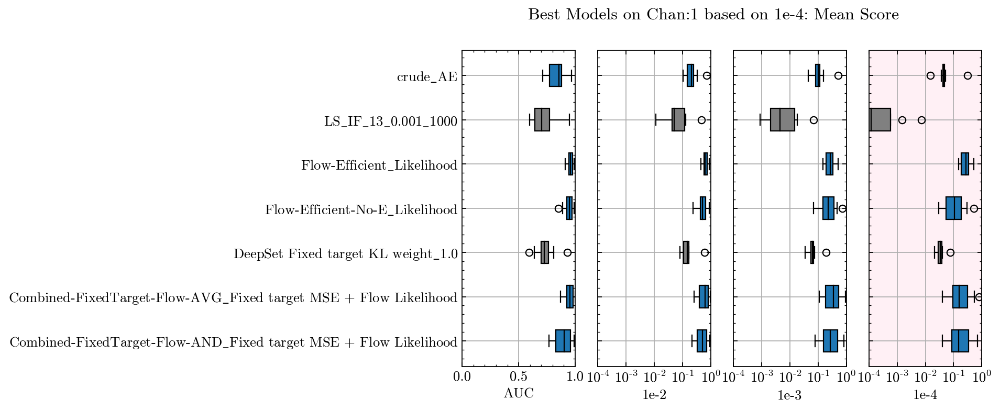

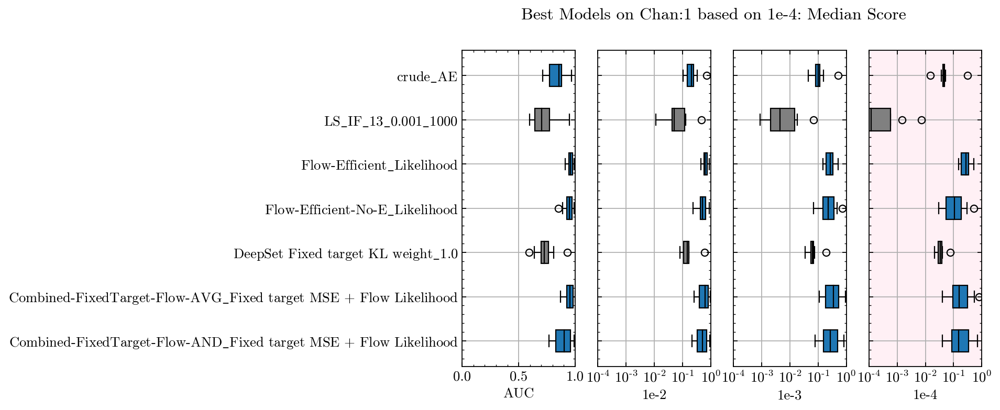

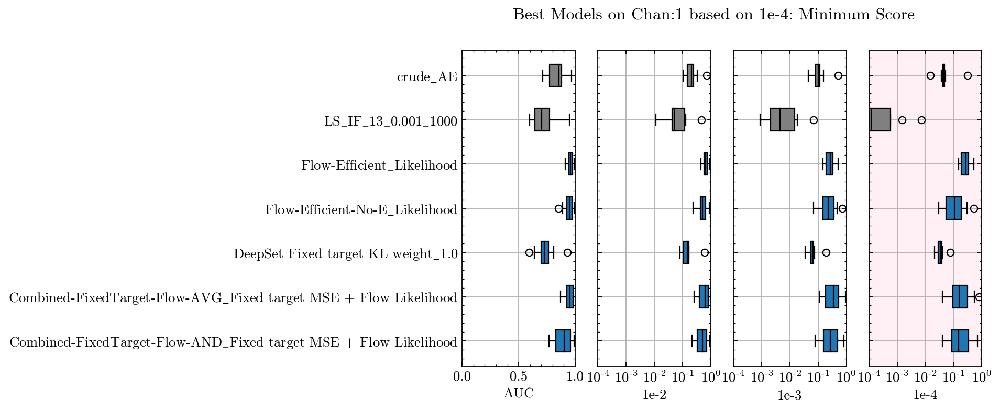

In [54]:
Analyze(AllCombined, 
        Chan='1', 
        Metric='1e-4',
        MetricNumberDict = {'top1': 4,
                            'top5': 5,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

## Chan 2a
### AUC

2a chaneut_cha200_neut50
2a chaneut_cha250_neut150
2a chaneut_cha300_neut100
2a chaneut_cha400_neut200
2a gluino_1000.0_neutralino_1.0
2a pp23mt_50
2a pp24mt_50
****************************************
Models from chan=2a ranked by metric=AUC sorted by top1
                                             Model  top1
472                 Flow-Efficient-No-E_Likelihood     4
584  ALAD_ld20_lr1e-5_bs1000_epoch2000_enc512_F_sc     1
29                               LS_IF_4_1.0_10000     1
391                       VAE-static-beta0.5-z5_RL     1
712        DAGMM_10_1e-07_5000_0.001_0.001_50_10_4     0
****************************************

****************************************
Models from chan=2a ranked by metric=AUC sorted by top5
                              Model  top5
472  Flow-Efficient-No-E_Likelihood     5
471       Flow-Efficient_Likelihood     3
391        VAE-static-beta0.5-z5_RL     2
****************************************

****************************************
Models fro

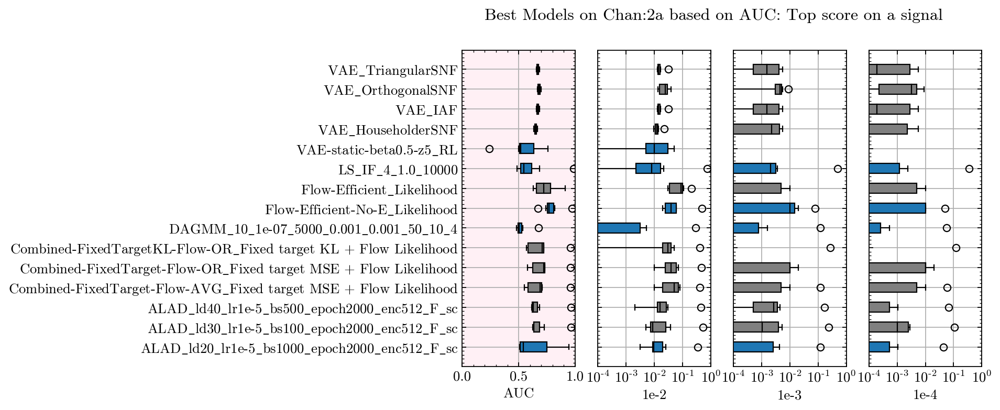

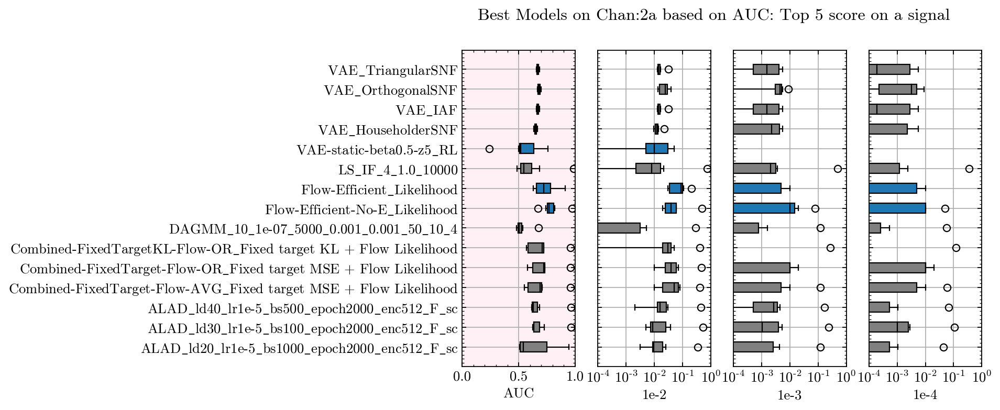

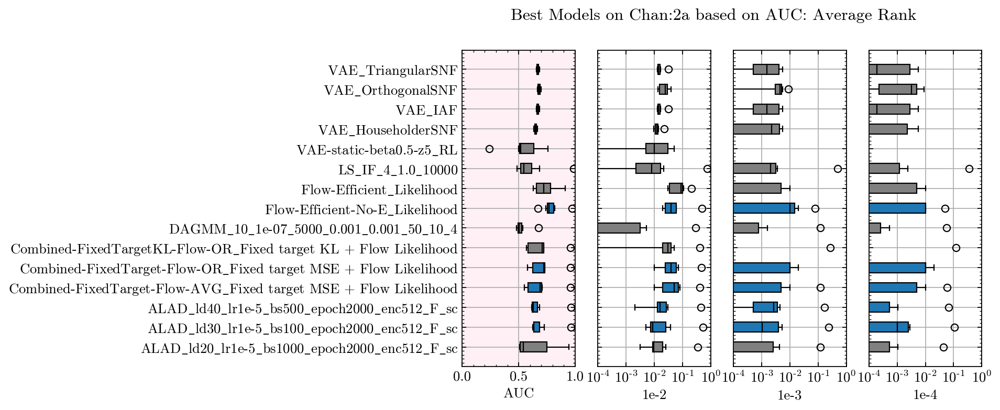

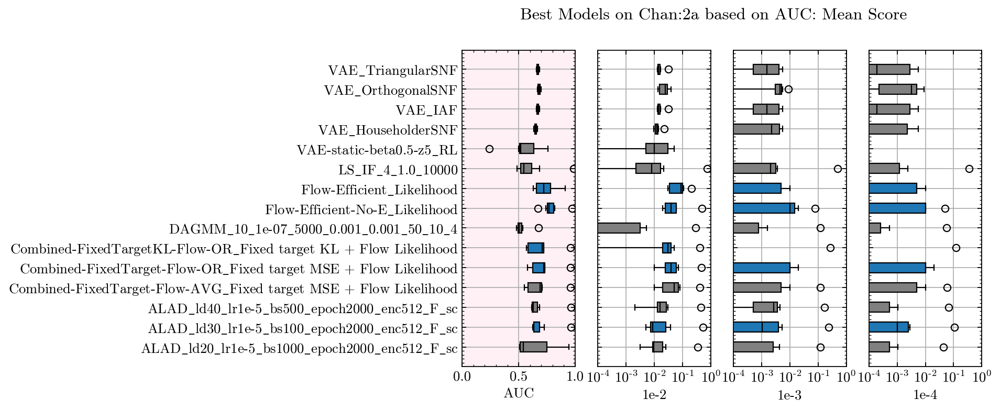

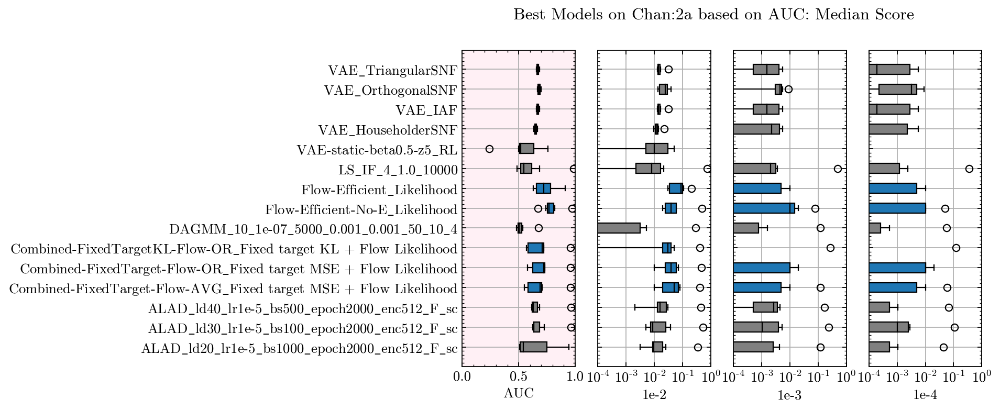

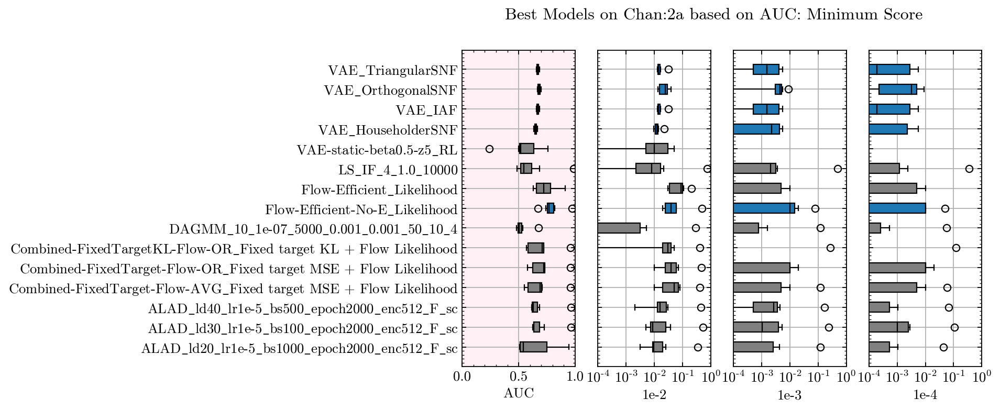

In [55]:
Analyze(AllCombined, 
        Chan='2a', 
        Metric='AUC',
        MetricNumberDict = {'top1': 5,
                            'top5': 3,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-2

2a chaneut_cha200_neut50
2a chaneut_cha250_neut150
2a chaneut_cha300_neut100
2a chaneut_cha400_neut200
2a gluino_1000.0_neutralino_1.0
2a pp23mt_50
2a pp24mt_50
****************************************
Models from chan=2a ranked by metric=1e-2 sorted by top1
                                           Model  top1
391                     VAE-static-beta0.5-z5_RL     1
395                     VAE-static-beta0.5-z8_RL     1
407                    VAE-static-beta0.5-z34_RL     1
471                    Flow-Efficient_Likelihood     1
28                              LS_IF_4_1.0_1000     1
496                           Fixed-MSE0-z89_MSE     1
605  ALAD_ld30_lr1e-5_bs100_epoch2000_enc512_L_1     1
****************************************

****************************************
Models from chan=2a ranked by metric=1e-2 sorted by top5
                         Model  top5
471  Flow-Efficient_Likelihood     3
407  VAE-static-beta0.5-z34_RL     2
134       LS_VAE_13_1e-05_1000     1
*************

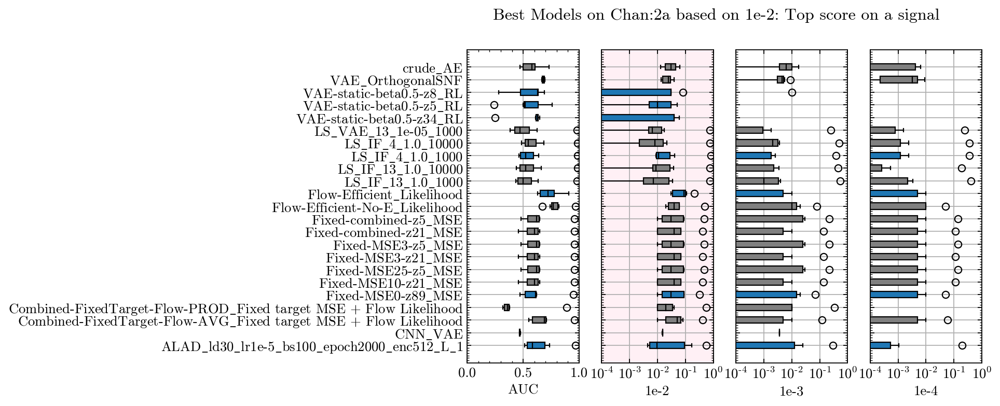

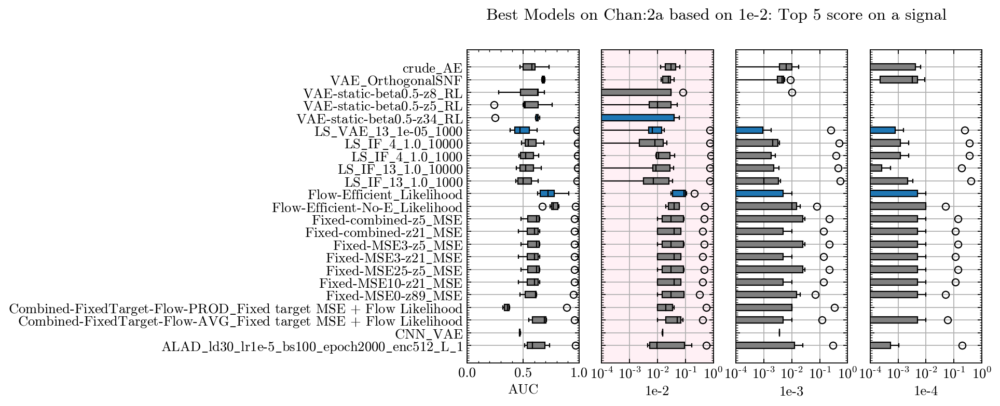

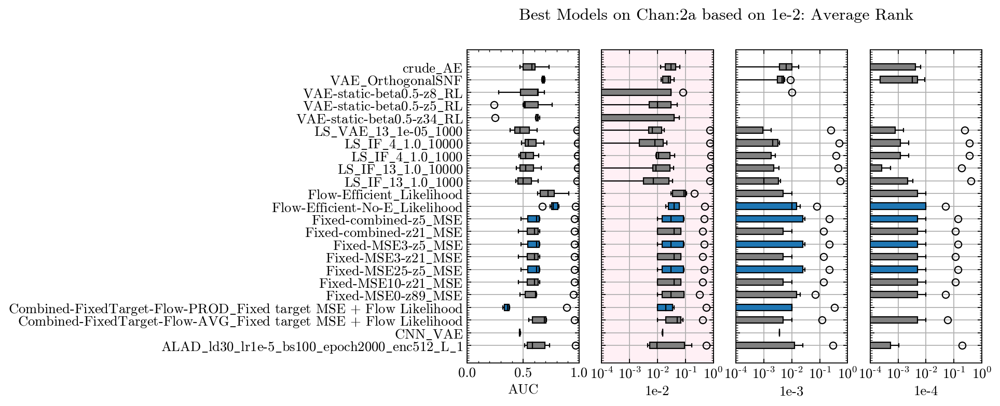

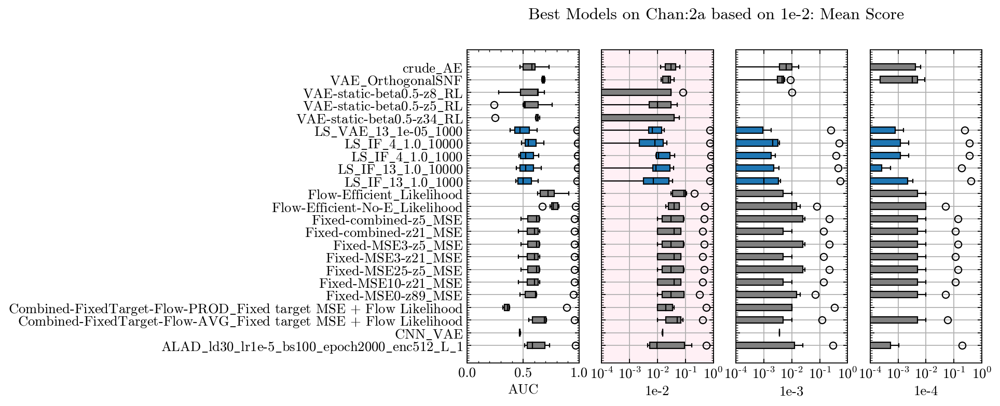

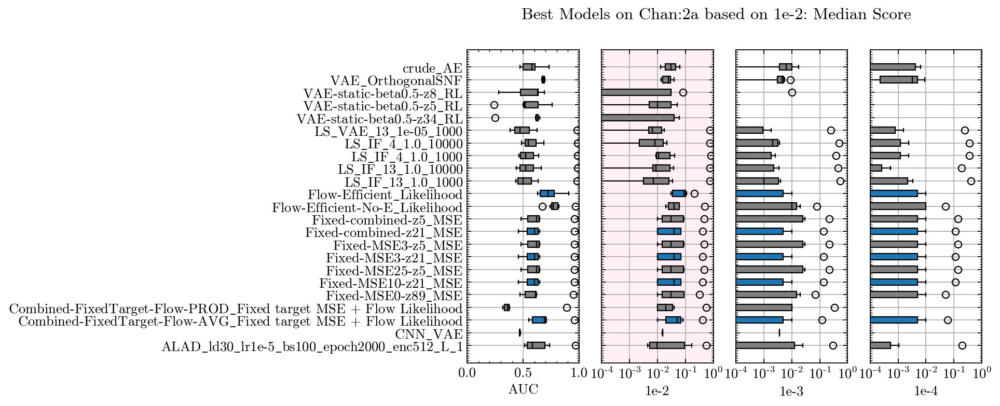

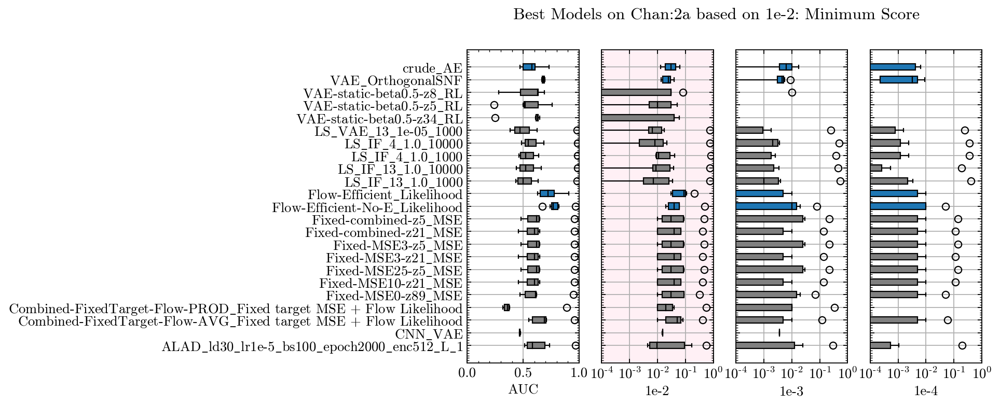

In [56]:
Analyze(AllCombined, 
        Chan='2a', 
        Metric='1e-2',
        MetricNumberDict = {'top1': 7,
                            'top5': 3,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-3

2a chaneut_cha200_neut50
2a chaneut_cha250_neut150
2a chaneut_cha300_neut100
2a chaneut_cha400_neut200
2a gluino_1000.0_neutralino_1.0
2a pp23mt_50
2a pp24mt_50
****************************************
Models from chan=2a ranked by metric=1e-3 sorted by top1
                            Model  top1
345  VAE-dynamic-beta1e-06-z21_RL     1
526             Fixed-MSE4-z5_MSE     1
4               LS_IF_13_1.0_1000     1
324        Density_VAE_b=1e-1_D=4     1
387     VAE-static-beta0.1-z34_RL     1
298               Density_PCA_D=5     1
530            Fixed-MSE4-z34_MSE     1
****************************************

****************************************
Models from chan=2a ranked by metric=1e-3 sorted by top5
                                           Model  top5
544                           Fixed-MSE25-z5_MSE     2
490                            Fixed-MSE0-z5_MSE     2
605  ALAD_ld30_lr1e-5_bs100_epoch2000_enc512_L_1     1
298                              Density_PCA_D=5     1
323   

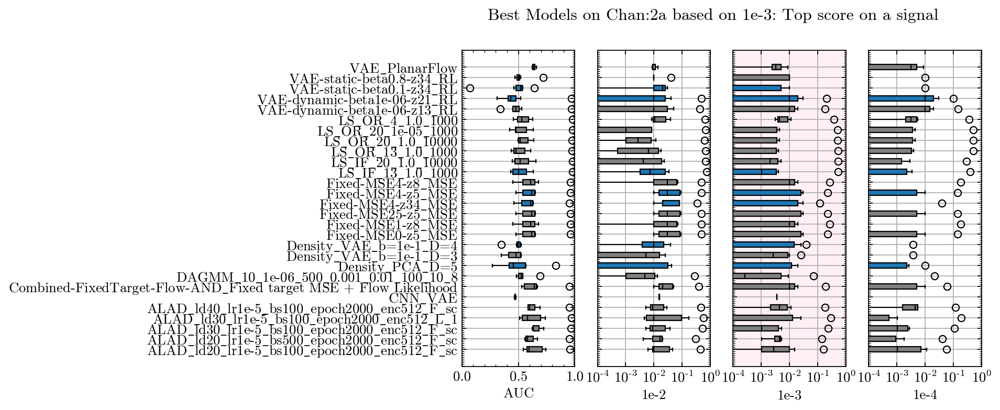

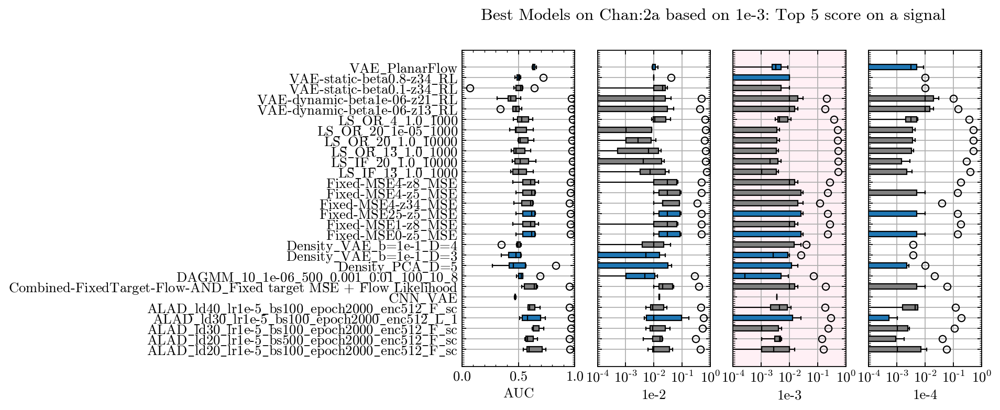

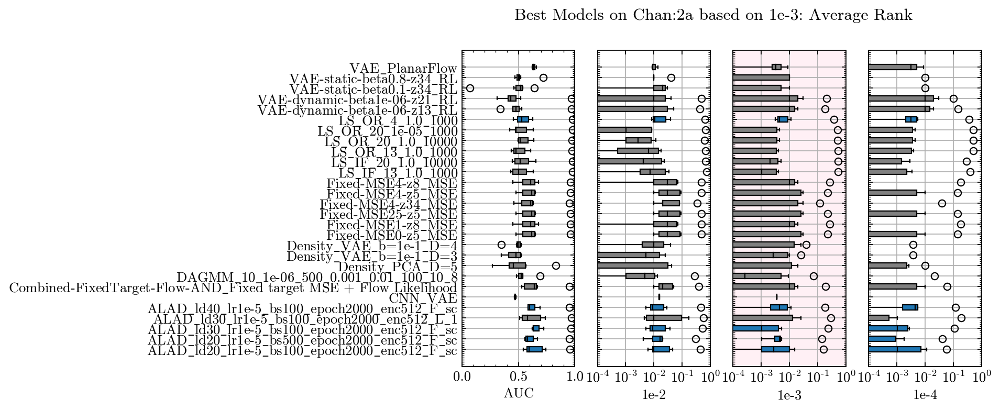

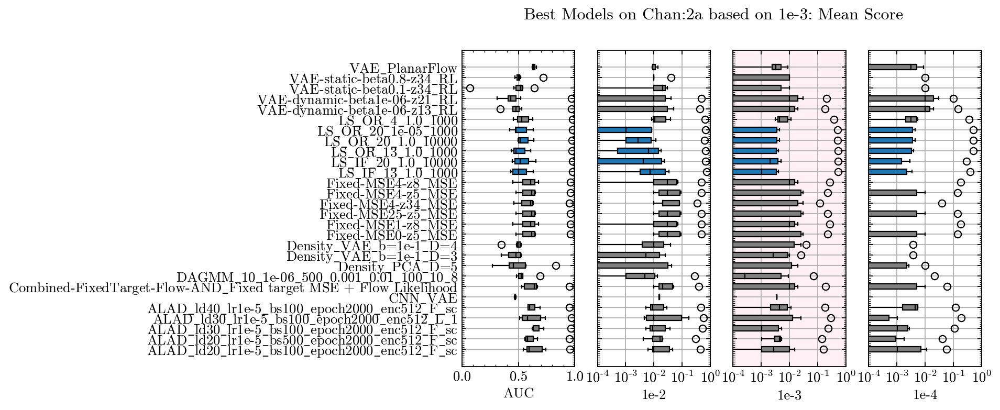

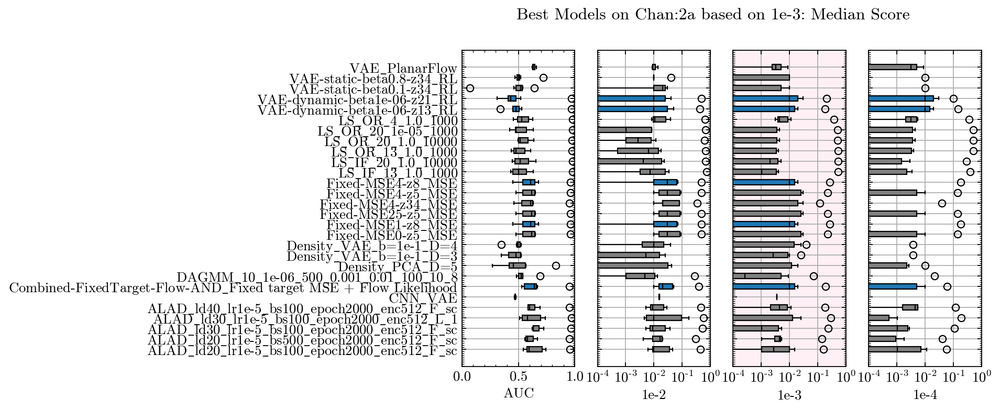

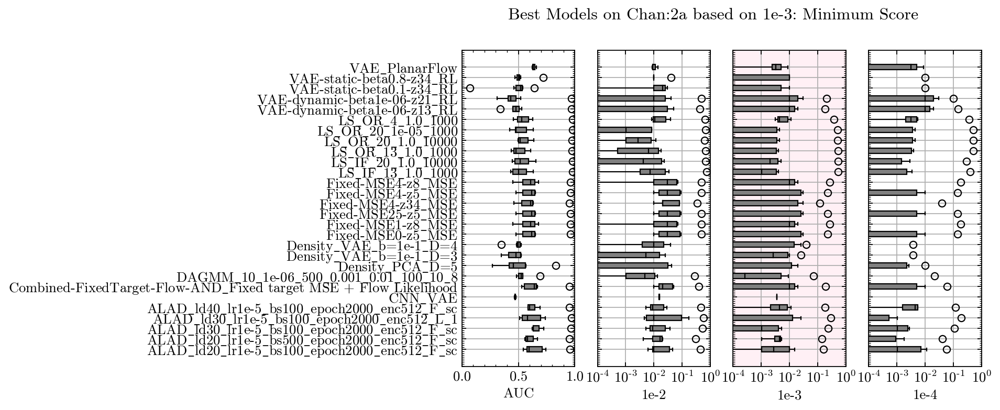

In [57]:
Analyze(AllCombined, 
        Chan='2a', 
        Metric='1e-3',
        MetricNumberDict = {'top1': 7,
                            'top5': 8,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 1},
        Plot=True
       )

### 1e-4

2a chaneut_cha200_neut50
2a chaneut_cha250_neut150
2a chaneut_cha300_neut100
2a chaneut_cha400_neut200
2a gluino_1000.0_neutralino_1.0
2a pp23mt_50
2a pp24mt_50
****************************************
Models from chan=2a ranked by metric=1e-4 sorted by top1
                                     Model  top1
345           VAE-dynamic-beta1e-06-z21_RL     2
164                      LS_OR_13_1.0_1000     1
387              VAE-static-beta0.1-z34_RL     1
288                                VAE_NoF     1
472         Flow-Efficient-No-E_Likelihood     1
519                     Fixed-MSE3-z13_MSE     1
688  DAGMM_20_1e-07_5000_0.01_0.01_50_10_8     0
****************************************

****************************************
Models from chan=2a ranked by metric=1e-4 sorted by top5
                              Model  top5
341    VAE-dynamic-beta1e-06-z13_RL     3
345    VAE-dynamic-beta1e-06-z21_RL     3
291               VAE_OrthogonalSNF     2
289                  VAE_PlanarFlow     2

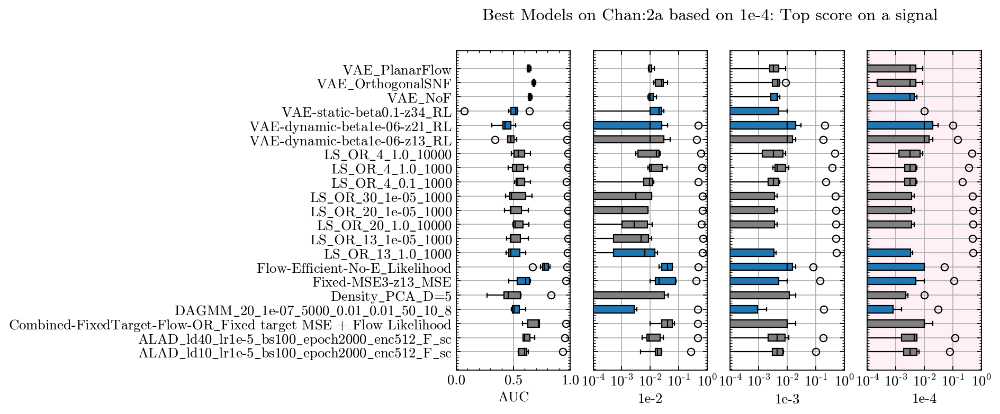

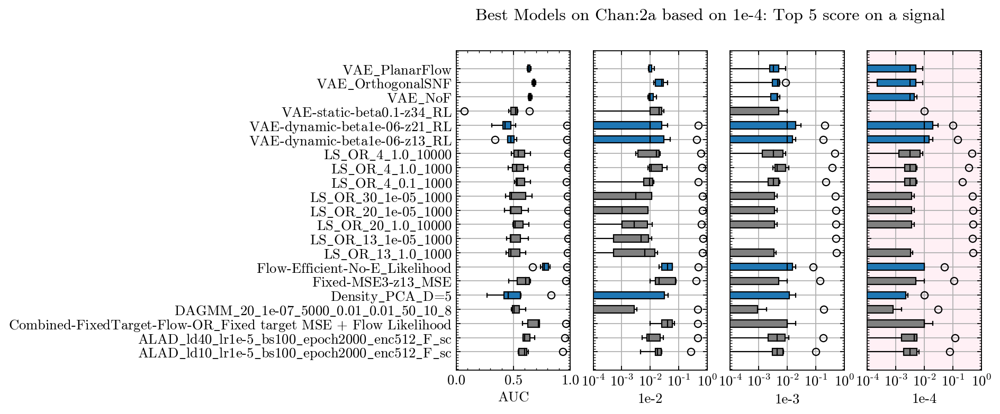

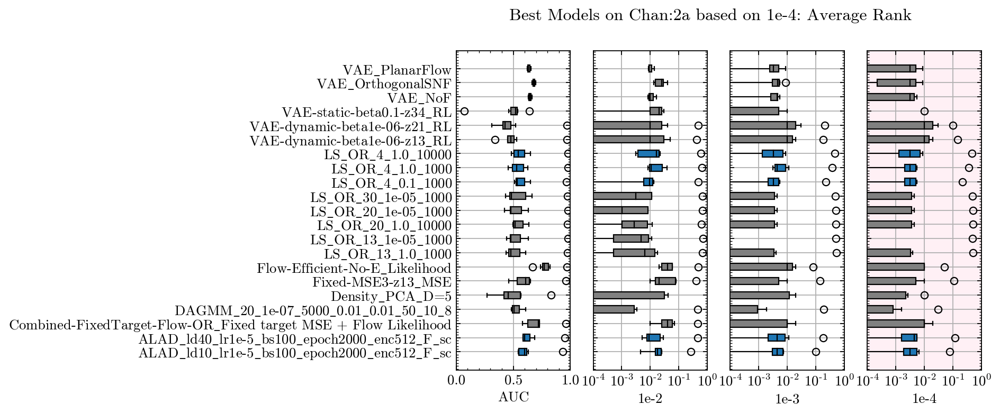

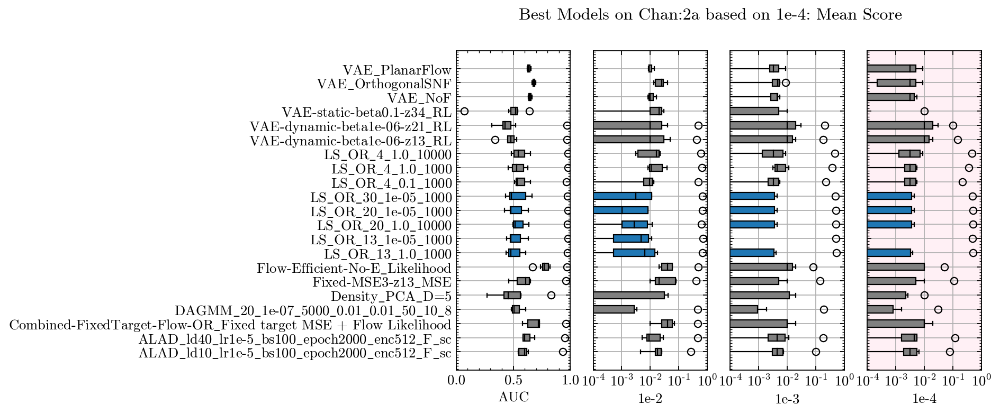

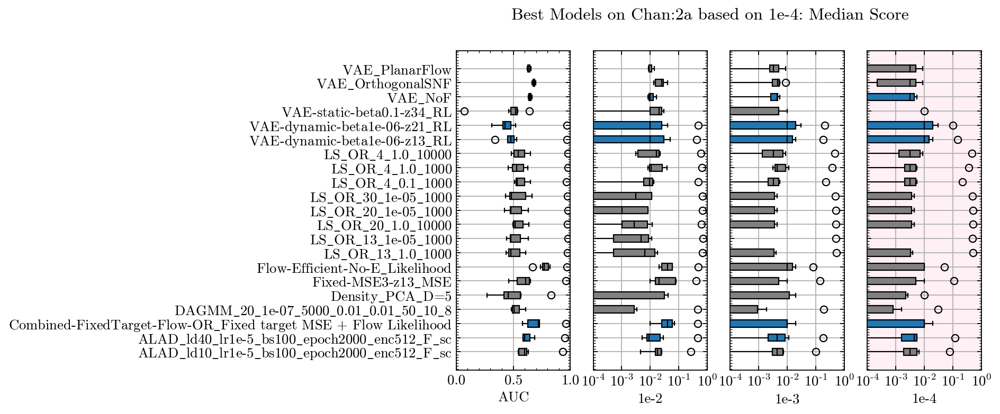

In [58]:
Analyze(AllCombined, 
        Chan='2a', 
        Metric='1e-4',
        MetricNumberDict = {'top1': 7,
                            'top5': 7,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 0},
        Plot=True
       )

## Chan 2b
### AUC

2b chacha_cha300_neut140
2b chacha_cha400_neut60
2b chacha_cha600_neut200
2b chaneut_cha200_neut50
2b chaneut_cha250_neut150
2b gluino_1000.0_neutralino_1.0
2b pp23mt_50
2b pp24mt_50
2b stlp_st1000
****************************************
Models from chan=2b ranked by metric=AUC sorted by top1
                                                 Model  top1
471                          Flow-Efficient_Likelihood     5
474  Combined-FixedTarget-Flow-OR_Fixed target MSE ...     2
478  Combined-FixedTargetKL-Flow-OR_Fixed target KL...     1
480  Combined-FixedTargetKL-Flow-AVG_Fixed target K...     1
689             DAGMM_20_1e-06_5000_0.01_0.001_50_15_4     0
****************************************

****************************************
Models from chan=2b ranked by metric=AUC sorted by top5
                                                 Model  top5
474  Combined-FixedTarget-Flow-OR_Fixed target MSE ...     8
476  Combined-FixedTarget-Flow-AVG_Fixed target MSE...     8
478  Combined-Fix

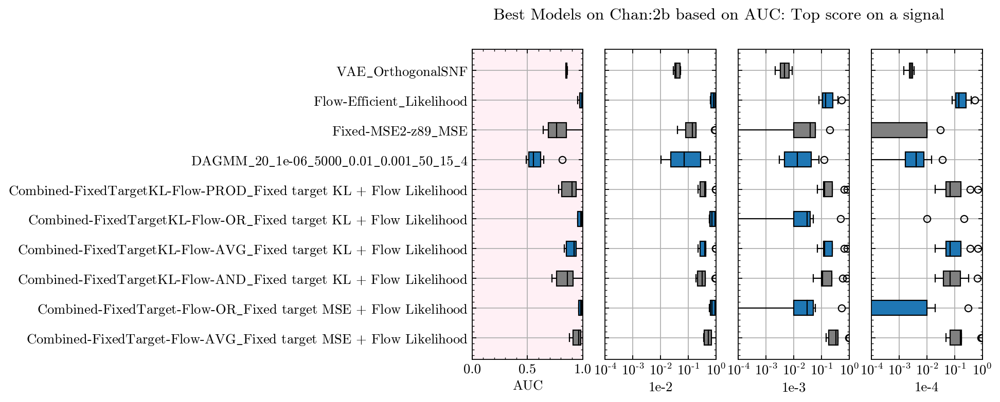

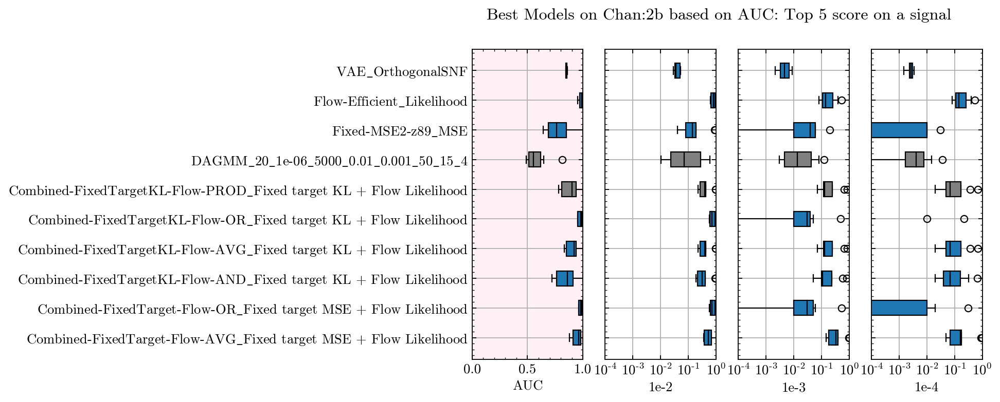

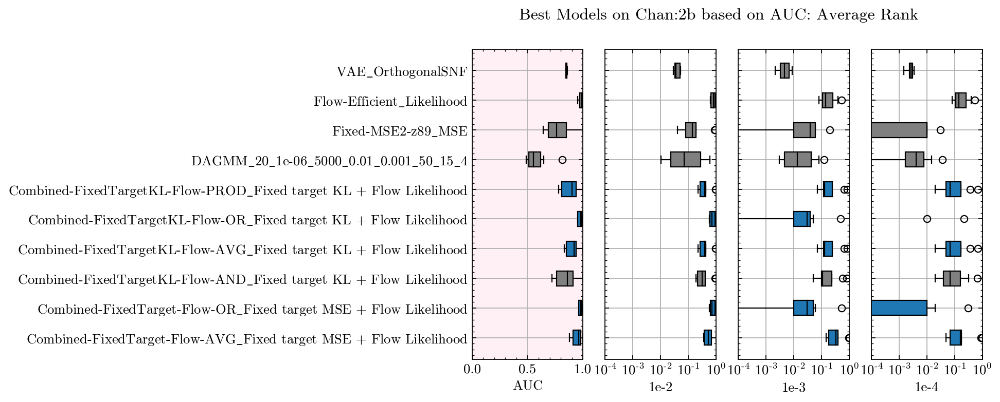

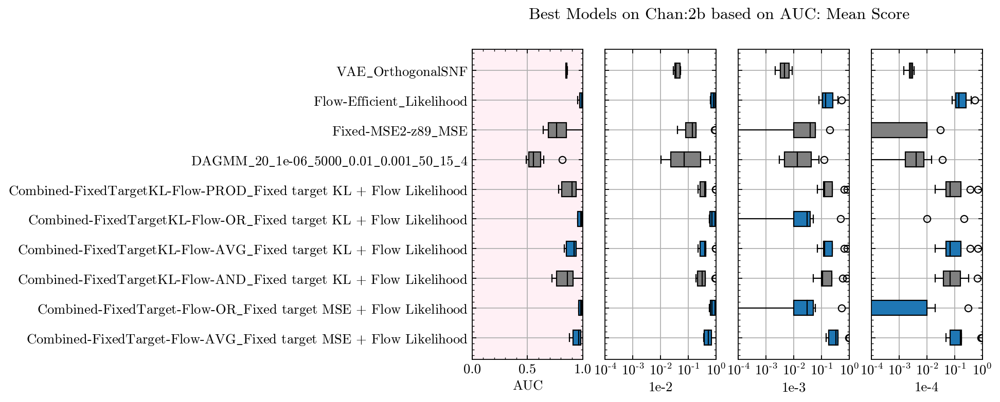

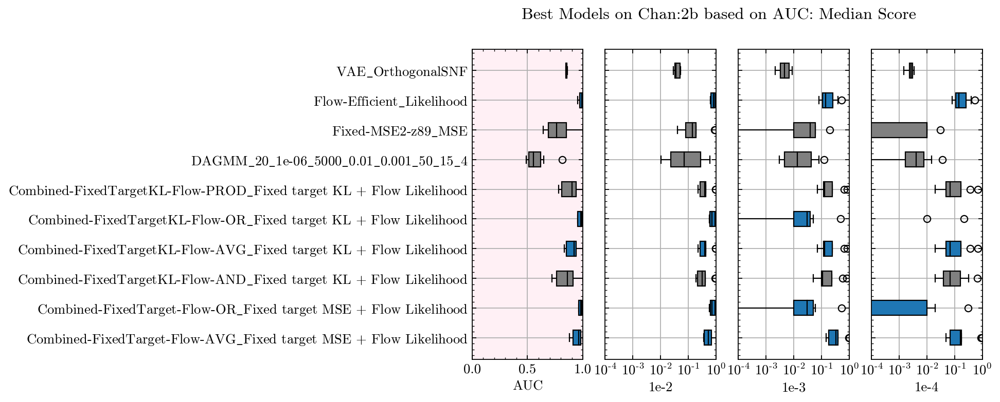

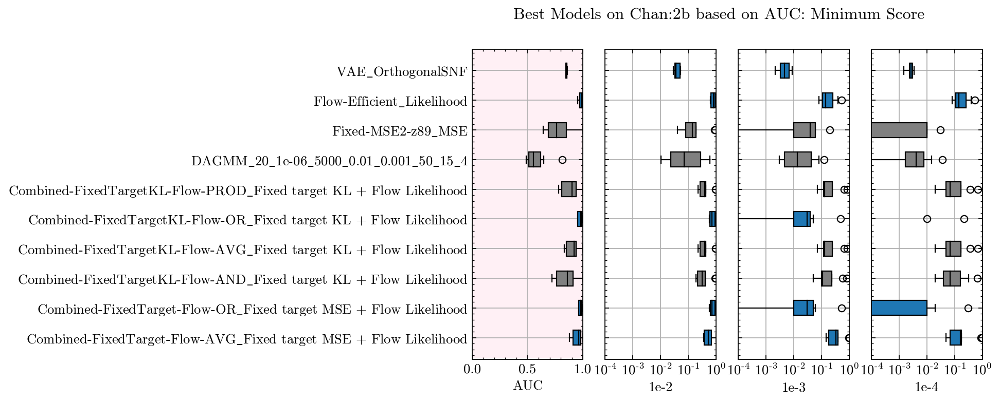

In [59]:
Analyze(AllCombined, 
        Chan='2b', 
        Metric='AUC',
        MetricNumberDict = {'top1': 5,
                            'top5': 8,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-2

2b chacha_cha300_neut140
2b chacha_cha400_neut60
2b chacha_cha600_neut200
2b chaneut_cha200_neut50
2b chaneut_cha250_neut150
2b gluino_1000.0_neutralino_1.0
2b pp23mt_50
2b pp24mt_50
2b stlp_st1000
****************************************
Models from chan=2b ranked by metric=1e-2 sorted by top1
                                                 Model  top1
475  Combined-FixedTarget-Flow-PROD_Fixed target MS...     7
476  Combined-FixedTarget-Flow-AVG_Fixed target MSE...     2
0                                  LS_IF_13_0.001_1000     0
697            DAGMM_10_1e-07_5000_0.001_0.01_100_10_8     0
685               DAGMM_20_1e-07_500_0.01_0.01_50_15_8     0
****************************************

****************************************
Models from chan=2b ranked by metric=1e-2 sorted by top5
                                                 Model  top5
475  Combined-FixedTarget-Flow-PROD_Fixed target MS...     9
478  Combined-FixedTargetKL-Flow-OR_Fixed target KL...     8
474  Combined-F

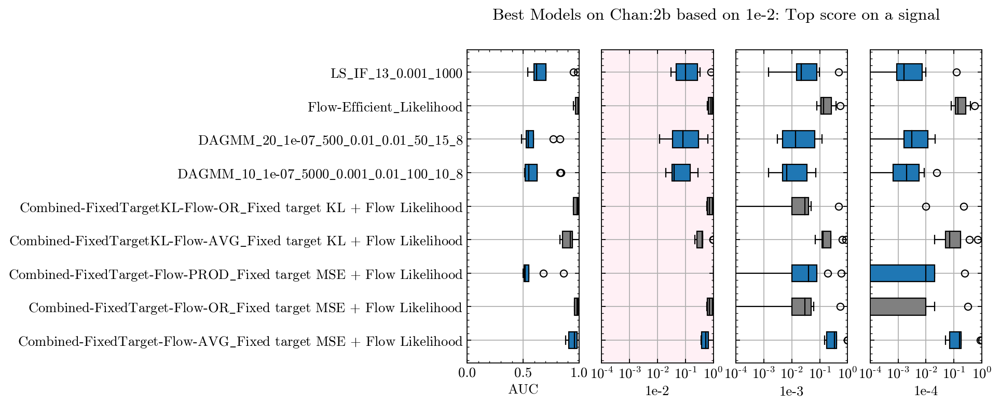

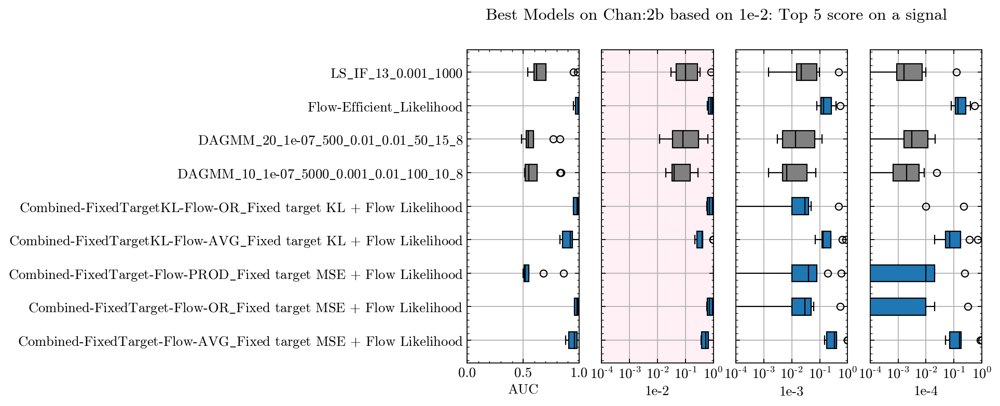

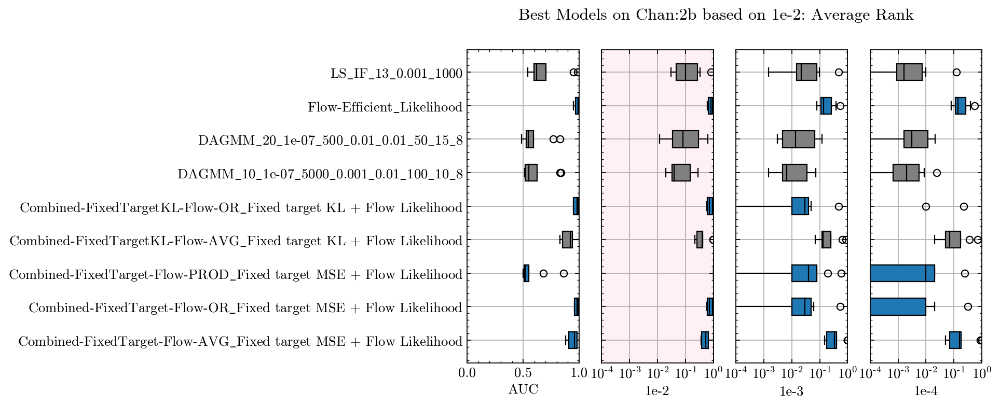

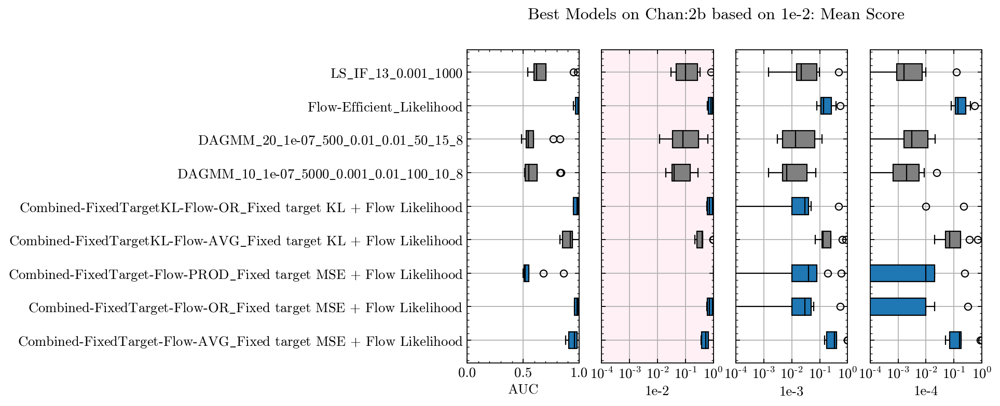

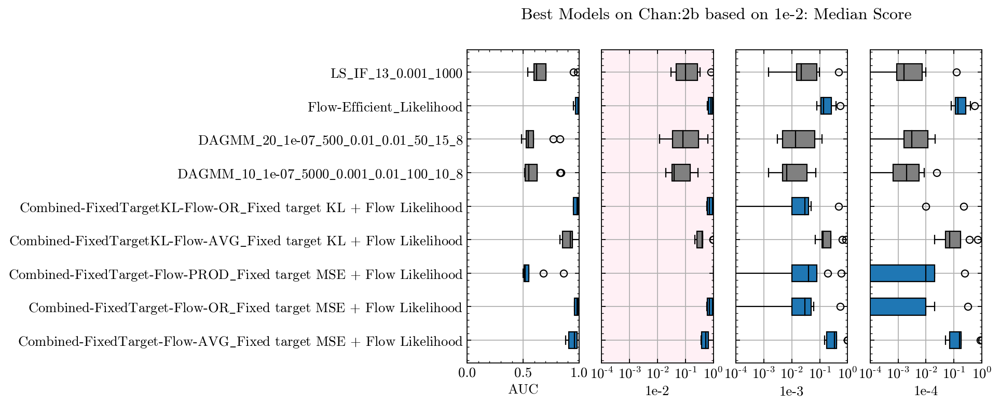

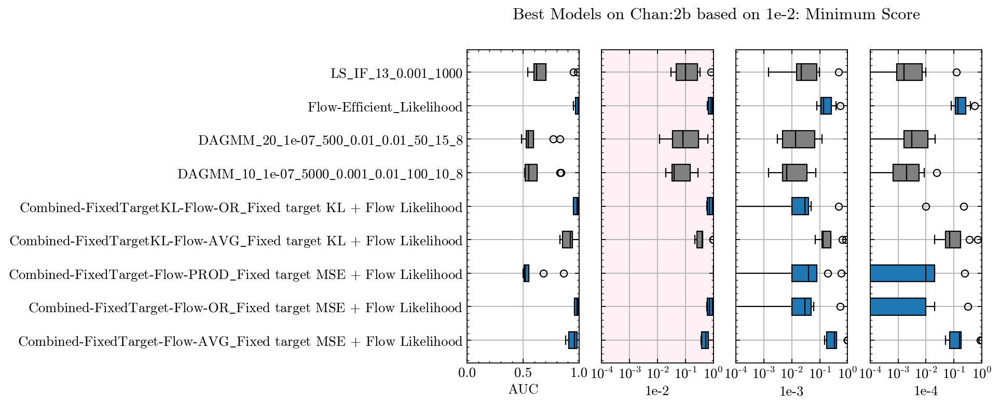

In [60]:
Analyze(AllCombined, 
        Chan='2b', 
        Metric='1e-2',
        MetricNumberDict = {'top1': 5,
                            'top5': 6,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-3

2b chacha_cha300_neut140
2b chacha_cha400_neut60
2b chacha_cha600_neut200
2b chaneut_cha200_neut50
2b chaneut_cha250_neut150
2b gluino_1000.0_neutralino_1.0
2b pp23mt_50
2b pp24mt_50
2b stlp_st1000
****************************************
Models from chan=2b ranked by metric=1e-3 sorted by top1
                                                 Model  top1
476  Combined-FixedTarget-Flow-AVG_Fixed target MSE...     5
471                          Flow-Efficient_Likelihood     2
341                       VAE-dynamic-beta1e-06-z13_RL     2
693             DAGMM_20_1e-06_1000_0.001_0.01_50_10_4     0
697            DAGMM_10_1e-07_5000_0.001_0.01_100_10_8     0
****************************************

****************************************
Models from chan=2b ranked by metric=1e-3 sorted by top5
                                                 Model  top5
476  Combined-FixedTarget-Flow-AVG_Fixed target MSE...     8
479  Combined-FixedTargetKL-Flow-PROD_Fixed target ...     7
480  Combined-F

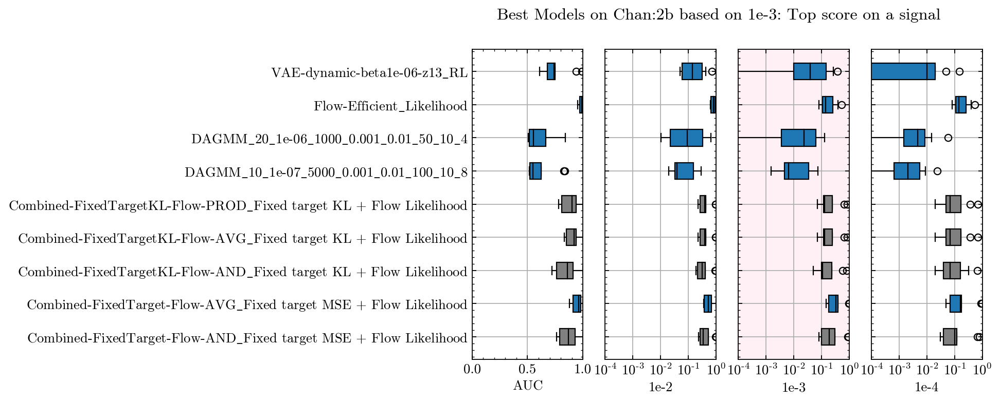

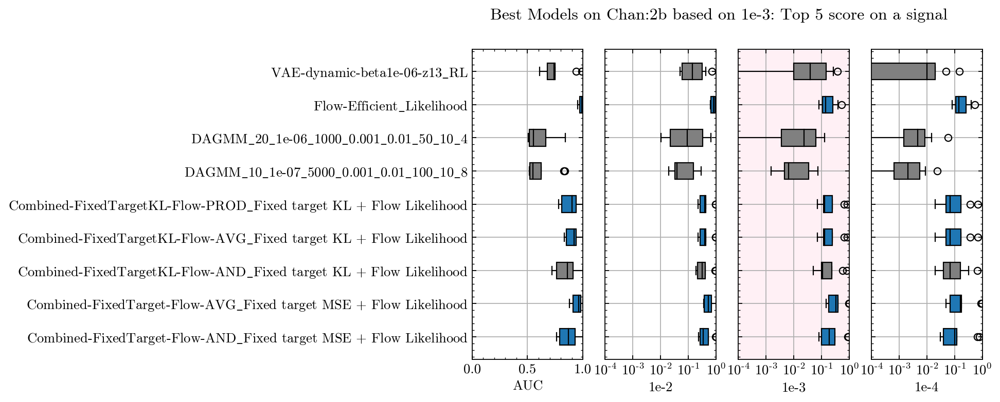

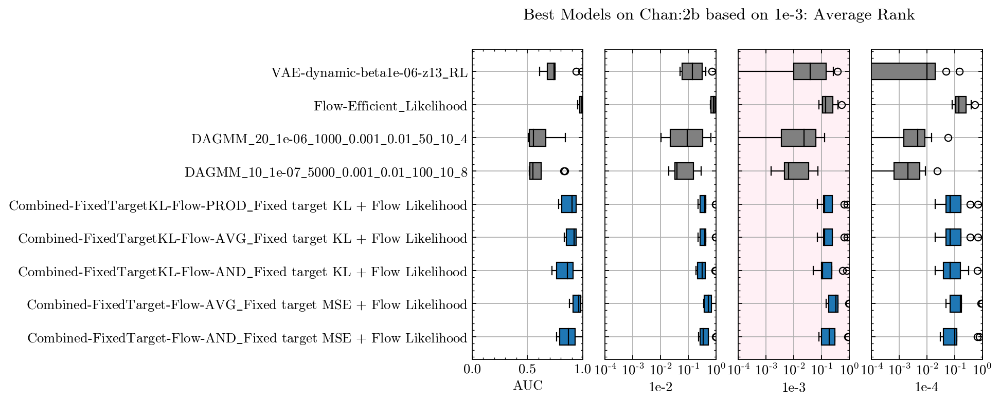

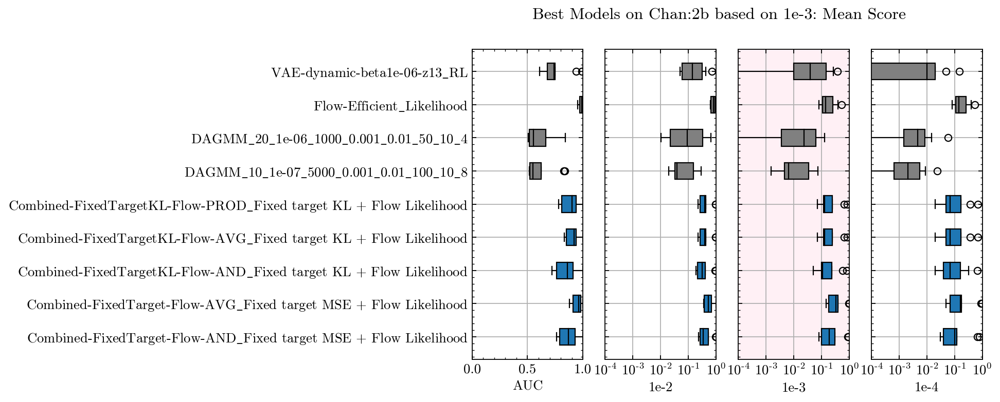

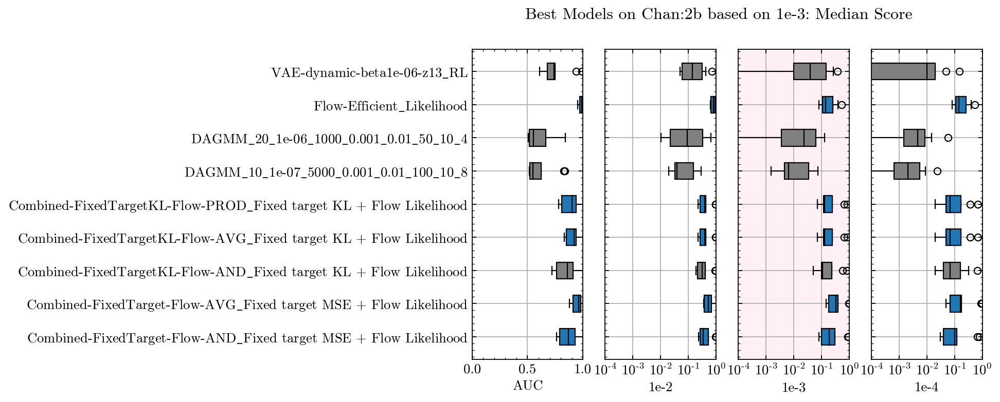

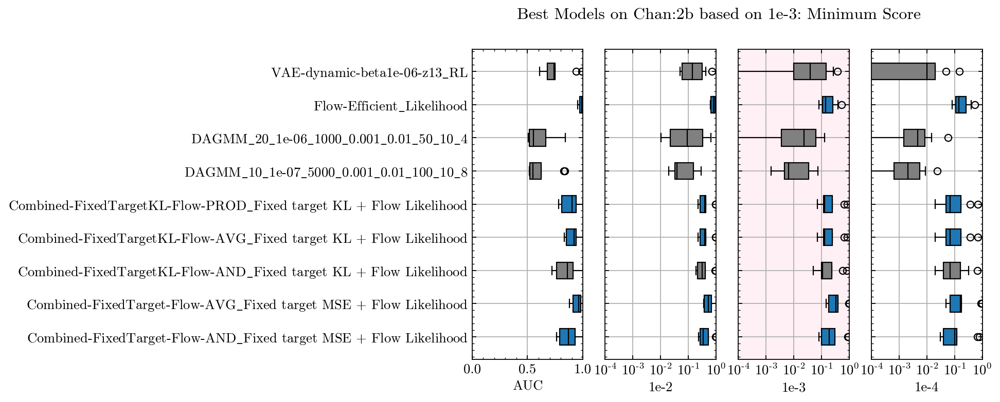

In [61]:
Analyze(AllCombined, 
        Chan='2b', 
        Metric='1e-3',
        MetricNumberDict = {'top1': 5,
                            'top5': 5,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-4

2b chacha_cha300_neut140
2b chacha_cha400_neut60
2b chacha_cha600_neut200
2b chaneut_cha200_neut50
2b chaneut_cha250_neut150
2b gluino_1000.0_neutralino_1.0
2b pp23mt_50
2b pp24mt_50
2b stlp_st1000
****************************************
Models from chan=2b ranked by metric=1e-4 sorted by top1
                                                 Model  top1
471                          Flow-Efficient_Likelihood     5
476  Combined-FixedTarget-Flow-AVG_Fixed target MSE...     4
698             DAGMM_20_1e-06_5000_0.01_0.01_100_15_8     0
685               DAGMM_20_1e-07_500_0.01_0.01_50_15_8     0
****************************************

****************************************
Models from chan=2b ranked by metric=1e-4 sorted by top5
                                                 Model  top5
476  Combined-FixedTarget-Flow-AVG_Fixed target MSE...     8
480  Combined-FixedTargetKL-Flow-AVG_Fixed target K...     8
****************************************

**********************************

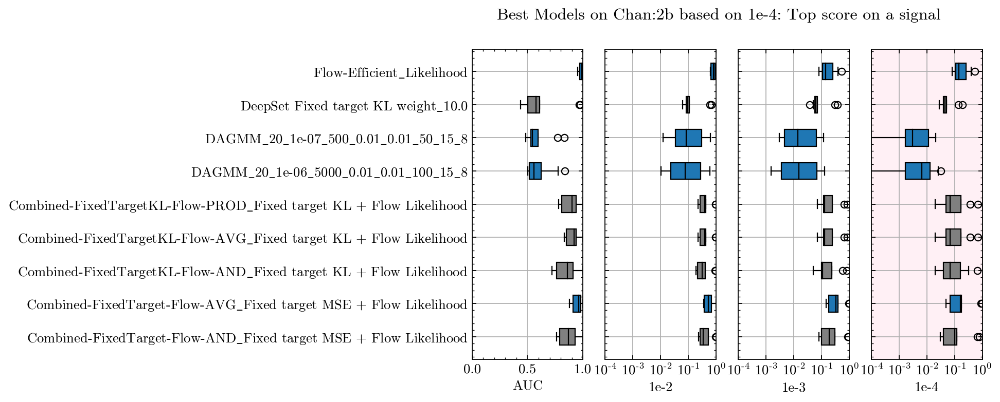

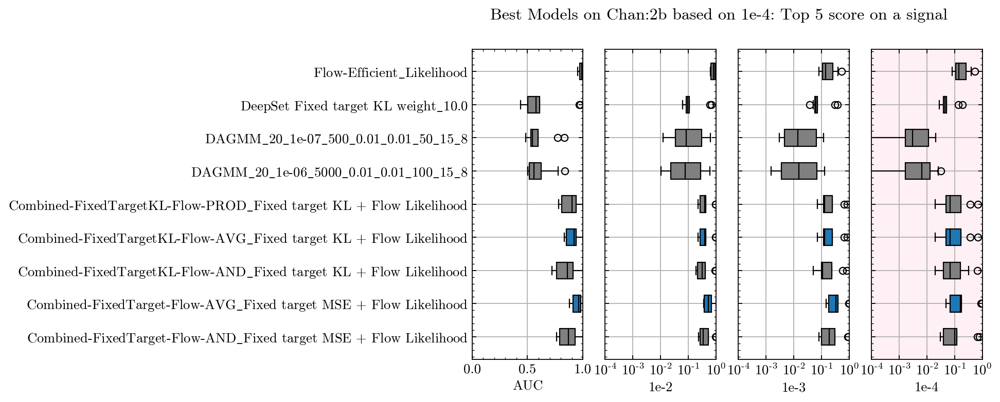

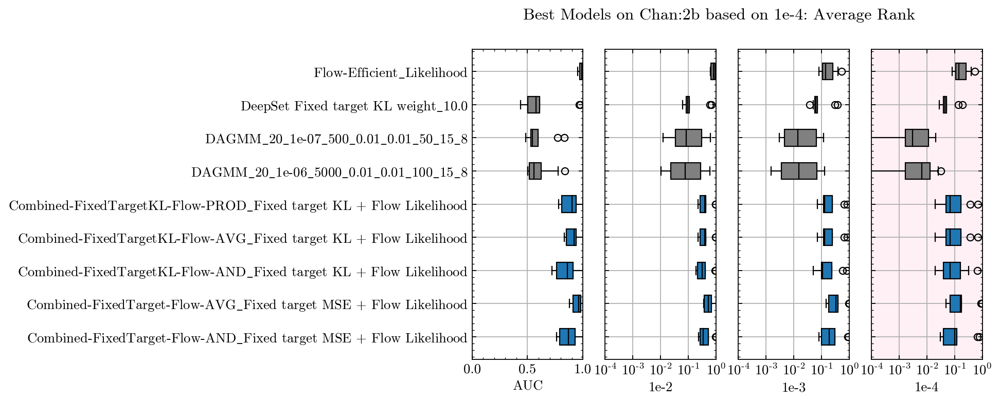

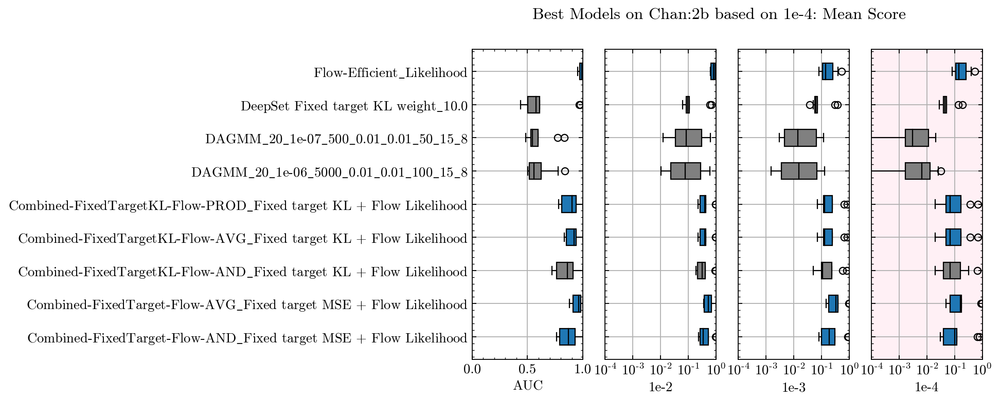

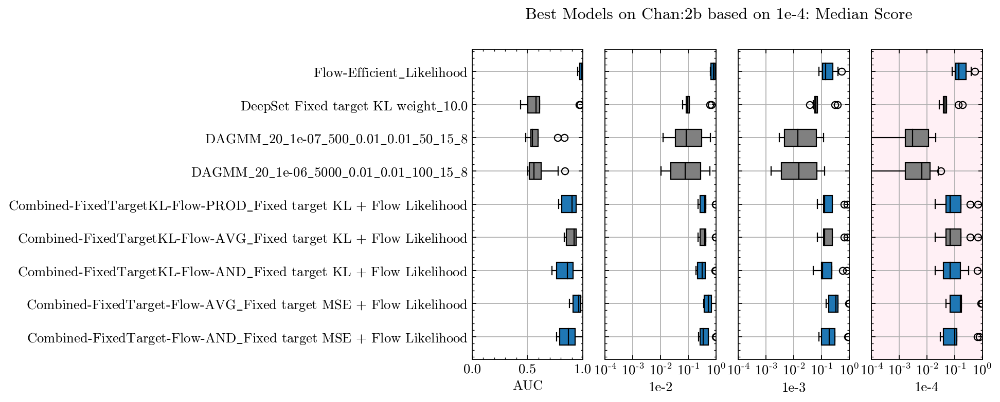

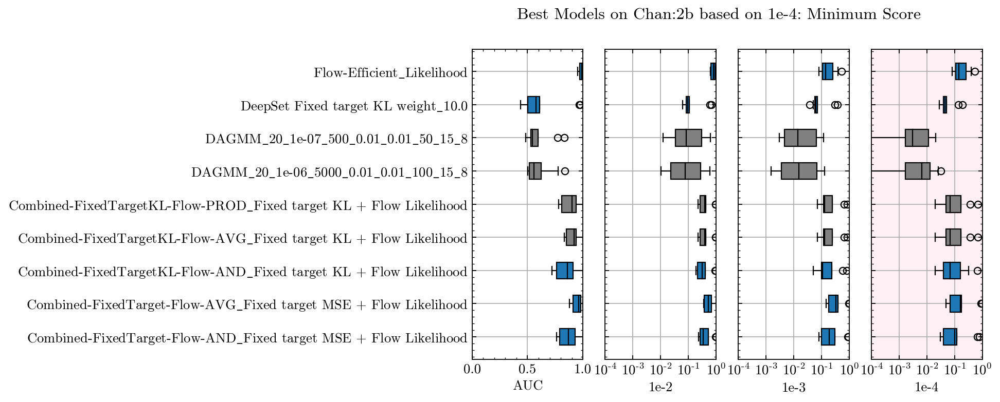

In [62]:
Analyze(AllCombined, 
        Chan='2b', 
        Metric='1e-4',
        MetricNumberDict = {'top1': 4,
                            'top5': 2,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

## Chan 3
### AUC

3 glgl1400_neutralino1100
3 glgl1600_neutralino800
3 gluino_1000.0_neutralino_1.0
3 monoV_Zp2000.0_DM_1.0
3 monojet_Zp2000.0_DM_50.0
3 monotop_200_A
3 sqsq1_sq1400_neut800
3 sqsq_sq1800_neut800
3 stlp_st1000
3 stop2b1000_neutralino300
****************************************
Models from chan=3 ranked by metric=AUC sorted by top1
                         Model  top1
471  Flow-Efficient_Likelihood     3
****************************************

****************************************
Models from chan=3 ranked by metric=AUC sorted by top5
                                                 Model  top5
471                          Flow-Efficient_Likelihood     8
472                     Flow-Efficient-No-E_Likelihood     8
290                                 VAE_HouseholderSNF     6
474  Combined-FixedTarget-Flow-OR_Fixed target MSE ...     5
478  Combined-FixedTargetKL-Flow-OR_Fixed target KL...     4
289                                     VAE_PlanarFlow     4
476  Combined-FixedTarget-Flow

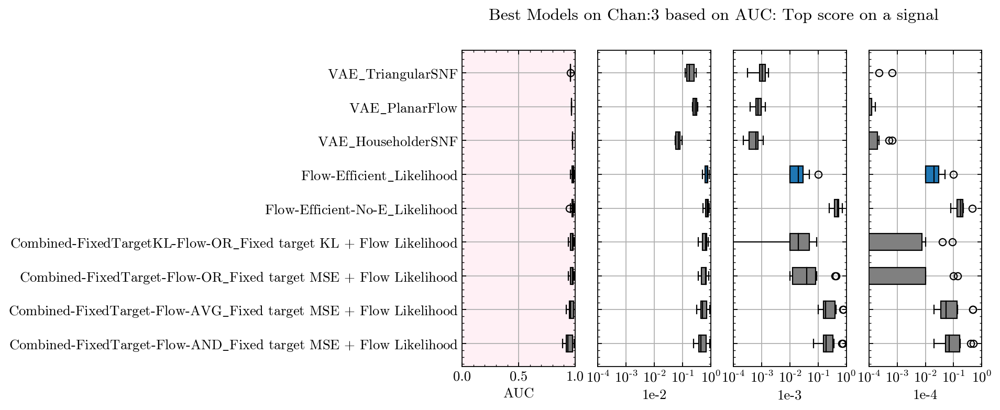

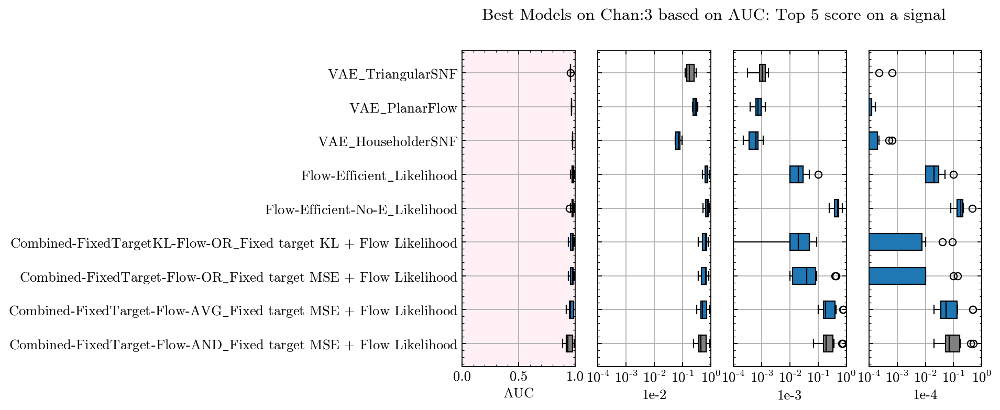

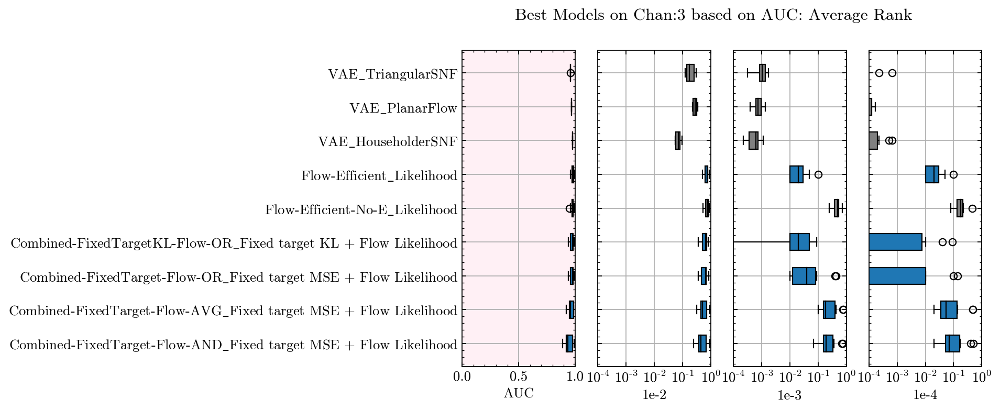

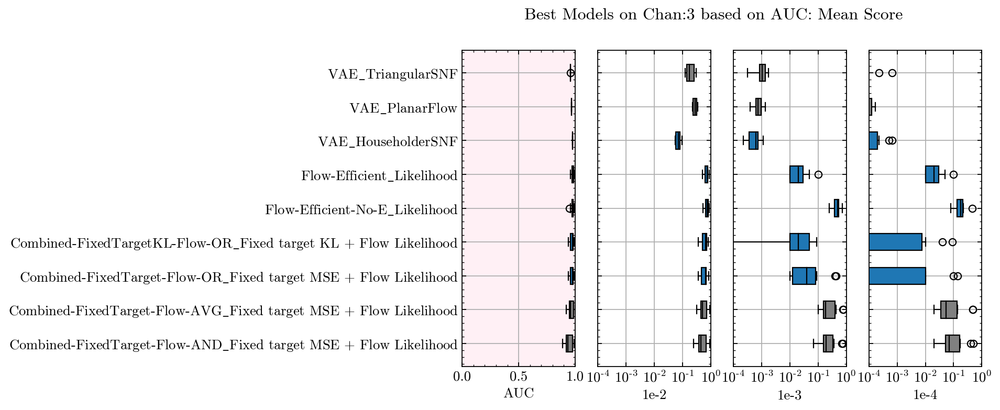

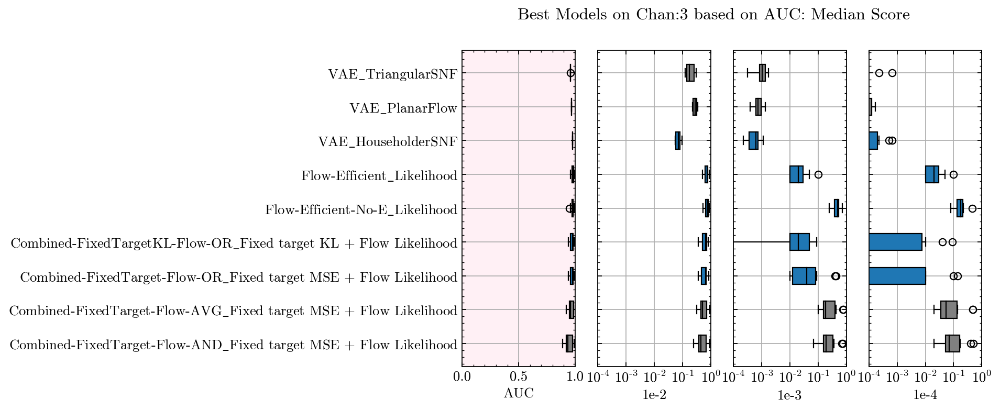

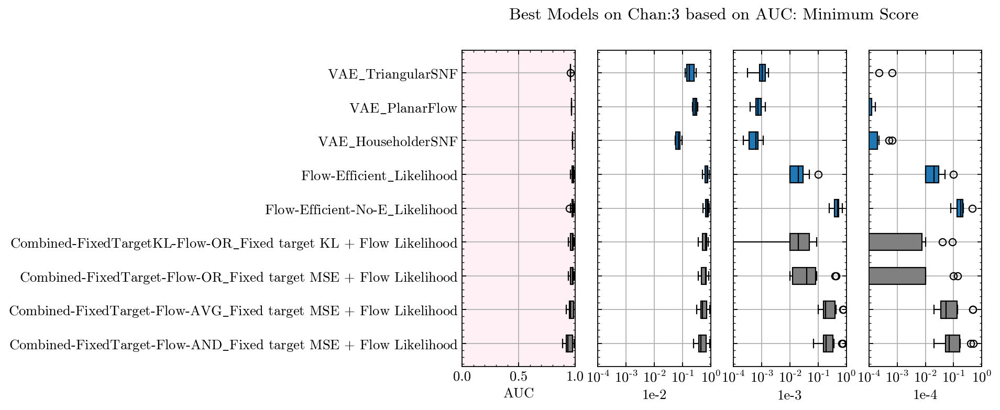

In [63]:
Analyze(AllCombined, 
        Chan='3', 
        Metric='AUC',
        MetricNumberDict = {'top1': 1,
                            'top5': 7,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-2

3 glgl1400_neutralino1100
3 glgl1600_neutralino800
3 gluino_1000.0_neutralino_1.0
3 monoV_Zp2000.0_DM_1.0
3 monojet_Zp2000.0_DM_50.0
3 monotop_200_A
3 sqsq1_sq1400_neut800
3 sqsq_sq1800_neut800
3 stlp_st1000
3 stop2b1000_neutralino300
****************************************
Models from chan=3 ranked by metric=1e-2 sorted by top1
                                                 Model  top1
472                     Flow-Efficient-No-E_Likelihood     7
476  Combined-FixedTarget-Flow-AVG_Fixed target MSE...     2
471                          Flow-Efficient_Likelihood     1
****************************************

****************************************
Models from chan=3 ranked by metric=1e-2 sorted by top5
                                                 Model  top5
471                          Flow-Efficient_Likelihood     8
472                     Flow-Efficient-No-E_Likelihood     8
474  Combined-FixedTarget-Flow-OR_Fixed target MSE ...     6
****************************************


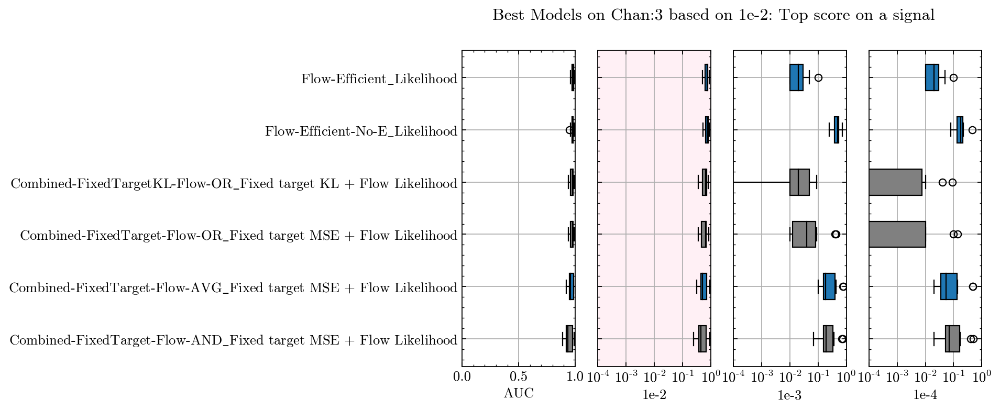

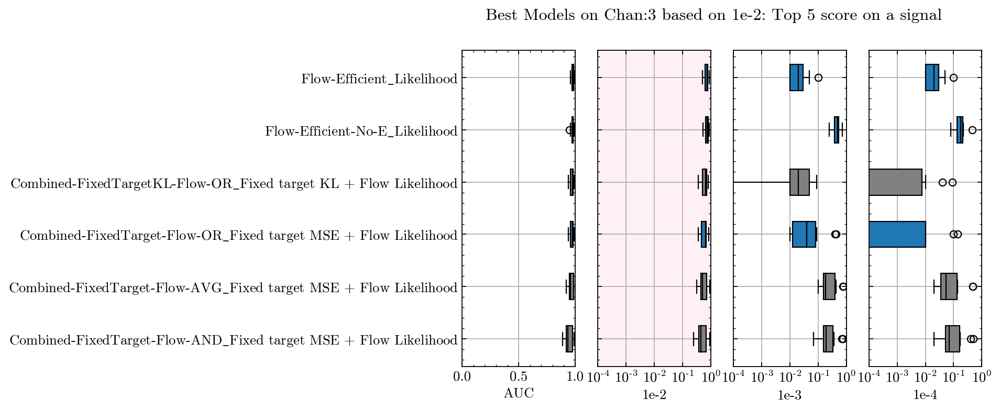

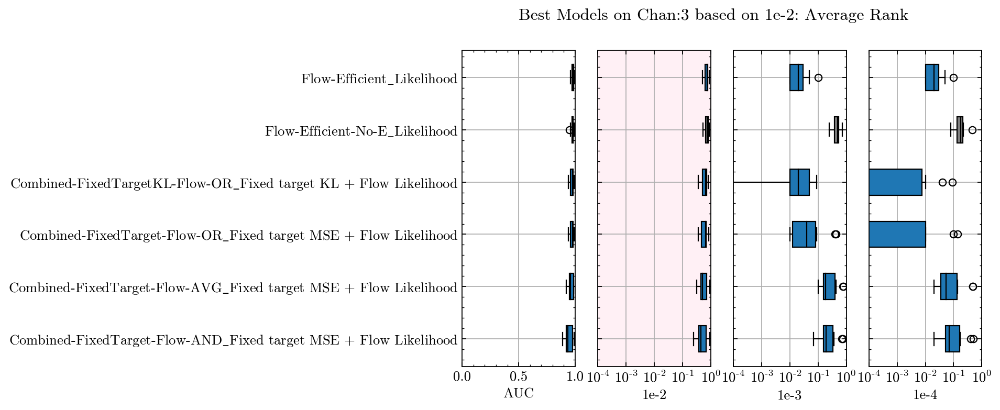

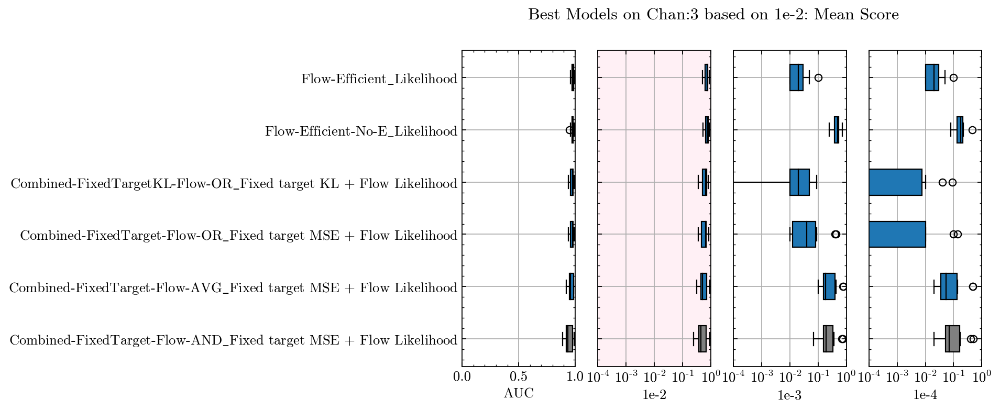

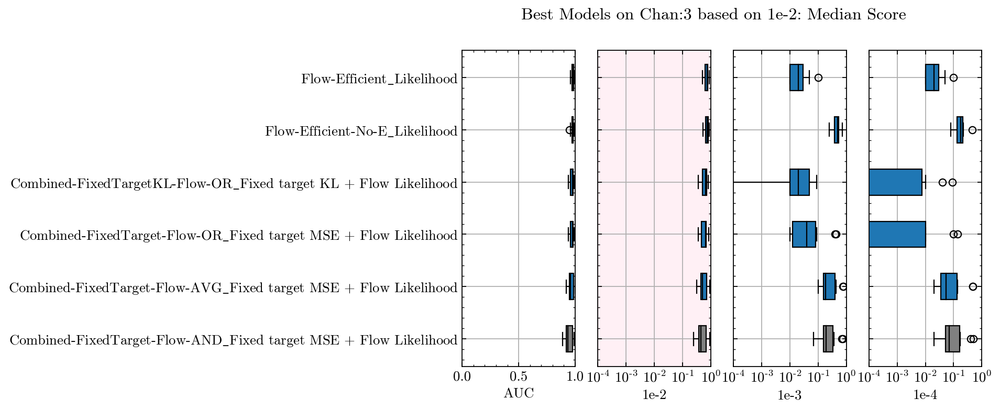

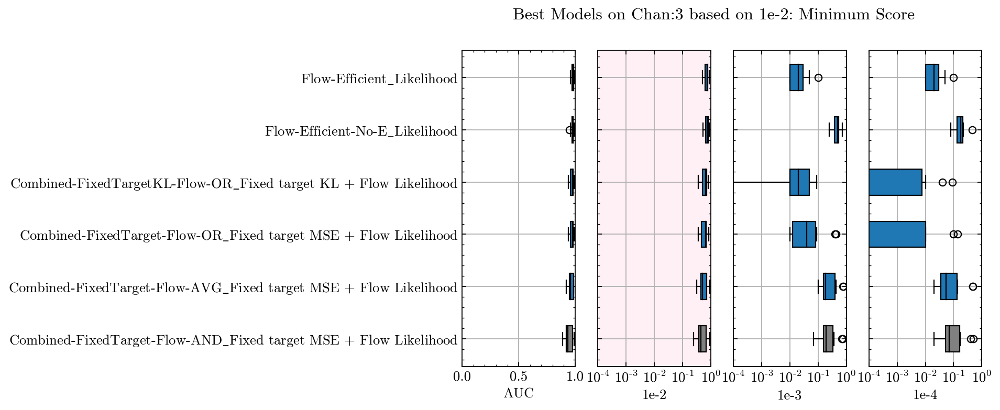

In [64]:
Analyze(AllCombined, 
        Chan='3', 
        Metric='1e-2',
        MetricNumberDict = {'top1': 3,
                            'top5': 3,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-3

3 glgl1400_neutralino1100
3 glgl1600_neutralino800
3 gluino_1000.0_neutralino_1.0
3 monoV_Zp2000.0_DM_1.0
3 monojet_Zp2000.0_DM_50.0
3 monotop_200_A
3 sqsq1_sq1400_neut800
3 sqsq_sq1800_neut800
3 stlp_st1000
3 stop2b1000_neutralino300
****************************************
Models from chan=3 ranked by metric=1e-3 sorted by top1
                                                 Model  top1
472                     Flow-Efficient-No-E_Likelihood     8
476  Combined-FixedTarget-Flow-AVG_Fixed target MSE...     2
****************************************

****************************************
Models from chan=3 ranked by metric=1e-3 sorted by top5
                                                 Model  top5
472                     Flow-Efficient-No-E_Likelihood     9
473  Combined-FixedTarget-Flow-AND_Fixed target MSE...     8
476  Combined-FixedTarget-Flow-AVG_Fixed target MSE...     8
****************************************

****************************************
Models from chan=3 

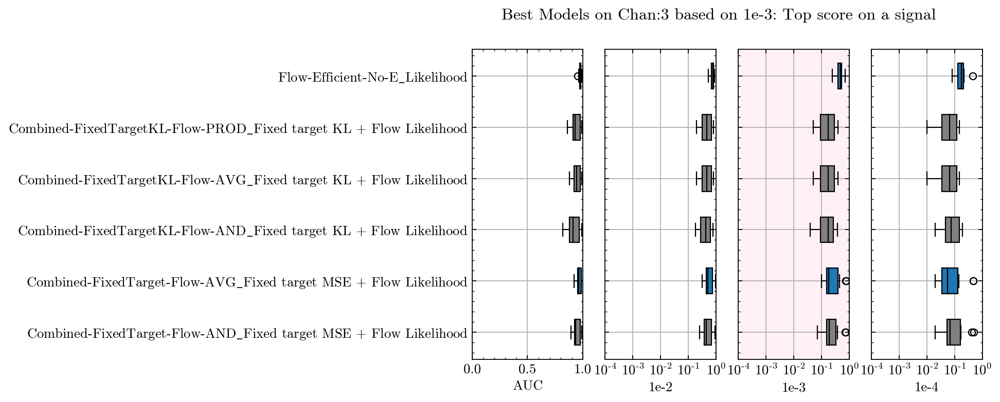

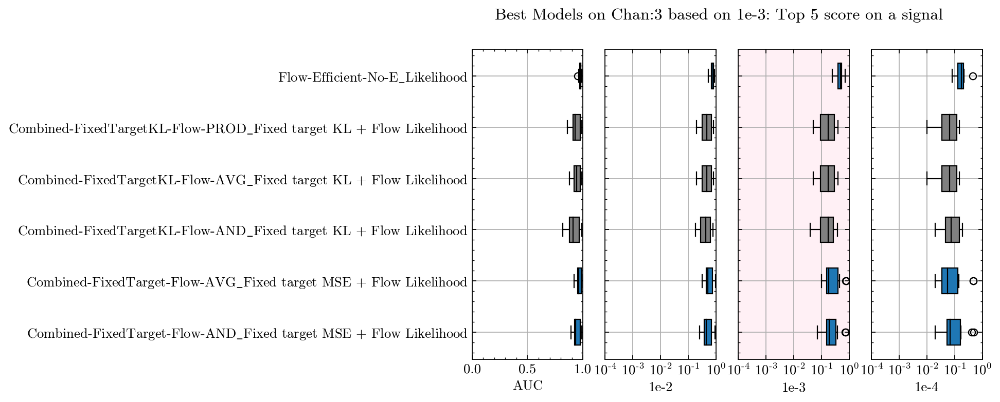

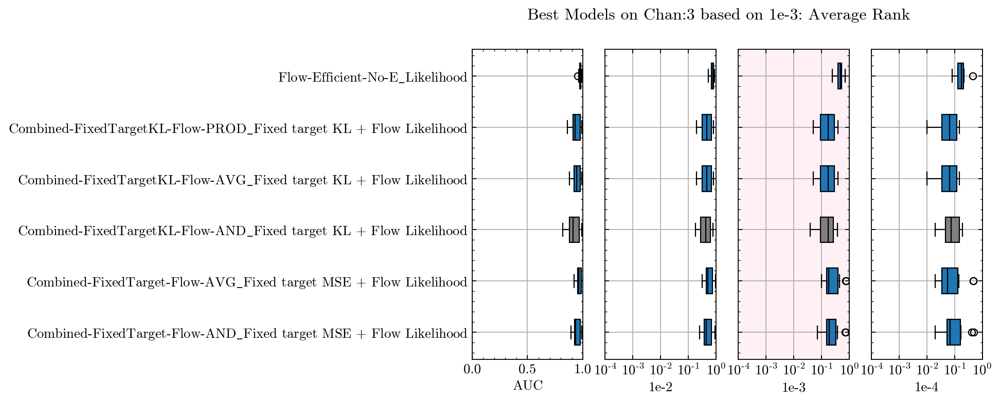

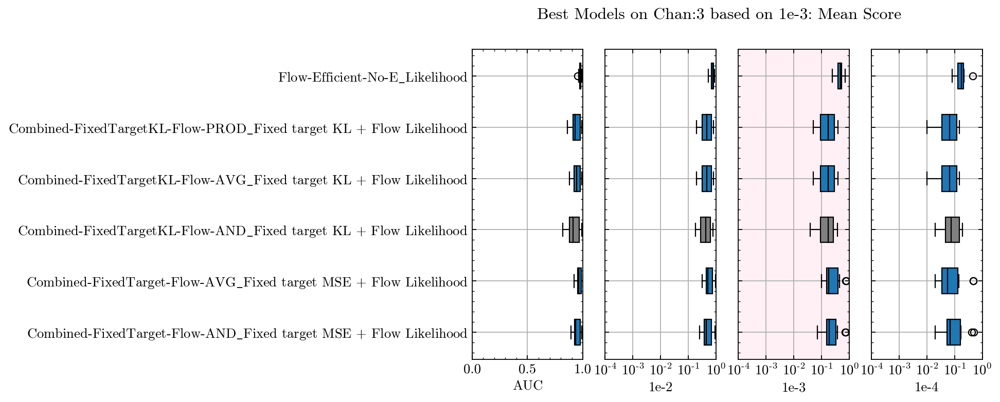

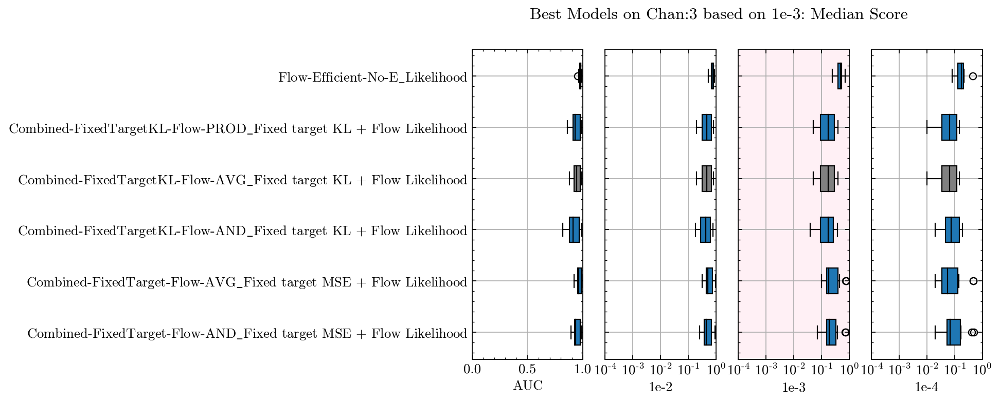

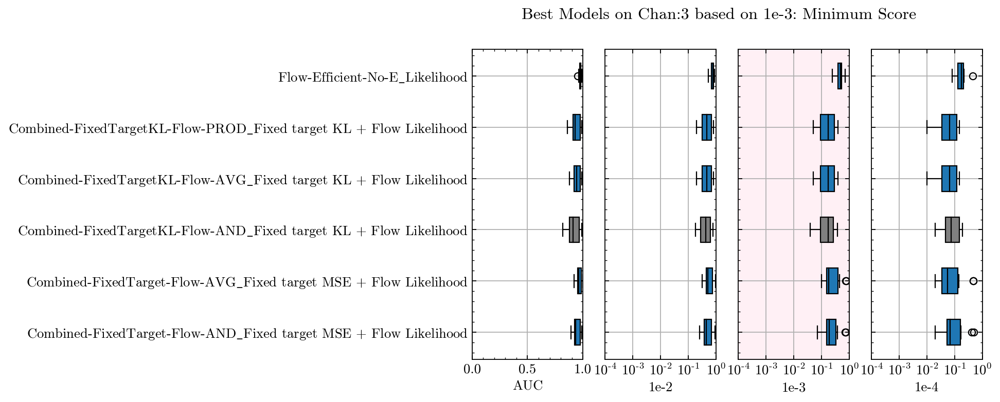

In [65]:
Analyze(AllCombined, 
        Chan='3', 
        Metric='1e-3',
        MetricNumberDict = {'top1': 2,
                            'top5': 3,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-4

3 glgl1400_neutralino1100
3 glgl1600_neutralino800
3 gluino_1000.0_neutralino_1.0
3 monoV_Zp2000.0_DM_1.0
3 monojet_Zp2000.0_DM_50.0
3 monotop_200_A
3 sqsq1_sq1400_neut800
3 sqsq_sq1800_neut800
3 stlp_st1000
3 stop2b1000_neutralino300
****************************************
Models from chan=3 ranked by metric=1e-4 sorted by top1
                                                 Model  top1
472                     Flow-Efficient-No-E_Likelihood     8
476  Combined-FixedTarget-Flow-AVG_Fixed target MSE...     1
473  Combined-FixedTarget-Flow-AND_Fixed target MSE...     1
0                                  LS_IF_13_0.001_1000     0
****************************************

****************************************
Models from chan=3 ranked by metric=1e-4 sorted by top5
                                                 Model  top5
472                     Flow-Efficient-No-E_Likelihood     9
473  Combined-FixedTarget-Flow-AND_Fixed target MSE...     7
476  Combined-FixedTarget-Flow-AVG_Fixed 

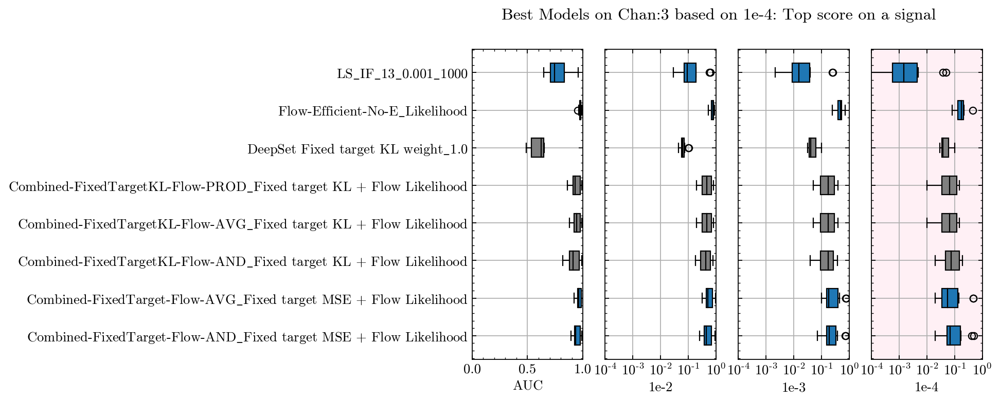

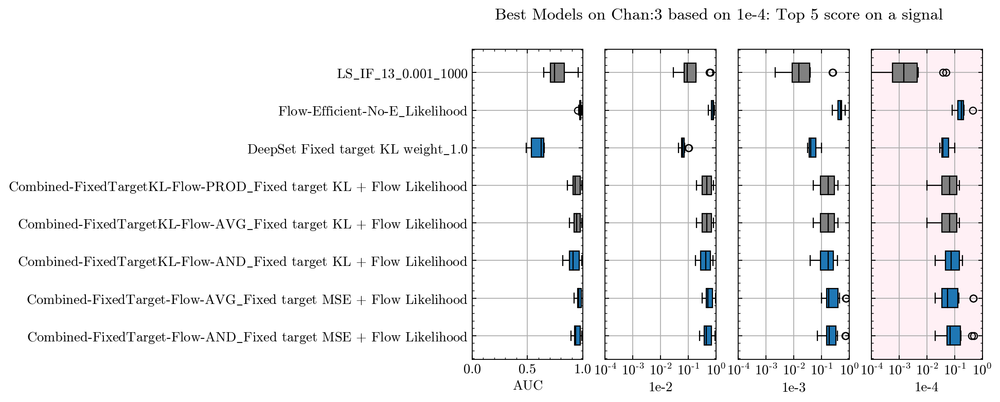

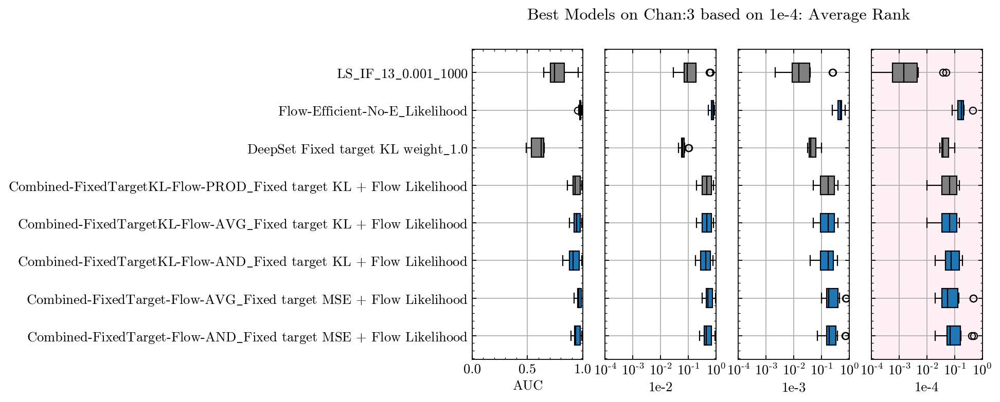

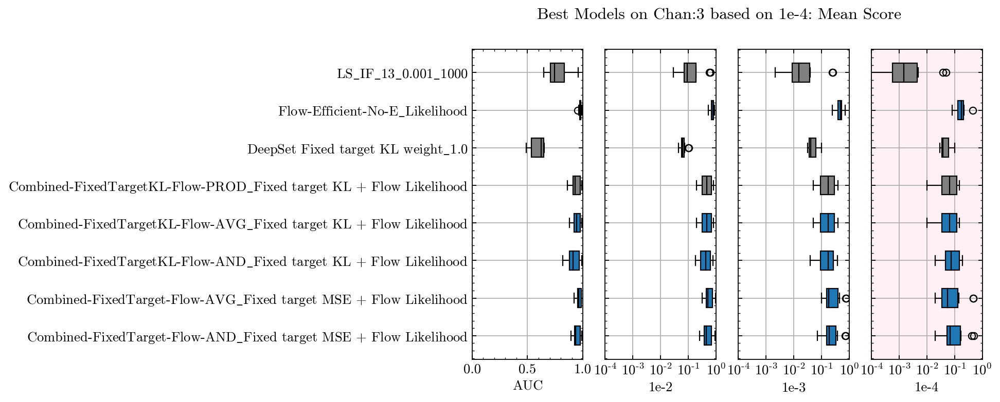

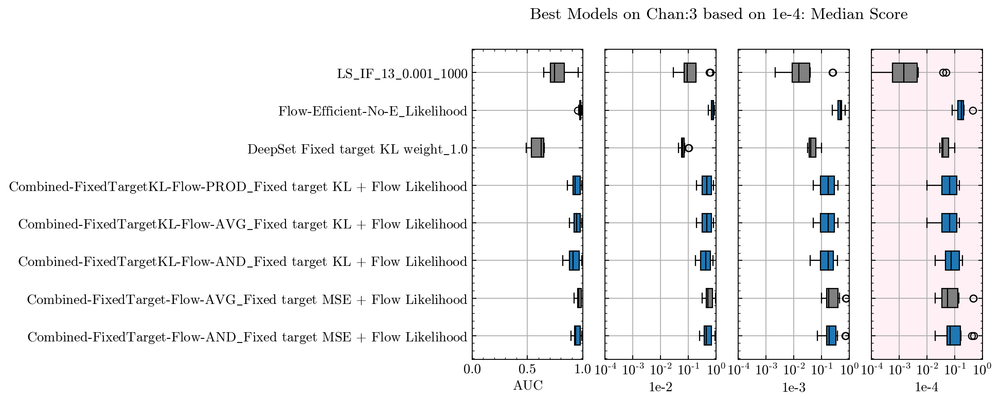

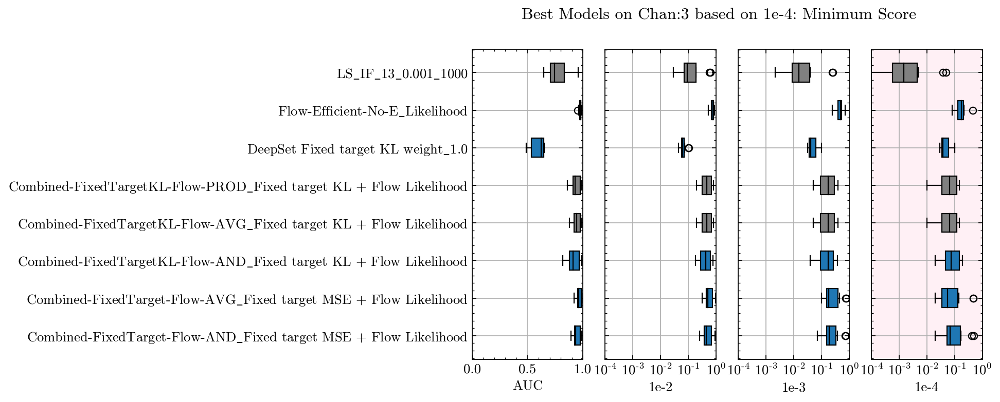

In [66]:
Analyze(AllCombined, 
        Chan='3', 
        Metric='1e-4',
        MetricNumberDict = {'top1': 4,
                            'top5': 5,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

## All Channels combined
### AUC

1 glgl1400_neutralino1100
1 glgl1600_neutralino800
1 monojet_Zp2000.0_DM_50.0
1 monotop_200_A
1 sqsq1_sq1400_neut800
1 sqsq_sq1800_neut800
1 stlp_st1000
1 stop2b1000_neutralino300
2a chaneut_cha200_neut50
2a chaneut_cha250_neut150
2a chaneut_cha300_neut100
2a chaneut_cha400_neut200
2a gluino_1000.0_neutralino_1.0
2a pp23mt_50
2a pp24mt_50
2b chacha_cha300_neut140
2b chacha_cha400_neut60
2b chacha_cha600_neut200
2b chaneut_cha200_neut50
2b chaneut_cha250_neut150
2b gluino_1000.0_neutralino_1.0
2b pp23mt_50
2b pp24mt_50
2b stlp_st1000
3 glgl1400_neutralino1100
3 glgl1600_neutralino800
3 gluino_1000.0_neutralino_1.0
3 monoV_Zp2000.0_DM_1.0
3 monojet_Zp2000.0_DM_50.0
3 monotop_200_A
3 sqsq1_sq1400_neut800
3 sqsq_sq1800_neut800
3 stlp_st1000
3 stop2b1000_neutralino300
****************************************
Models from chan=All ranked by metric=AUC sorted by top1
                                                 Model  top1
471                          Flow-Efficient_Likelihood     8
290   

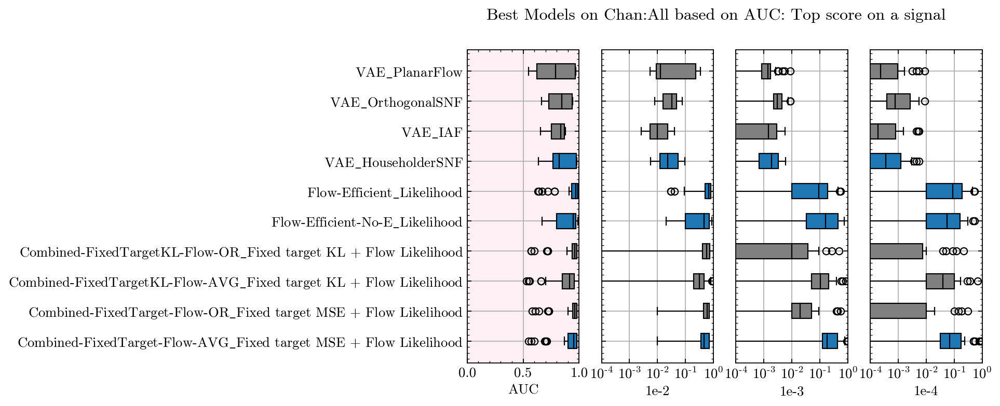

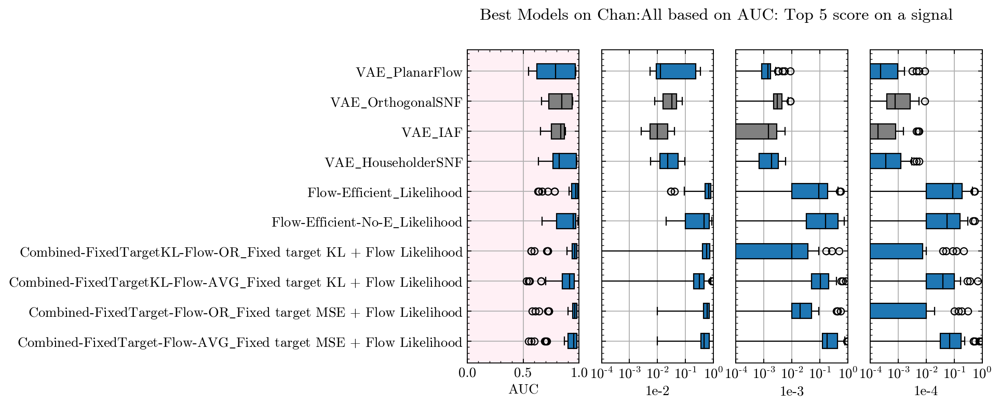

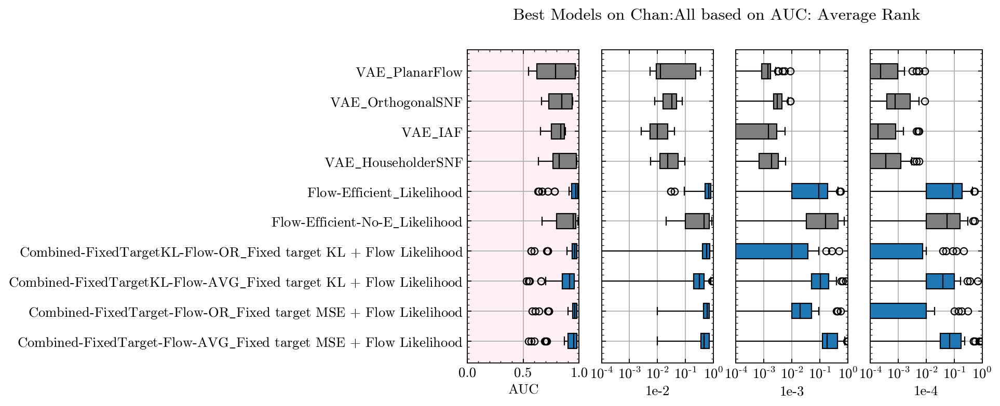

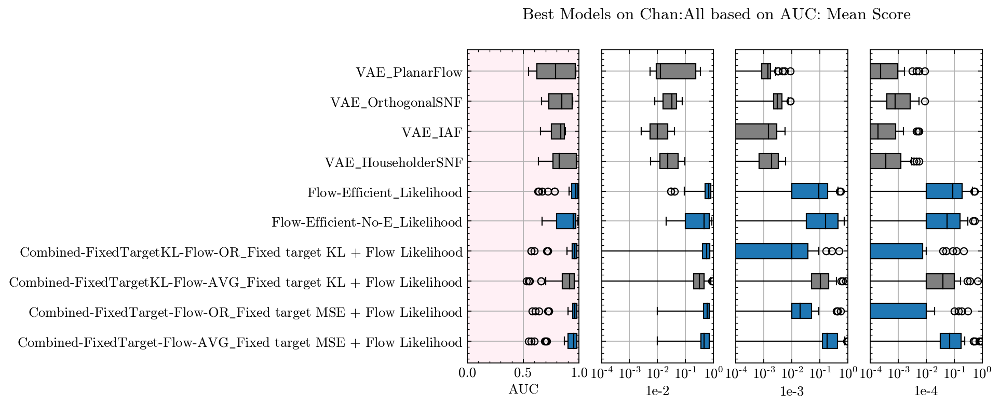

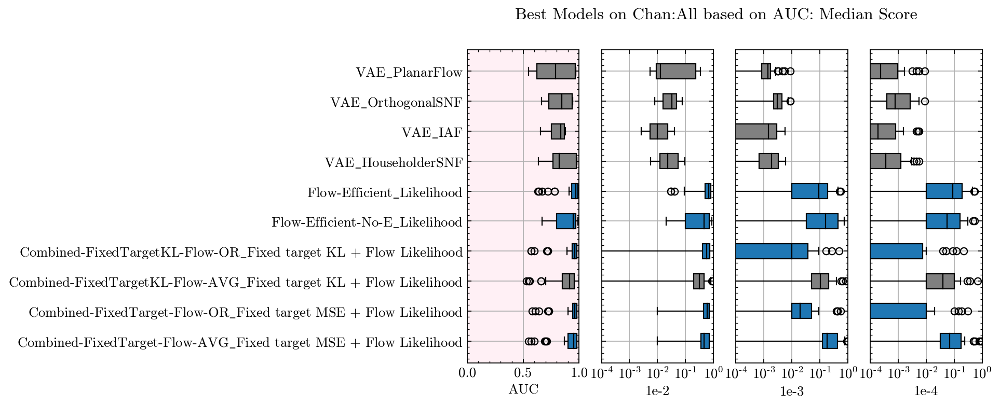

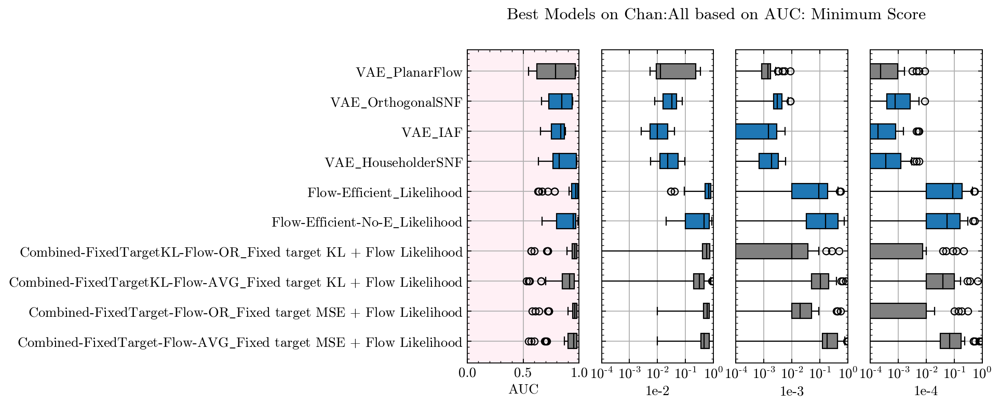

In [67]:
Analyze(AllCombined, 
        Chan='All', 
        Metric='AUC',
        MetricNumberDict = {'top1': 4,
                            'top5': 8,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-2

1 glgl1400_neutralino1100
1 glgl1600_neutralino800
1 monojet_Zp2000.0_DM_50.0
1 monotop_200_A
1 sqsq1_sq1400_neut800
1 sqsq_sq1800_neut800
1 stlp_st1000
1 stop2b1000_neutralino300
2a chaneut_cha200_neut50
2a chaneut_cha250_neut150
2a chaneut_cha300_neut100
2a chaneut_cha400_neut200
2a gluino_1000.0_neutralino_1.0
2a pp23mt_50
2a pp24mt_50
2b chacha_cha300_neut140
2b chacha_cha400_neut60
2b chacha_cha600_neut200
2b chaneut_cha200_neut50
2b chaneut_cha250_neut150
2b gluino_1000.0_neutralino_1.0
2b pp23mt_50
2b pp24mt_50
2b stlp_st1000
3 glgl1400_neutralino1100
3 glgl1600_neutralino800
3 gluino_1000.0_neutralino_1.0
3 monoV_Zp2000.0_DM_1.0
3 monojet_Zp2000.0_DM_50.0
3 monotop_200_A
3 sqsq1_sq1400_neut800
3 sqsq_sq1800_neut800
3 stlp_st1000
3 stop2b1000_neutralino300
****************************************
Models from chan=All ranked by metric=1e-2 sorted by top1
                                                 Model  top1
472                     Flow-Efficient-No-E_Likelihood     7
475  

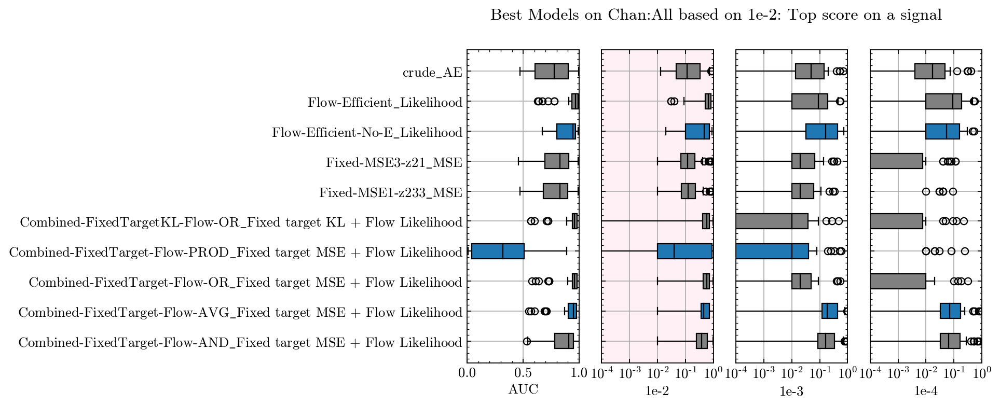

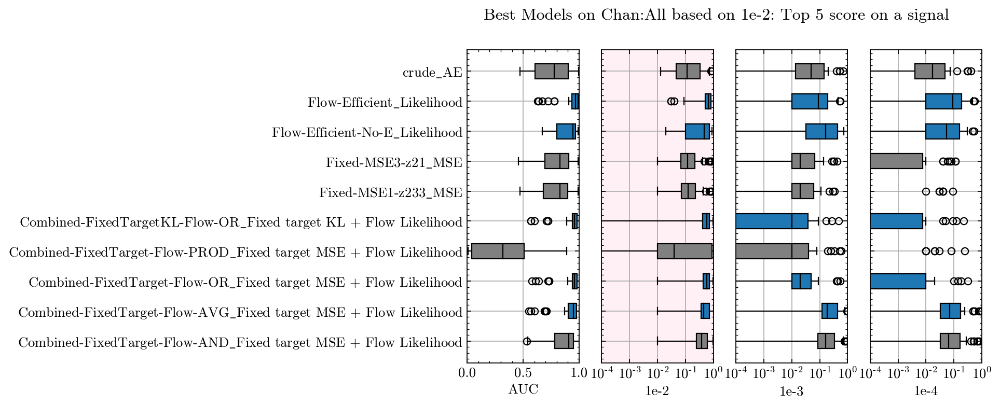

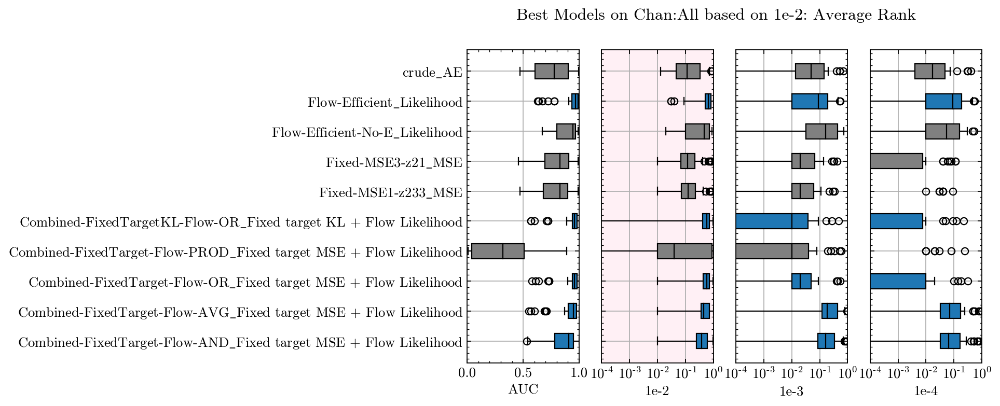

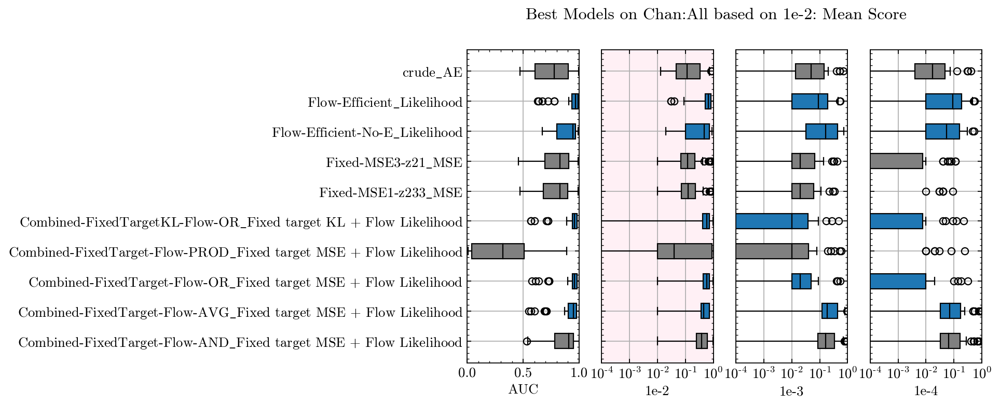

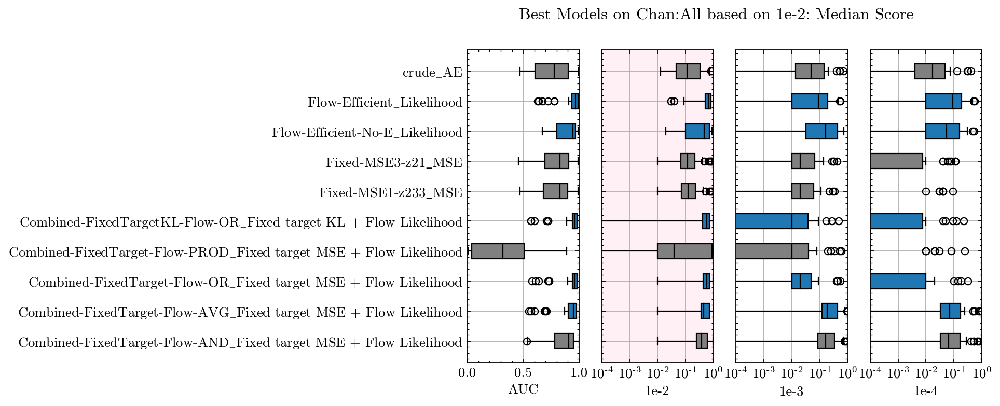

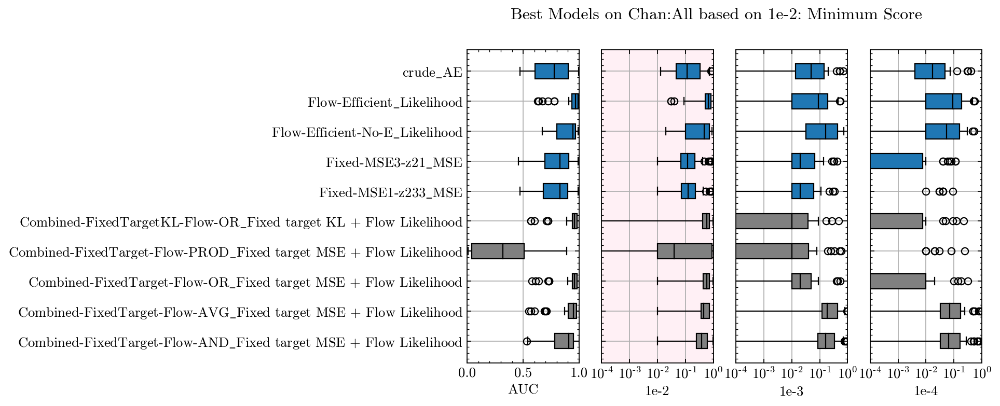

In [68]:
Analyze(AllCombined, 
        Chan='All', 
        Metric='1e-2',
        MetricNumberDict = {'top1': 3,
                            'top5': 5,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-3

1 glgl1400_neutralino1100
1 glgl1600_neutralino800
1 monojet_Zp2000.0_DM_50.0
1 monotop_200_A
1 sqsq1_sq1400_neut800
1 sqsq_sq1800_neut800
1 stlp_st1000
1 stop2b1000_neutralino300
2a chaneut_cha200_neut50
2a chaneut_cha250_neut150
2a chaneut_cha300_neut100
2a chaneut_cha400_neut200
2a gluino_1000.0_neutralino_1.0
2a pp23mt_50
2a pp24mt_50
2b chacha_cha300_neut140
2b chacha_cha400_neut60
2b chacha_cha600_neut200
2b chaneut_cha200_neut50
2b chaneut_cha250_neut150
2b gluino_1000.0_neutralino_1.0
2b pp23mt_50
2b pp24mt_50
2b stlp_st1000
3 glgl1400_neutralino1100
3 glgl1600_neutralino800
3 gluino_1000.0_neutralino_1.0
3 monoV_Zp2000.0_DM_1.0
3 monojet_Zp2000.0_DM_50.0
3 monotop_200_A
3 sqsq1_sq1400_neut800
3 sqsq_sq1800_neut800
3 stlp_st1000
3 stop2b1000_neutralino300
****************************************
Models from chan=All ranked by metric=1e-3 sorted by top1
                                                 Model  top1
472                     Flow-Efficient-No-E_Likelihood     8
476  

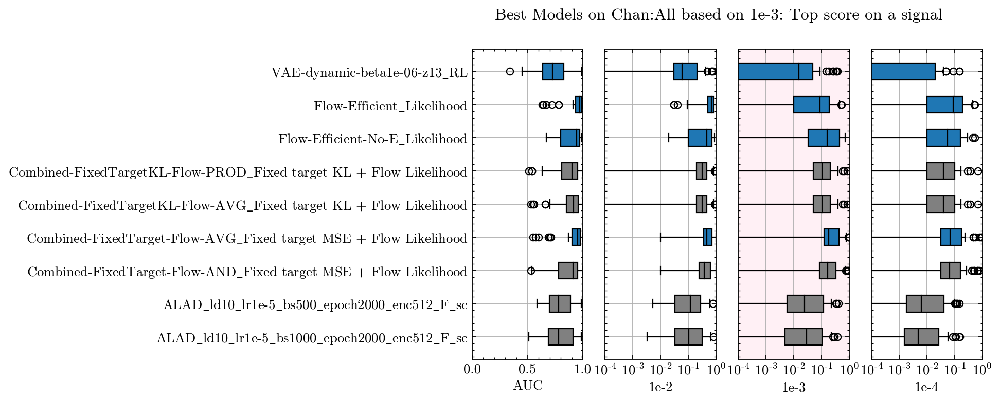

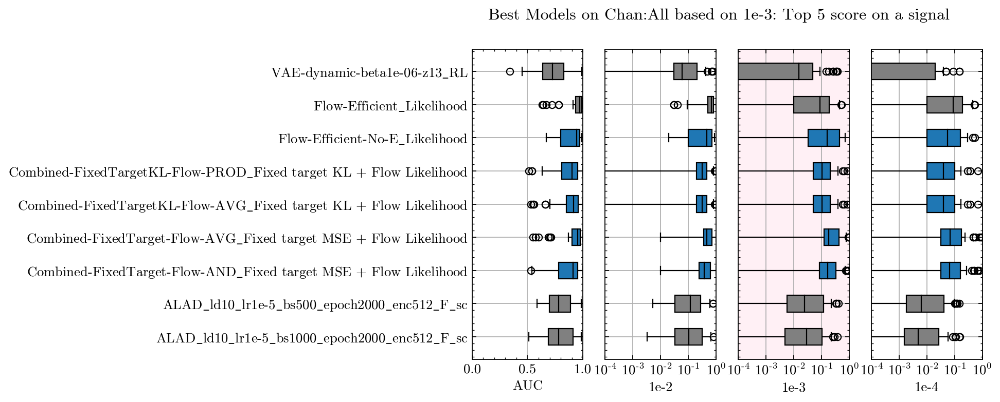

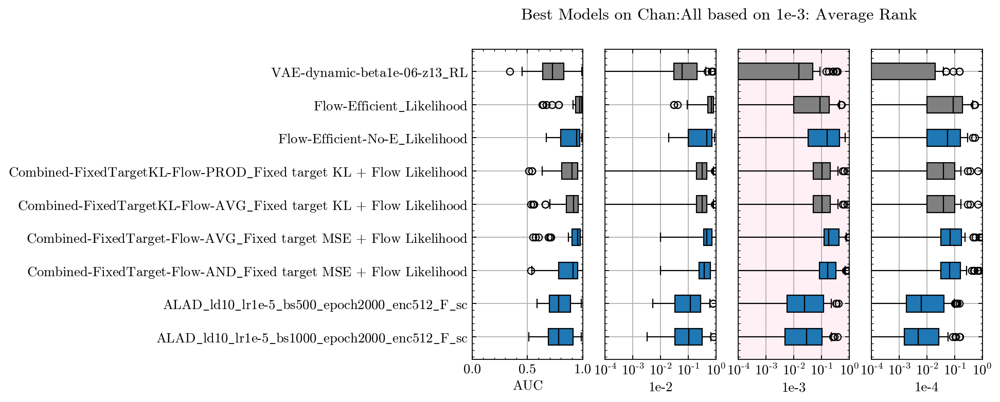

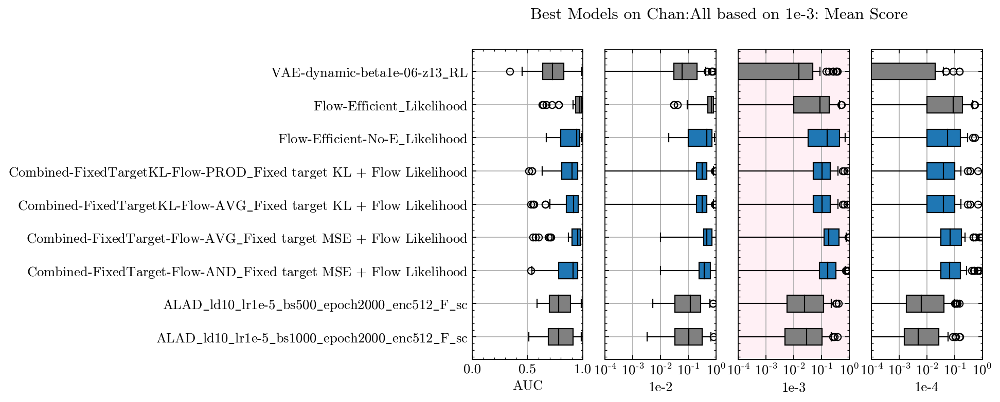

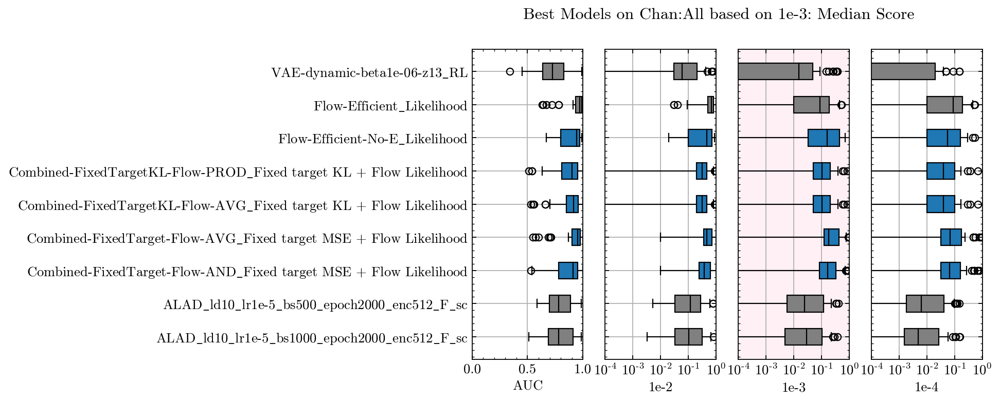

In [69]:
Analyze(AllCombined, 
        Chan='All', 
        Metric='1e-3',
        MetricNumberDict = {'top1': 4,
                            'top5': 5,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 0},
        Plot=True
       )

### 1e-4

1 glgl1400_neutralino1100
1 glgl1600_neutralino800
1 monojet_Zp2000.0_DM_50.0
1 monotop_200_A
1 sqsq1_sq1400_neut800
1 sqsq_sq1800_neut800
1 stlp_st1000
1 stop2b1000_neutralino300
2a chaneut_cha200_neut50
2a chaneut_cha250_neut150
2a chaneut_cha300_neut100
2a chaneut_cha400_neut200
2a gluino_1000.0_neutralino_1.0
2a pp23mt_50
2a pp24mt_50
2b chacha_cha300_neut140
2b chacha_cha400_neut60
2b chacha_cha600_neut200
2b chaneut_cha200_neut50
2b chaneut_cha250_neut150
2b gluino_1000.0_neutralino_1.0
2b pp23mt_50
2b pp24mt_50
2b stlp_st1000
3 glgl1400_neutralino1100
3 glgl1600_neutralino800
3 gluino_1000.0_neutralino_1.0
3 monoV_Zp2000.0_DM_1.0
3 monojet_Zp2000.0_DM_50.0
3 monotop_200_A
3 sqsq1_sq1400_neut800
3 sqsq_sq1800_neut800
3 stlp_st1000
3 stop2b1000_neutralino300
****************************************
Models from chan=All ranked by metric=1e-4 sorted by top1
                                                 Model  top1
472                     Flow-Efficient-No-E_Likelihood     9
471  

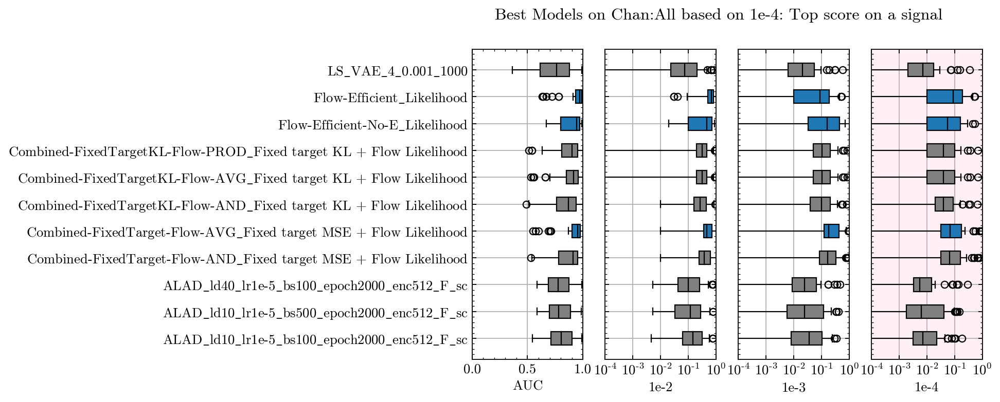

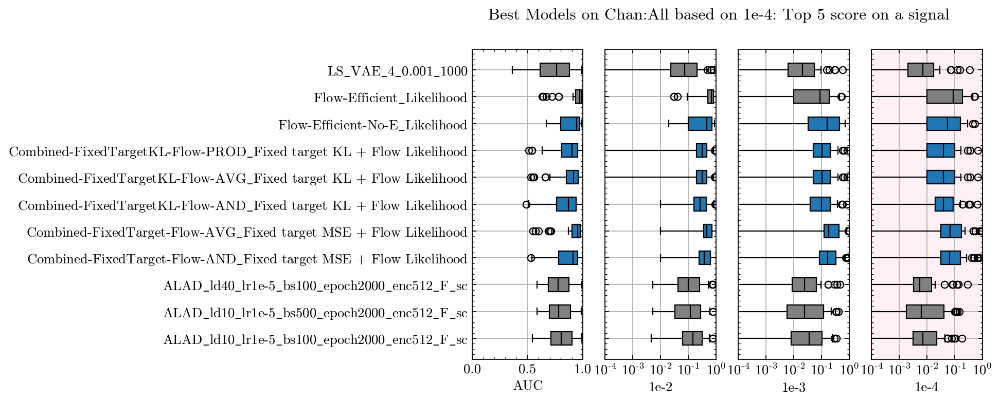

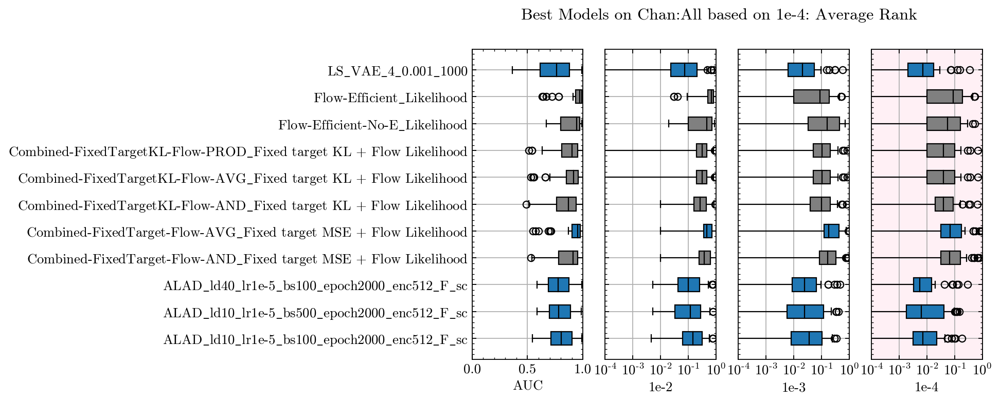

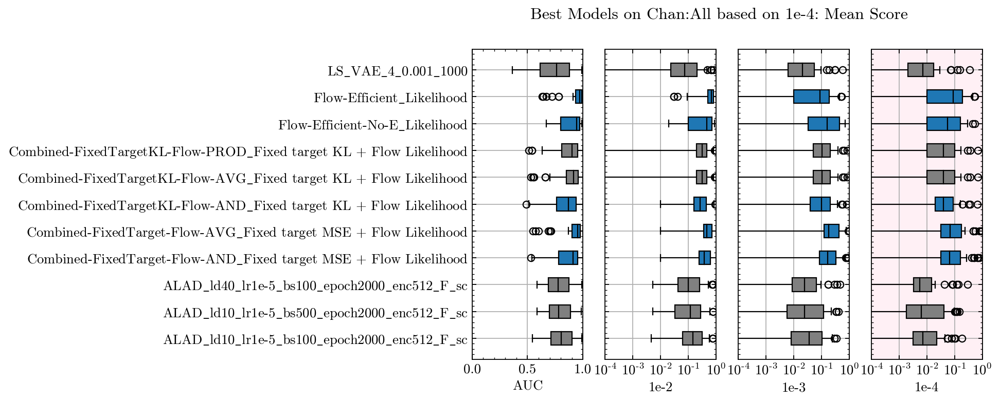

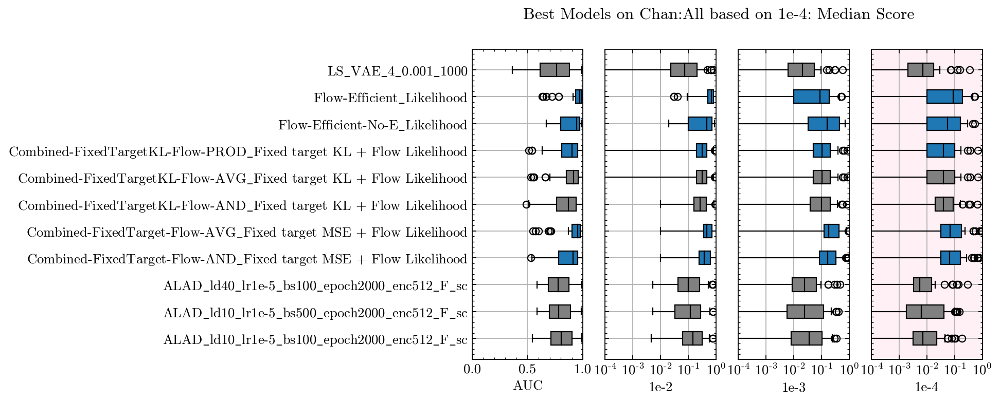

In [70]:
Analyze(AllCombined, 
        Chan='All', 
        Metric='1e-4',
        MetricNumberDict = {'top1': 3,
                            'top5': 6,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 0},
        Plot=True
       )

# Second combination
In the previous analysis, the models were grouped by how they did on the same metric, i.e. AUC or 1e-2. Each plot was then looking at a different ways of determining which models are best by that metric.

In the next analysis, the rolls will be flipped. The models will be grouped by the method of determining which does best, i.e. having the highest minimum or the highest average. The models which do best by this method for each metric will be shown on the same plot.

In [71]:
def AnalyzeByMethod(CombinedDataFrame, Chan, Method, MetricNumberDict, Plot):
    """
    Inputs:
        CombineedDataFrame: Pandas dataframe with columns ['Model', 'Signal', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']
        Chan: String with which signal chanel is being analyzed. Must be one of ['1', '2a', '2b', '3', 'All']
        Method: String indicating the metric to use, must be one of ['top1', 'top5', 'AverageRank', 'MeanScore', 'MedianScore', 'MinScore']
        MetricNumberDict: The number of models to include for each sorting. Will usually include 5, 
            but some of the rankings need different numbers.
            example: MetricNumberDict = {'AUC': 5, 
                                         '1e-2': 5,
                                         '1e-3': 5,
                                         '1e-4': 5}
        Plot: Boolean if to make bar plots or not
        
    """
    for col in ['Model', 'Signal', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']:
        if col not in CombinedDataFrame.columns:
            print(f'CombinedDataFrame is missing column {col}')
            return 0
    if Chan not in ['1', '2a', '2b', '3', 'All']:
        print(f'Invalid "Chan" selection: {Chan}')
        return 0
    if Method not in ['top1', 'top5', 'AverageRank', 'MeanScore', 'MedianScore', 'MinScore']:
        print(f'Invalid "Method" selection: {Method}')
        return 0
    
    if Chan != 'All':
        AnalyzeFrame = CombinedDataFrame[CombinedDataFrame['Chan'] == Chan]
    else:
        AnalyzeFrame = CombinedDataFrame
    
    # This helper variable combines the channel and signal since some signals appear in multiple channels
    chansig = AnalyzeFrame['Chan'] + '/' + AnalyzeFrame['Signal']
    chansig = np.unique(chansig)
    sigs = AnalyzeFrame.Signal.unique()
    mods = AnalyzeFrame.Model.unique()
    SortedScores = pd.DataFrame()
    SortedScores['Model'] = mods
    
    SortedScores = {}
    BestC = []
    TopDict = {}
    for Metric in ['AUC', '1e-2', '1e-3', '1e-4']:
        SortedScores[Metric] = pd.DataFrame()
        SortedScores[Metric]['Model'] = mods
        
        # Go through each of the signals to find the ranking of the models for AUC

        for sig in chansig:
            chan, sig = sig.split('/')
            cs = AnalyzeFrame[(AnalyzeFrame['Signal'] == sig) & (AnalyzeFrame['Chan']==chan)]
            scorelist = cs[Metric]
            score_ranking = np.zeros_like(scorelist)
            for i, score in enumerate(np.argsort(-scorelist)):  # argsort gives the ordering to sort them, we want the orthogonal information
                score_ranking[score] = i
            SortedScores[Metric][sig] = score_ranking
        SortedScores[Metric]['AverageRank'] = SortedScores[Metric][[col for col in SortedScores[Metric].columns if 'Model' not in col]].mean(axis=1)
        SortedScores[Metric]['top1'] = (SortedScores[Metric][[col for col in SortedScores[Metric].columns if (('AverageRank' not in col)
                                                                                      and ('Model' not in col)
                                                                                     )]] < 1).sum(axis=1)
        SortedScores[Metric]['top5'] = (SortedScores[Metric][[col for col in SortedScores[Metric].columns if (('AverageRank' not in col) and 
                                                                                      ('top1' not in col) and
                                                                                      ('Model' not in col)
                                                                                     )]] < 5).sum(axis=1)

        meanscore = []
        medianscore = []
        minscore = []
        for m in mods:
            tmpdf = AnalyzeFrame[AnalyzeFrame['Model'] == m]
            tmpscores = tmpdf[Metric]
            meanscore.append(tmpscores.mean())
            medianscore.append(tmpscores.median())
            minscore.append(tmpscores.min())
        SortedScores[Metric]['MeanScore'] = meanscore
        SortedScores[Metric]['MedianScore'] = medianscore
        SortedScores[Metric]['MinScore'] = minscore
    
        num = MetricNumberDict[Metric]
        if num == 0: continue
        TopDict[Metric] = SortedScores[Metric].sort_values(by=Method,ascending=True if Method =='AverageRank' else False)[['Model']][:num].to_numpy().reshape(num)
        BestC += list(TopDict[Metric])
        print('*'*40)
        print(f'Models from chan={Chan} ranked by metric={Metric} sorted by {Method}')
        print(SortedScores[Metric].sort_values(by=Method,ascending=True if Method =='AverageRank' else False)[['Model', Method]][:num])
        print('*'*40)
        print()
        
    if Plot:
        nameddict = {'top1': 'Top score on a signal',
                     'top5': 'Top 5 score on a signal',
                     'AverageRank': 'Average Rank',
                     'MeanScore': 'Mean Score',
                     'MedianScore': 'Median Score',
                     'MinScore': 'Minimum Score'
                    }
        name = nameddict[Method]
        BestC = np.array(BestC).flatten()
        BestCU = np.unique(BestC)
        
        plt.figure(figsize=(8, 5))

        for colnum, col in enumerate(['AUC', '1e-2', '1e-3', '1e-4']):
            colors = ['grey' for m in BestCU]
            
            if col in TopDict:
                for bestnum, m in enumerate(TopDict[col]):
                    for mnum, mtop in enumerate(BestCU):
                        if m == mtop:
                            colors[mnum] = f'C{bestnum}'
            ax = plt.subplot(1, 4, colnum + 1)
            yvs=[]
            names = []
            data_all = []
            for i,m in enumerate(BestCU):
                tmp_data = []
                tmpdf = AnalyzeFrame[AnalyzeFrame['Model']==m].copy()
                for s in chansig:
                    chan, s = s.split('/')
                    tmpauc = tmpdf[(tmpdf['Signal'] == s) & (tmpdf['Chan']==chan)][col]
                    tmp_data.append(tmpauc)
                data_all.append(np.array(tmp_data).reshape(len(chansig)))
                yvs.append(i)
                names.append(m)
            databp = np.array(data_all).reshape(len(BestCU), len(chansig))
            databp[databp == 0] = 1e-10
            bbox1 = plt.boxplot(databp.T,
                        vert=False,
                        manage_ticks=False,
                        patch_artist=True,
                        medianprops={'color':'k'},
                        positions=yvs
                       )

            if colnum == 0:
                plt.yticks(yvs, [n.replace('_', r'$\_$') for n in names])
                plt.xlim(0, 1)
            else:
                plt.yticks(yvs, [])
                plt.xscale('log')
                plt.xlim(1e-4, 1)
                plt.xticks([1e-4, 1e-3, 1e-2, 1e-1, 1e0])


            for patch, color, flier in zip(bbox1['boxes'], colors, bbox1['fliers']):
                patch.set_facecolor(color)
                flier.set_markerfacecolor(color)
                flier.set_markerfacecolor(color)
                flier.set_markeredgecolor(color)
            plt.minorticks_on()
            plt.grid()
            
            if col == 'AUC':
                plt.xlabel(col)
            elif col == '1e-2':
                plt.xlabel(r'$\epsilon_S(\epsilon_B=10^{-2})$')
            elif col == '1e-3':
                plt.xlabel(r'$\epsilon_S(\epsilon_B=10^{-3})$')
            elif col == '1e-4':
                plt.xlabel(r'$\epsilon_S(\epsilon_B=10^{-4})$')
            
        legend_elements = [Patch(facecolor='C0', edgecolor='k',
                         label='Best'),
                   Patch(facecolor='C1', edgecolor='k',
                         label='2nd'),
                   Patch(facecolor='C2', edgecolor='k',
                         label='3rd'),
                   Patch(facecolor='C3', edgecolor='k',
                         label='4th'),
                   Patch(facecolor='C4', edgecolor='k',
                         label='5th')
                  ]
        plt.legend(handles=legend_elements, 
                   loc=(1.05,0.3), 
                   labelspacing=1,
#                    ncol=5,
                   facecolor='white',
                   framealpha=1,
        #            markerscale=100,
                   frameon=True)

        plt.suptitle(f'Best models on all channels combined based on {name.lower()}')
        plt.savefig(f'../reports/Plots/TopChan{Chan}_{name.replace(" ", "_")}_boxplot.pdf', bbox_inches='tight')  
        plt.close()

## All Channels
### Top 1

In [72]:
AnalyzeByMethod(AllCombined, 
                Chan='All', 
                Method='top1', 
                MetricNumberDict={'AUC': 5,
                                  '1e-2': 5,
                                  '1e-3': 5,
                                  '1e-4': 5}, 
                Plot=True
               )

****************************************
Models from chan=All ranked by metric=AUC sorted by top1
                                                 Model  top1
471                          Flow-Efficient_Likelihood     8
290                                 VAE_HouseholderSNF     3
476  Combined-FixedTarget-Flow-AVG_Fixed target MSE...     3
472                     Flow-Efficient-No-E_Likelihood     3
474  Combined-FixedTarget-Flow-OR_Fixed target MSE ...     2
****************************************

****************************************
Models from chan=All ranked by metric=1e-2 sorted by top1
                                                 Model  top1
472                     Flow-Efficient-No-E_Likelihood     7
475  Combined-FixedTarget-Flow-PROD_Fixed target MS...     7
476  Combined-FixedTarget-Flow-AVG_Fixed target MSE...     2
471                          Flow-Efficient_Likelihood     2
496                                 Fixed-MSE0-z89_MSE     1
*****************************

### Top 5

In [73]:
AnalyzeByMethod(AllCombined, 
                Chan='All', 
                Method='top5', 
                MetricNumberDict={'AUC': 5,
                                  '1e-2': 5,
                                  '1e-3': 5,
                                  '1e-4': 5}, 
                Plot=True
               )

****************************************
Models from chan=All ranked by metric=AUC sorted by top5
                                                 Model  top5
471                          Flow-Efficient_Likelihood    17
474  Combined-FixedTarget-Flow-OR_Fixed target MSE ...    14
478  Combined-FixedTargetKL-Flow-OR_Fixed target KL...    13
476  Combined-FixedTarget-Flow-AVG_Fixed target MSE...    11
472                     Flow-Efficient-No-E_Likelihood    10
****************************************

****************************************
Models from chan=All ranked by metric=1e-2 sorted by top5
                                                 Model  top5
471                          Flow-Efficient_Likelihood    16
474  Combined-FixedTarget-Flow-OR_Fixed target MSE ...    13
478  Combined-FixedTargetKL-Flow-OR_Fixed target KL...    13
476  Combined-FixedTarget-Flow-AVG_Fixed target MSE...    12
472                     Flow-Efficient-No-E_Likelihood     8
*****************************

### Average Rank

In [74]:
AnalyzeByMethod(AllCombined, 
                Chan='All', 
                Method='AverageRank', 
                MetricNumberDict={'AUC': 5,
                                  '1e-2': 5,
                                  '1e-3': 5,
                                  '1e-4': 5}, 
                Plot=True
               )

****************************************
Models from chan=All ranked by metric=AUC sorted by AverageRank
                                                 Model  AverageRank
476  Combined-FixedTarget-Flow-AVG_Fixed target MSE...     4.000000
471                          Flow-Efficient_Likelihood     5.631579
474  Combined-FixedTarget-Flow-OR_Fixed target MSE ...     7.736842
478  Combined-FixedTargetKL-Flow-OR_Fixed target KL...     7.947368
480  Combined-FixedTargetKL-Flow-AVG_Fixed target K...    11.894737
****************************************

****************************************
Models from chan=All ranked by metric=1e-2 sorted by AverageRank
                                                 Model  AverageRank
471                          Flow-Efficient_Likelihood     8.631579
474  Combined-FixedTarget-Flow-OR_Fixed target MSE ...    13.894737
476  Combined-FixedTarget-Flow-AVG_Fixed target MSE...    18.210526
478  Combined-FixedTargetKL-Flow-OR_Fixed target KL...    27.684211

### Mean Score

In [75]:
AnalyzeByMethod(AllCombined, 
                Chan='All', 
                Method='MeanScore', 
                MetricNumberDict={'AUC': 5,
                                  '1e-2': 5,
                                  '1e-3': 5,
                                  '1e-4': 5}, 
                Plot=True
               )

****************************************
Models from chan=All ranked by metric=AUC sorted by MeanScore
                                                 Model  MeanScore
471                          Flow-Efficient_Likelihood   0.922941
474  Combined-FixedTarget-Flow-OR_Fixed target MSE ...   0.917059
478  Combined-FixedTargetKL-Flow-OR_Fixed target KL...   0.909118
476  Combined-FixedTarget-Flow-AVG_Fixed target MSE...   0.898529
472                     Flow-Efficient-No-E_Likelihood   0.884118
****************************************

****************************************
Models from chan=All ranked by metric=1e-2 sorted by MeanScore
                                                 Model  MeanScore
471                          Flow-Efficient_Likelihood   0.594706
474  Combined-FixedTarget-Flow-OR_Fixed target MSE ...   0.545882
478  Combined-FixedTargetKL-Flow-OR_Fixed target KL...   0.531765
476  Combined-FixedTarget-Flow-AVG_Fixed target MSE...   0.495294
472                     F

### Median Score

In [76]:
AnalyzeByMethod(AllCombined, 
                Chan='All', 
                Method='MedianScore', 
                MetricNumberDict={'AUC': 5,
                                  '1e-2': 5,
                                  '1e-3': 5,
                                  '1e-4': 5}, 
                Plot=True
               )

****************************************
Models from chan=All ranked by metric=AUC sorted by MedianScore
                                                 Model  MedianScore
471                          Flow-Efficient_Likelihood        0.970
474  Combined-FixedTarget-Flow-OR_Fixed target MSE ...        0.960
478  Combined-FixedTargetKL-Flow-OR_Fixed target KL...        0.960
476  Combined-FixedTarget-Flow-AVG_Fixed target MSE...        0.950
472                     Flow-Efficient-No-E_Likelihood        0.945
****************************************

****************************************
Models from chan=All ranked by metric=1e-2 sorted by MedianScore
                                                 Model  MedianScore
471                          Flow-Efficient_Likelihood        0.670
474  Combined-FixedTarget-Flow-OR_Fixed target MSE ...        0.590
478  Combined-FixedTargetKL-Flow-OR_Fixed target KL...        0.575
472                     Flow-Efficient-No-E_Likelihood        0.465

### Best Minimum Score

In [77]:
AnalyzeByMethod(AllCombined, 
                Chan='All', 
                Method='MinScore', 
                MetricNumberDict={'AUC': 5,
                                  '1e-2': 5,
                                  '1e-3': 1,
                                  '1e-4': 0}, 
                Plot=True
               )

****************************************
Models from chan=All ranked by metric=AUC sorted by MinScore
                              Model  MinScore
472  Flow-Efficient-No-E_Likelihood  0.670000
291               VAE_OrthogonalSNF  0.666274
293                         VAE_IAF  0.655265
290              VAE_HouseholderSNF  0.634438
471       Flow-Efficient_Likelihood  0.630000
****************************************

****************************************
Models from chan=All ranked by metric=1e-2 sorted by MinScore
                               Model  MinScore
471        Flow-Efficient_Likelihood  0.030000
472   Flow-Efficient-No-E_Likelihood  0.020000
1037                        crude_AE  0.013274
520               Fixed-MSE3-z21_MSE  0.010000
507              Fixed-MSE1-z233_MSE  0.010000
****************************************

****************************************
Models from chan=All ranked by metric=1e-3 sorted by MinScore
                                            Model 

## Scan through individual channels
### Chan 1

In [78]:
AnalyzeByMethod(AllCombined, 
                Chan='1', 
                Method='MinScore', 
                MetricNumberDict={'AUC': 5,
                                  '1e-2': 5,
                                  '1e-3': 5,
                                  '1e-4': 5}, 
                Plot=True
               )

****************************************
Models from chan=1 ranked by metric=AUC sorted by MinScore
                                                 Model  MinScore
471                          Flow-Efficient_Likelihood      0.91
474  Combined-FixedTarget-Flow-OR_Fixed target MSE ...      0.90
478  Combined-FixedTargetKL-Flow-OR_Fixed target KL...      0.89
476  Combined-FixedTarget-Flow-AVG_Fixed target MSE...      0.87
472                     Flow-Efficient-No-E_Likelihood      0.85
****************************************

****************************************
Models from chan=1 ranked by metric=1e-2 sorted by MinScore
                                                 Model  MinScore
471                          Flow-Efficient_Likelihood      0.44
478  Combined-FixedTargetKL-Flow-OR_Fixed target KL...      0.35
474  Combined-FixedTarget-Flow-OR_Fixed target MSE ...      0.35
476  Combined-FixedTarget-Flow-AVG_Fixed target MSE...      0.26
472                     Flow-Efficient-No-

### Chan 2a

In [79]:
AnalyzeByMethod(AllCombined, 
                Chan='2a', 
                Method='MinScore', 
                MetricNumberDict={'AUC': 5,
                                  '1e-2': 5,
                                  '1e-3': 3,
                                  '1e-4': 0}, 
                Plot=True
               )

****************************************
Models from chan=2a ranked by metric=AUC sorted by MinScore
                              Model  MinScore
472  Flow-Efficient-No-E_Likelihood  0.670000
291               VAE_OrthogonalSNF  0.666274
292               VAE_TriangularSNF  0.655265
293                         VAE_IAF  0.655265
290              VAE_HouseholderSNF  0.634438
****************************************

****************************************
Models from chan=2a ranked by metric=1e-2 sorted by MinScore
                               Model  MinScore
471        Flow-Efficient_Likelihood  0.030000
472   Flow-Efficient-No-E_Likelihood  0.020000
1038                         CNN_VAE  0.015097
291                VAE_OrthogonalSNF  0.013410
1037                        crude_AE  0.013274
****************************************

****************************************
Models from chan=2a ranked by metric=1e-3 sorted by MinScore
                                             Model  M

### Chan 2b

In [80]:
AnalyzeByMethod(AllCombined, 
                Chan='2b', 
                Method='MinScore', 
                MetricNumberDict={'AUC': 5,
                                  '1e-2': 5,
                                  '1e-3': 5,
                                  '1e-4': 5}, 
                Plot=True
               )

****************************************
Models from chan=2b ranked by metric=AUC sorted by MinScore
                                                 Model  MinScore
474  Combined-FixedTarget-Flow-OR_Fixed target MSE ...  0.960000
471                          Flow-Efficient_Likelihood  0.950000
478  Combined-FixedTargetKL-Flow-OR_Fixed target KL...  0.950000
476  Combined-FixedTarget-Flow-AVG_Fixed target MSE...  0.880000
291                                  VAE_OrthogonalSNF  0.845863
****************************************

****************************************
Models from chan=2b ranked by metric=1e-2 sorted by MinScore
                                                 Model  MinScore
475  Combined-FixedTarget-Flow-PROD_Fixed target MS...      1.00
471                          Flow-Efficient_Likelihood      0.62
474  Combined-FixedTarget-Flow-OR_Fixed target MSE ...      0.58
478  Combined-FixedTargetKL-Flow-OR_Fixed target KL...      0.57
476  Combined-FixedTarget-Flow-AVG_Fixed

### Chan 3

In [81]:
AnalyzeByMethod(AllCombined, 
                Chan='3', 
                Method='MinScore', 
                MetricNumberDict={'AUC': 5,
                                  '1e-2': 5,
                                  '1e-3': 5,
                                  '1e-4': 5}, 
                Plot=True
               )

****************************************
Models from chan=3 ranked by metric=AUC sorted by MinScore
                              Model  MinScore
290              VAE_HouseholderSNF  0.974891
289                  VAE_PlanarFlow  0.966551
471       Flow-Efficient_Likelihood  0.960000
292               VAE_TriangularSNF  0.956197
472  Flow-Efficient-No-E_Likelihood  0.950000
****************************************

****************************************
Models from chan=3 ranked by metric=1e-2 sorted by MinScore
                                                 Model  MinScore
472                     Flow-Efficient-No-E_Likelihood      0.53
471                          Flow-Efficient_Likelihood      0.52
478  Combined-FixedTargetKL-Flow-OR_Fixed target KL...      0.37
474  Combined-FixedTarget-Flow-OR_Fixed target MSE ...      0.36
476  Combined-FixedTarget-Flow-AVG_Fixed target MSE...      0.32
****************************************

****************************************
Models f

# Analysis of the Physics Signals

The goal of this part of the analysis is to determine which signals are easy for _most_ models to get and which ones are the most challenging for the unsupervised methods.

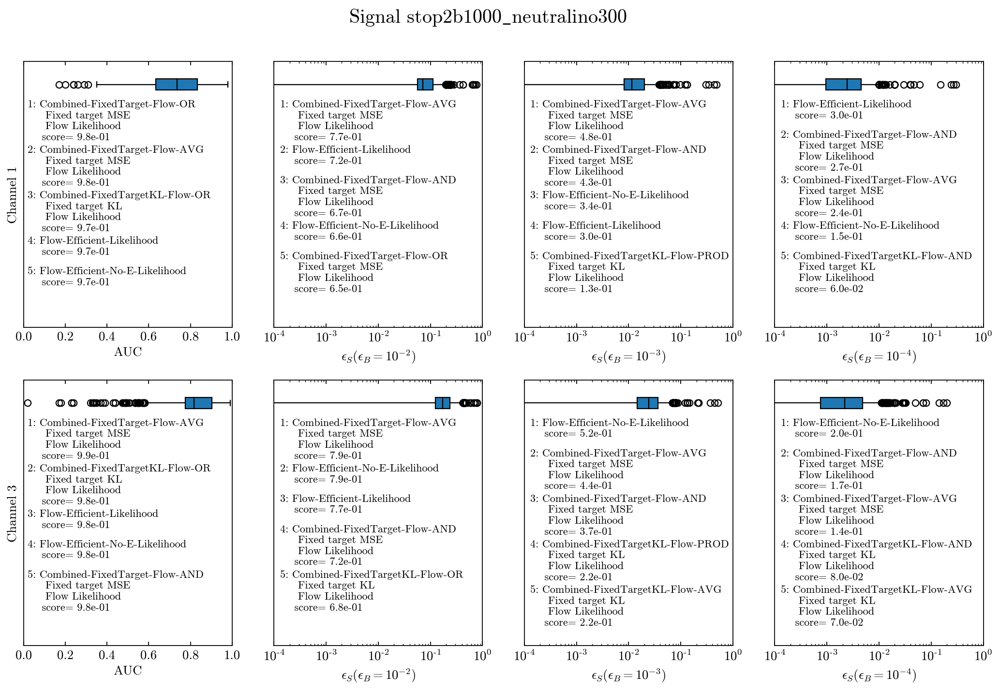

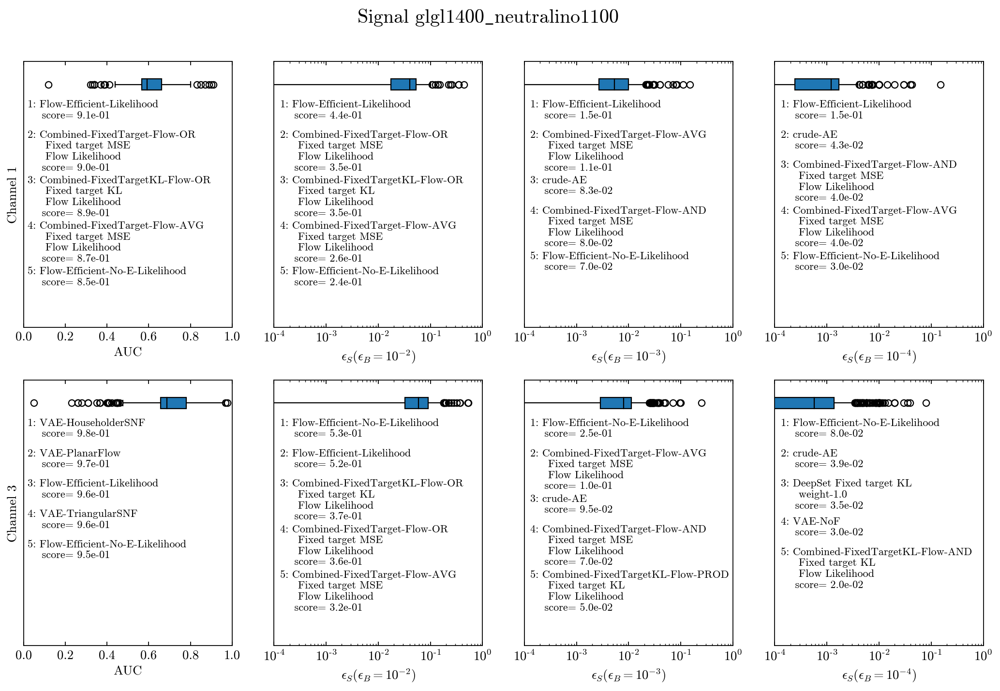

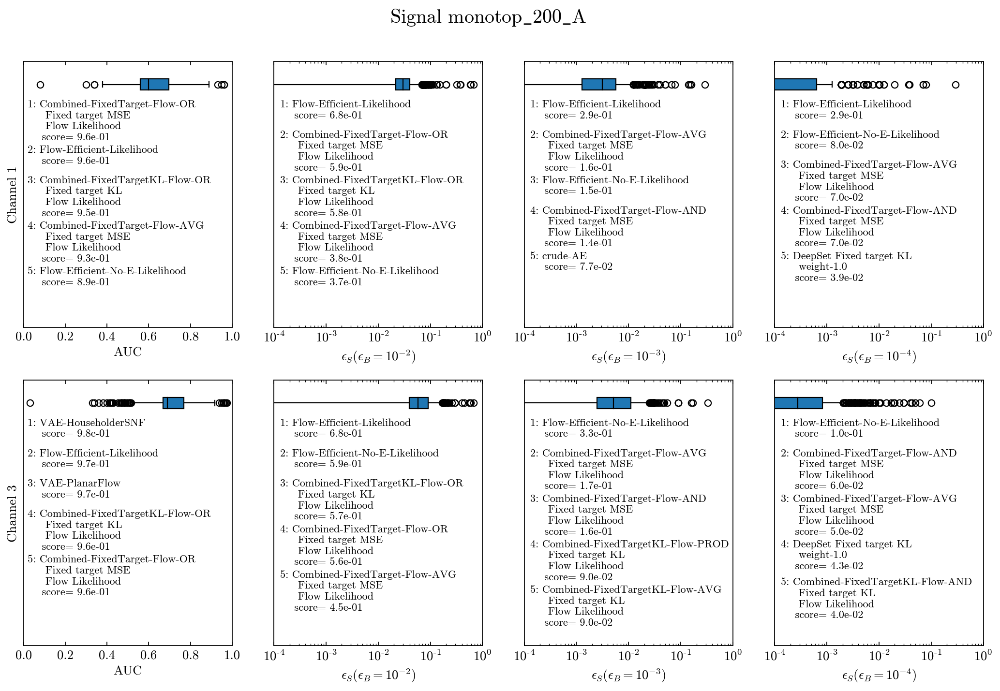

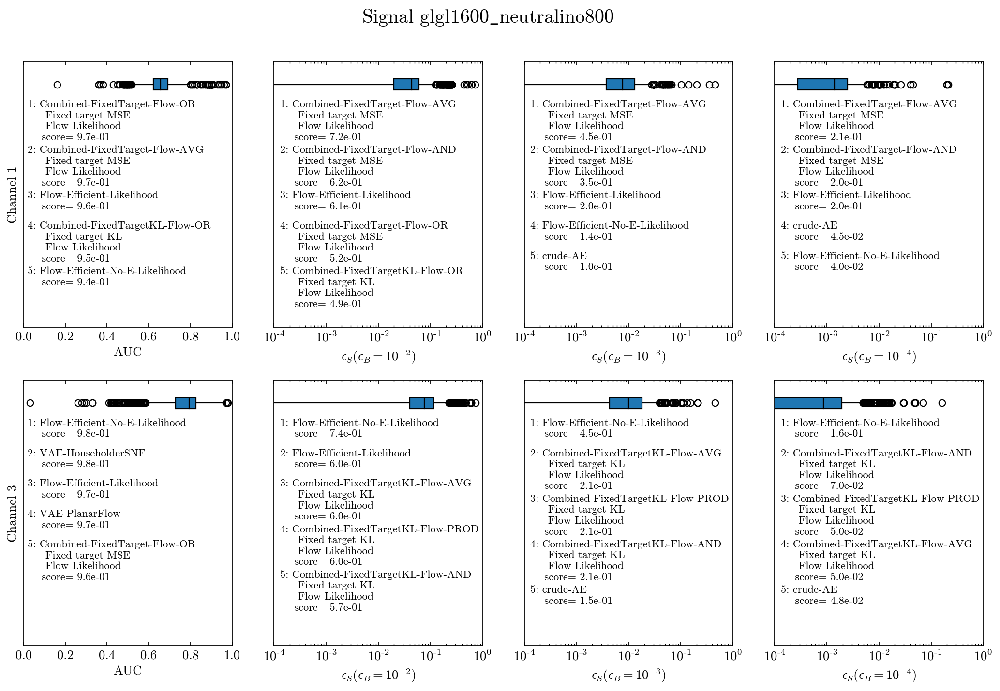

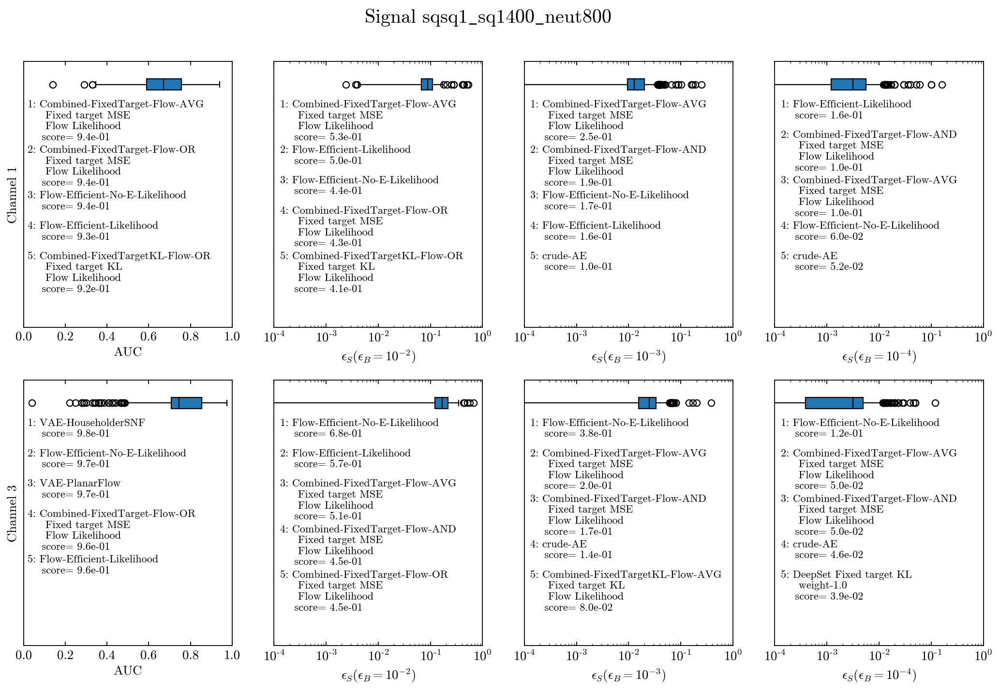

...

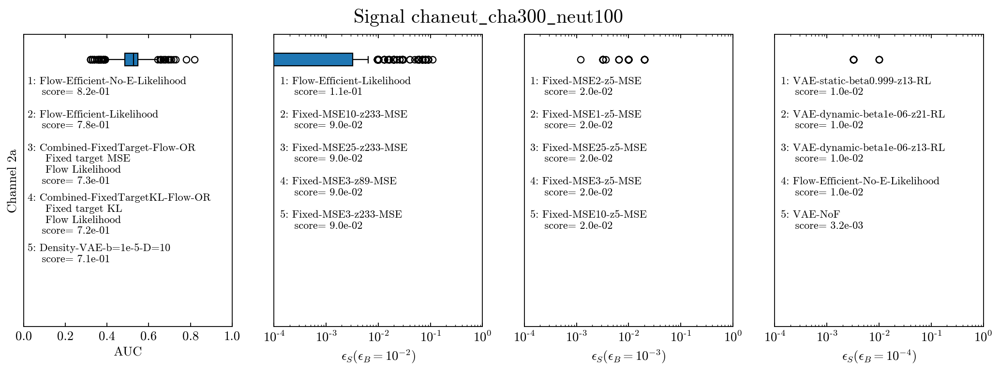

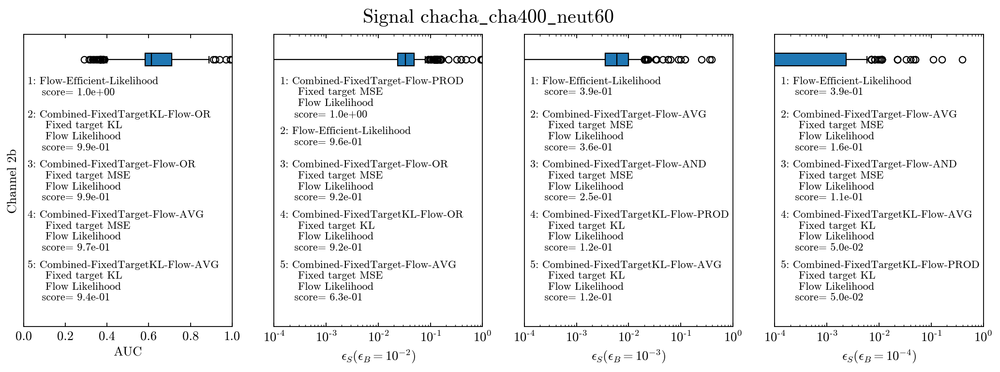

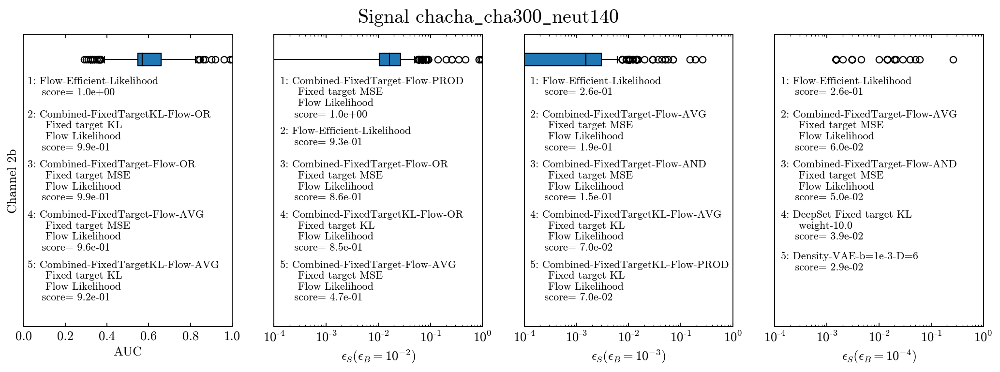

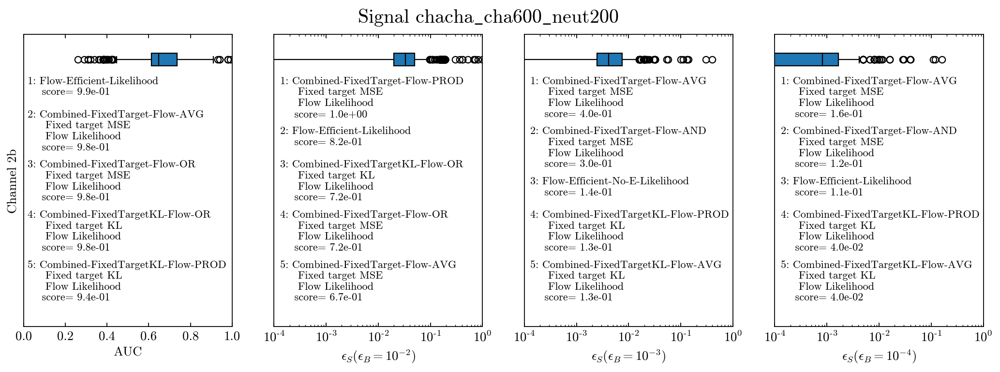

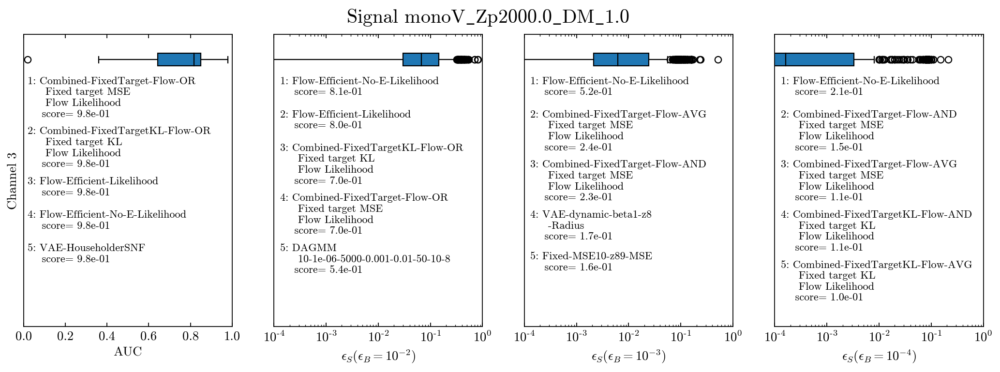

In [82]:
AllSigs = list(AllCombined['Signal'].unique())
for sig in AllSigs:
    tmp_df = AllCombined[AllCombined['Signal'] == sig]
    channels = list(tmp_df.Chan.unique())
    lc = len(channels)
    plt.figure(figsize=(4*4, 5.*lc))
    gs0 = gs.GridSpec(lc, 4, hspace=0.2)
    
    for i, chan in enumerate(channels):
        tmp_df = AllCombined[(AllCombined['Signal'] == sig) & (AllCombined['Chan'] == chan)]
        for j, metric in enumerate(['AUC', '1e-2', '1e-3', '1e-4']):
            plt.subplot(gs0[(i*4)+j])
            myones = np.ones(len(tmp_df))
#             plt.scatter(tmp_df[metric], myones, rasterized=True)
            plt.boxplot(np.array(tmp_df[metric]).reshape(-1, 1),
                        vert=False,
                        manage_ticks=False,
                        patch_artist=True,
                        medianprops={'color':'k'},
                        positions=[1.2]
                       )
            top_models = list(tmp_df.sort_values(by=metric, ascending=False)['Model'][:5])
            plt.ylim(-2, 1.5)
            base = 1
            for mn in range(5):
                change = 0.4
                mod = top_models[mn]
                if len(mod.split('+')) == 2:
                    change+=0.2
                elif 'enc' in mod:
                    change+=0.1
                elif 'DeepSet' in mod:
                    change+=0.1
                elif 'Radius' in mod:
                    change+=0.1
                elif 'DAGMM' in mod:
                    change+=0.1
                    
                plt.text(0.02 if metric == 'AUC' else (np.log10(20))*1e-4,
                         base,
                         (f'{mn + 1}: {top_models[mn]}'.replace('+', '\n    ').replace('_','-')).replace('-Fixed target','\n     Fixed target').replace('-enc', '\n     enc').replace(' weight-', '\n     weight-').replace('-weight-', '\n     weight-').replace('-Radius', '\n     -Radius').replace('DAGMM-', 'DAGMM\n     ') + '\n    score=' f" {float(tmp_df[tmp_df['Model']==top_models[mn]][metric]):.1e}",
                         fontsize=10,
                         ha='left',
                         va='top'
                        )
                base -= change
            if metric == 'AUC':
                plt.xlim(0, 1)
                plt.ylabel(f'Channel {chan}')
                plt.xlabel('AUC')
            else:
                plt.xlim(1e-4, 1)
                plt.xscale('log')
                plt.xticks([1e-4, 1e-3, 1e-2, 1e-1, 1])
                if metric == '1e-2':
                    plt.xlabel(r'$\epsilon_S(\epsilon_B = 10^{-2})$')
                if metric == '1e-3':
                    plt.xlabel(r'$\epsilon_S(\epsilon_B = 10^{-3})$')
                if metric == '1e-4':
                    plt.xlabel(r'$\epsilon_S(\epsilon_B = 10^{-4})$')
            plt.yticks([])
            
    plt.suptitle(f'Signal {sig}'.replace("_", r"$\_$"), fontsize=18, y=0.95)
#     plt.tight_layout()
    
    plt.savefig(f'IndividualSignal_{sig}.pdf', bbox_inches='tight')
    plt.show()


Combine into a single plot

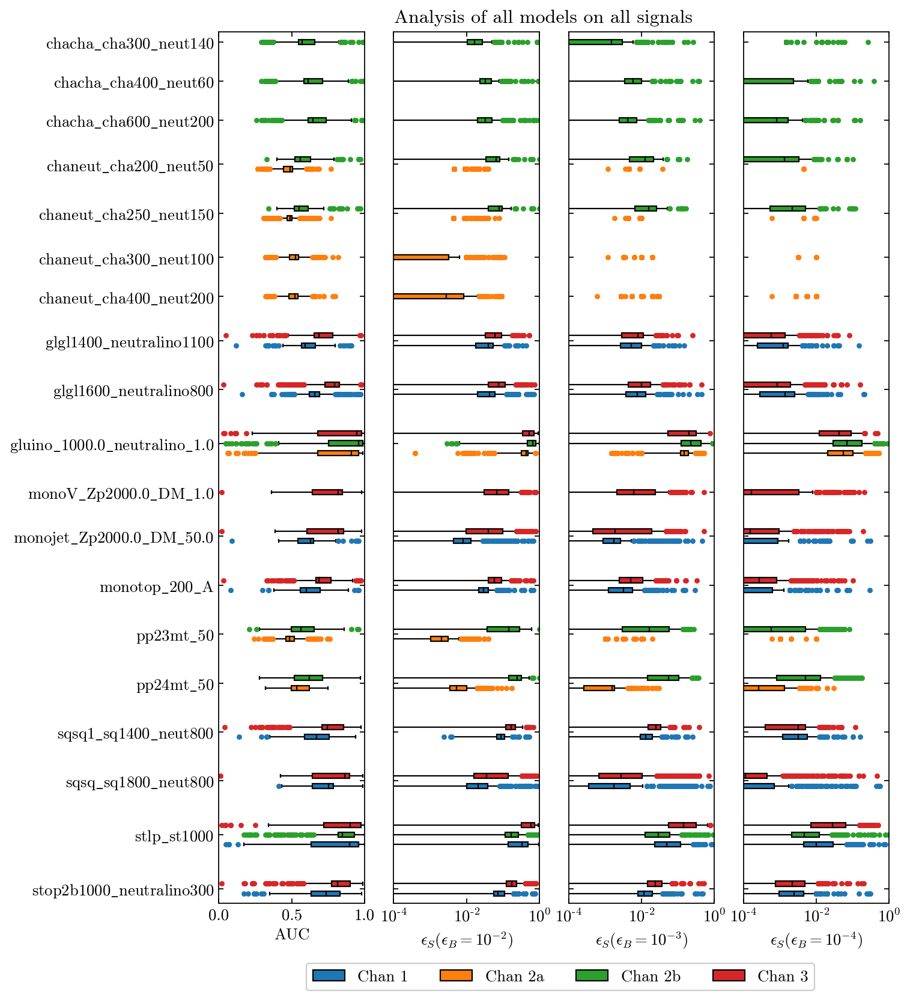

In [83]:
counter = 0
yvs = []
ListAUC = []
List1m2 = []
List1m3 = []
List1m4 = []
my_yticks = []
my_ynames = []
mycolors = []
colordict = {'1': 'C0', '2a': 'C1', '2b': 'C2', '3': 'C3'}
plt.figure(figsize=(9, 12))
for sig in np.sort(AllSigs)[::-1]:
    tmp_df = AllCombined[AllCombined['Signal'] == sig]
    channels = list(tmp_df.Chan.unique())
    lc = len(channels)
    
    tmp_yn = []
    for i, chan in enumerate(channels):
        tmp_df = AllCombined[(AllCombined['Signal'] == sig) & (AllCombined['Chan'] == chan)]
        
        ListAUC.append(tmp_df['AUC'])
        List1m2.append(tmp_df['1e-2'])
        List1m3.append(tmp_df['1e-3'])
        List1m4.append(tmp_df['1e-4'])
        yvs.append(counter)
        tmp_yn.append(counter)
        counter += 1
        mycolors.append(colordict[chan])
    counter += 3
    my_yticks.append(np.mean(tmp_yn))
    my_ynames.append(sig.replace('_', '$\_$'))
plt.subplot(1, 4, 1)    
bbox1 = plt.boxplot(np.array(ListAUC).T,
            vert=False,
            manage_ticks=False,
            patch_artist=True,
            medianprops={'color':'k'},
            positions=yvs
           )
plt.xlim(0, 1)
plt.yticks(my_yticks, my_ynames)
plt.xlabel('AUC')
for patch, flier, color in zip(bbox1['boxes'], bbox1['fliers'], mycolors):
    patch.set_facecolor(color)
    flier.set_markerfacecolor(color)
    flier.set_markerfacecolor(color)
    flier.set_markersize(3)
    flier.set_markeredgecolor(color)
plt.ylim(min(yvs)-1, max(yvs)+1)

plt.subplot(1, 4, 2)    
bbox1 = plt.boxplot(np.array(List1m2).T,
            vert=False,
            manage_ticks=False,
            patch_artist=True,
            medianprops={'color':'k'},
            positions=yvs
           )
plt.xscale('log')
plt.xlim(1e-4, 1)
plt.yticks(my_yticks, [])
plt.xlabel(r'$\epsilon_S(\epsilon_B = 10^{-2})$')
for patch, flier, color in zip(bbox1['boxes'], bbox1['fliers'], mycolors):
    patch.set_facecolor(color)
    flier.set_markerfacecolor(color)
    flier.set_markerfacecolor(color)
    flier.set_markersize(3)
    flier.set_markeredgecolor(color)
plt.ylim(min(yvs)-1, max(yvs)+1)

plt.subplot(1, 4, 3)    
bbox1 = plt.boxplot(np.array(List1m3).T,
            vert=False,
            manage_ticks=False,
            patch_artist=True,
            medianprops={'color':'k'},
            positions=yvs
           )
plt.xscale('log')
plt.xlim(1e-4, 1)
plt.yticks(my_yticks, [])
plt.xlabel(r'$\epsilon_S(\epsilon_B = 10^{-3})$')
for patch, flier, color in zip(bbox1['boxes'], bbox1['fliers'], mycolors):
    patch.set_facecolor(color)
    flier.set_markerfacecolor(color)
    flier.set_markerfacecolor(color)
    flier.set_markersize(3)
    flier.set_markeredgecolor(color)
plt.ylim(min(yvs)-1, max(yvs)+1)

plt.subplot(1, 4, 4)    
bbox1 = plt.boxplot(np.array(List1m4).T,
            vert=False,
            manage_ticks=False,
            patch_artist=True,
            medianprops={'color':'k'},
            positions=yvs
           )
plt.xscale('log')
plt.xlim(1e-4, 1)
plt.yticks(my_yticks, [])
for patch, flier, color in zip(bbox1['boxes'], bbox1['fliers'], mycolors):
    patch.set_facecolor(color)
    flier.set_markerfacecolor(color)
    flier.set_markerfacecolor(color)
    flier.set_markersize(3)
    flier.set_markeredgecolor(color)
plt.xlabel(r'$\epsilon_S(\epsilon_B = 10^{-4})$')
plt.ylim(min(yvs)-1, max(yvs)+1)
    
    
legend_elements = [Patch(facecolor='C0', edgecolor='k',
                         label='Chan 1'),
                   Patch(facecolor='C1', edgecolor='k',
                         label='Chan 2a'),
                   Patch(facecolor='C2', edgecolor='k',
                         label='Chan 2b'),
                   Patch(facecolor='C3', edgecolor='k',
                         label='Chan 3')
                  ]
plt.legend(handles=legend_elements, 
           loc=(-3, -0.1), 
           labelspacing=1,
           ncol=4,
           facecolor='white',
           framealpha=1,
#            markerscale=100,
           frameon=True)
    
plt.suptitle('Analysis of all models on all signals', y=0.9)
plt.savefig('../reports/Plots/AllModelsAllSignals.pdf', bbox_inches='tight')
plt.show()


# Summary of the summaries
To this point, it is still not obvious what the best model or metric is. To this end, we now define the significance improvement as 

$\rm{Base~Significance} = \frac{N_S }{N_B} = \frac{\sigma_S}{\sqrt{\sigma_B}}$

$\rm{Significance} = \rm{Significance~Improvement}\times\rm{Base~Significance} = \frac{N_S^{\rm{cut}}}{N_B^{\rm{cut}}} = \frac{\epsilon_S * \sigma_S}{\sqrt{\epsilon_B * \sigma_B}} = \frac{\epsilon_S }{\sqrt{\epsilon_B }} \times \rm{Base~Significance}$

In [84]:
AllCombined['SI_1e-2'] = AllCombined['1e-2'] / np.sqrt(1e-2)
AllCombined['SI_1e-3'] = AllCombined['1e-3'] / np.sqrt(1e-3)
AllCombined['SI_1e-4'] = AllCombined['1e-4'] / np.sqrt(1e-4)

AllCombined['SI_All'] = AllCombined[['SI_1e-2', 'SI_1e-3', 'SI_1e-4']].max(axis=1)

In [85]:
AllCombined.sort_values(by='SI_All', ascending=False)

,Signal,Model,Chan,AUC,1e-2,1e-3,1e-4,SI_1e-2,SI_1e-3,SI_1e-4,SI_All
16161,stlp_st1000,Combined-FixedTarget-Flow-AVG_Fixed target MSE...,2b,1,1,1,0.97,10,31.6228,97,97.0
16181,gluino_1000.0_neutralino_1.0,Combined-FixedTarget-Flow-AVG_Fixed target MSE...,2b,1,1,0.98,0.88,10,30.9903,88,88.0
16158,stlp_st1000,Combined-FixedTarget-Flow-AND_Fixed target MSE...,2b,1,0.98,0.93,0.79,9.8,29.4092,79,79.0
16105,stlp_st1000,Combined-FixedTarget-Flow-AVG_Fixed target MSE...,1,1,0.98,0.92,0.78,9.8,29.093,78,78.0
16333,gluino_1000.0_neutralino_1.0,Combined-FixedTargetKL-Flow-AVG_Fixed target K...,2b,1,0.97,0.85,0.69,9.7,26.8794,69,69.0
...,...,...,...,...,...,...,...,...,...,...,...
27724,chaneut_cha250_neut150,DAGMM_20_1e-06_1000_0.001_0.01_50_10_4,2a,0.505433,0,0,0,0,0,0,0.0
27723,chaneut_cha300_neut100,DAGMM_20_1e-06_5000_0.01_0.001_50_10_4,2a,0.517232,0,0,0,0,0,0,0.0
27722,chaneut_cha200_neut50,DAGMM_20_1e-06_5000_0.01_0.001_50_10_4,2a,0.494302,0,0,0,0,0,0,0.0
3718,chaneut_cha250_neut150,LS_Average_13_1e-05_1000,2a,0.490758,0,0,0,0,0,0,0.0


Now find the min, median, and maximum signal improvents for each method across the different signals.

In [86]:
AllMods = list(AllCombined['Model'].unique())
SI_DF = pd.DataFrame()
SI_DF['Model'] = AllMods

for sig in AllSigs:
    si_list = []
    for mod in AllMods:
        tmp_df = AllCombined[(AllCombined['Model'] == mod)]
        si_list.append(tmp_df[tmp_df['Signal'] == sig]['SI_All'].max())
    SI_DF[sig] = si_list
#     plt.scatter(np.min(si_list), np.max(si_list))
# plt.show()

In [87]:
SI_DF['MinSigI'] = SI_DF[[col for col in SI_DF if 'Model' not in col]].min(axis=1)
SI_DF['MaxSigI'] = SI_DF[[col for col in SI_DF if (('Model' not in col) and ('MinSigI' not in col))]].max(axis=1)
SI_DF['MedianSigI'] = SI_DF[[col for col in SI_DF if (('Model' not in col) and ('MinSigI' not in col) and ('MaxSigI' not in col))]].median(axis=1)

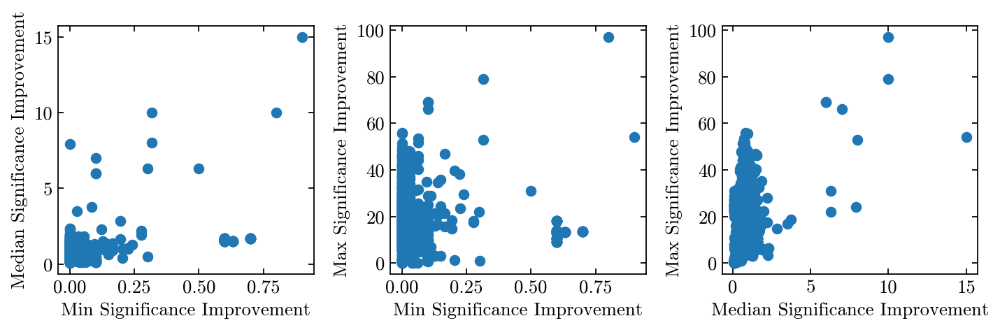

In [88]:
plt.figure(figsize=(9, 3))

plt.subplot(1, 3, 1)
plt.scatter(SI_DF['MinSigI'], SI_DF['MedianSigI'])
plt.xlabel('Min Significance Improvement')
plt.ylabel('Median Significance Improvement')

plt.subplot(1, 3, 2)
plt.scatter(SI_DF['MinSigI'], SI_DF['MaxSigI'])
plt.xlabel('Min Significance Improvement')
plt.ylabel('Max Significance Improvement')

plt.subplot(1, 3, 3)
plt.scatter(SI_DF['MedianSigI'], SI_DF['MaxSigI'])
plt.xlabel('Median Significance Improvement')
plt.ylabel('Max Significance Improvement')

plt.tight_layout()

This plot is nice, but we want to gain some information about the different methods. Try clustering with KMeans or using a summary of each method.

In [89]:
from sklearn.cluster import KMeans, DBSCAN
from sklearn.preprocessing import MinMaxScaler

In [90]:
normed_data=SI_DF[['MinSigI', 'MedianSigI', 'MaxSigI']].copy()
mms = MinMaxScaler()
normed_data = mms.fit_transform(normed_data)

In [91]:
kmint = 4
km = KMeans(n_clusters=kmint, random_state=0)

In [92]:
SI_DF['km4'] = km.fit_predict(normed_data)

In [93]:
## Save the clustering results
with open('KMeansClustering.pkl', 'wb') as f:
    pickle.dump(km, f)

In [94]:
with open('KMeansClustering.pkl', 'rb') as f:
    km = pickle.load(f)

In [95]:
kmlist = np.argsort([np.sum(SI_DF['km4'] == i) for i in range(kmint)])
for i, k in enumerate(kmlist):
    SI_DF.loc[SI_DF['km4'] == i,'km'] = k

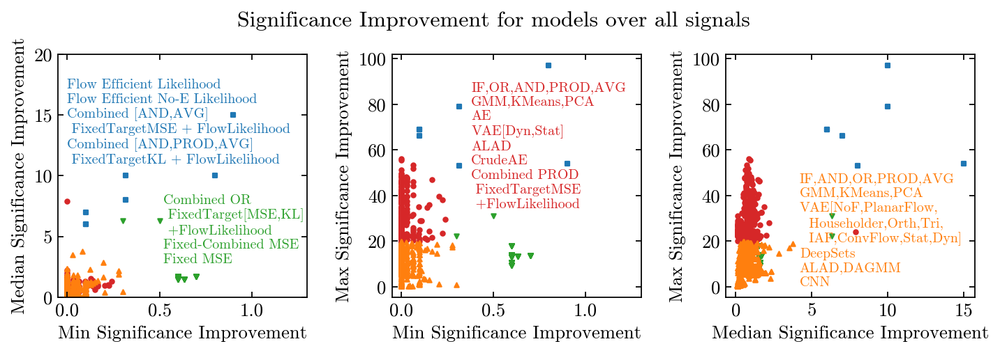

In [96]:
plt.figure(figsize=(9, 3))
mymarkers = ['o', 'v', '^', 's']

plt.subplot(1, 3, 1)
for i in range(kmint):
    tmpdf=SI_DF[SI_DF['km']==i]
    plt.scatter(tmpdf['MinSigI'], tmpdf['MedianSigI'], color=f'C{3-i}', marker=mymarkers[i], s=8, rasterized=True)
plt.xlabel('Min Significance Improvement')
plt.ylabel('Median Significance Improvement')

plt.text(0.52, 8.5, 'Combined OR\n FixedTarget[MSE,KL]\n +FlowLikelihood\nFixed-Combined MSE\nFixed MSE', ha='left', va='top', fontsize=9, color='C2')
plt.text(0.0 , 18, 'Flow Efficient Likelihood\nFlow Efficient No-E Likelihood\nCombined [AND,AVG]\n FixedTargetMSE + FlowLikelihood\nCombined [AND,PROD,AVG]\n FixedTargetKL + FlowLikelihood', ha='left', va='top', fontsize=9, color='C0')
plt.ylim(0, 20)
plt.xlim(-0.05, 1.3)

plt.subplot(1, 3, 2)
for i in range(kmint):
    tmpdf=SI_DF[SI_DF['km']==i]
    plt.scatter(tmpdf['MinSigI'], tmpdf['MaxSigI'], color=f'C{3-i}', marker=mymarkers[i], s=8, rasterized=True)
plt.xlabel('Min Significance Improvement')
plt.ylabel('Max Significance Improvement')
plt.text(0.38 , 90, 'IF,OR,AND,PROD,AVG\nGMM,KMeans,PCA\nAE\nVAE[Dyn,Stat]\nALAD\nCrudeAE\nCombined PROD\n FixedTargetMSE\n +FlowLikelihood', ha='left', va='top', fontsize=9, color='C3')
plt.xlim(-0.05, 1.3)


plt.subplot(1, 3, 3)
for i in range(kmint):
    tmpdf=SI_DF[SI_DF['km']==i]
    plt.scatter(tmpdf['MedianSigI'], tmpdf['MaxSigI'], color=f'C{3-i}', marker=mymarkers[i], s=8, rasterized=True)
plt.xlabel('Median Significance Improvement')
plt.ylabel('Max Significance Improvement')
plt.text(4.2, 50, 'IF,AND,OR,PROD,AVG\nGMM,KMeans,PCA\nVAE[NoF,PlanarFlow,\n  Householder,Orth,Tri,\n  IAF,ConvFlow,Stat,Dyn]\nDeepSets\nALAD,DAGMM\nCNN'
         , ha='left', va='top', fontsize=9, color='C1')


plt.tight_layout()
plt.suptitle('Significance Improvement for models over all signals' , y=1.05)  # ' + ' $(\epsilon_S / \sqrt{\epsilon_B})$' + '

plt.savefig('SummaryOfSummaries.pdf', bbox_inches='tight')
plt.show()

The K-Means clustering shows some information, but it is still hard to interpret, as many model types show up in each cluster. Maybe it is better to just look at each model type individually.

In [97]:
mycolors = ['#a6cee3',  # Latent Space Model,
            '#ffff99',  # ALAD
            '#b15928',  # DAGMM
            '#1f78b4',  # Normalizing Flow Models
            '#b2df8a',  # DensityBasedModels
            '#33a02c',  # VAE_MODELS
            '#fb9a99',  # Flow-Efficient Models
            '#e31a1c',  # CombinedModels
            '#fdbf6f',  # FixedTargetModels
            '#ff7f00',  # DeepSetModels
            '#cab2d6',  # Cude AE
            '#6a3d9a',  # CNN
           ]

mymarkers = ['o',  # Latent Space Models
             'P',  # ALAD
             'X',  # DAGMM
             'v',  # Normalizing Flow Models
             '^',  # DensityBasedModels
             '<',  # VAE_MODELS
             '*',  # Flow-Efficient Models
             's',  # CombinedModels
             'p',  # FixedTargetModels
             '>',  # DeepSetModels
             'h',  # Cude AE
             'D',  # CNN
            ]

mymodel_list = [SI_DF[SI_DF['Model'].str.startswith('LS')],  # Latent Space Models,
                SI_DF[SI_DF['Model'].str.startswith('ALAD')],  # ALAD
                SI_DF[SI_DF['Model'].str.startswith('DAGMM')],  # DAGMM
                SI_DF[SI_DF['Model'].isin(NormalizingFlowModels)],  # Normalizing Flow Models
                SI_DF[SI_DF['Model'].isin(DensityBasedModels)],  # DensityBasedModels
                SI_DF[SI_DF['Model'].isin(VAE_MODELS)],  # VAE_MODELS
                SI_DF[SI_DF['Model'].str.startswith('Flow-Efficient')],  # Flow-Efficient Models
                SI_DF[SI_DF['Model'].isin(CombinedModels)],  # CombinedModels
                SI_DF[SI_DF['Model'].isin(FixedTargetModels)],  # FixedTargetModels
                SI_DF[SI_DF['Model'].isin(DeepSetModels)],  # DeepSetModels
                SI_DF[SI_DF['Model'].str.startswith('crude')],  # Cude AE
                SI_DF[SI_DF['Model'].str.startswith('CNN')],  # CNN
                
               ]

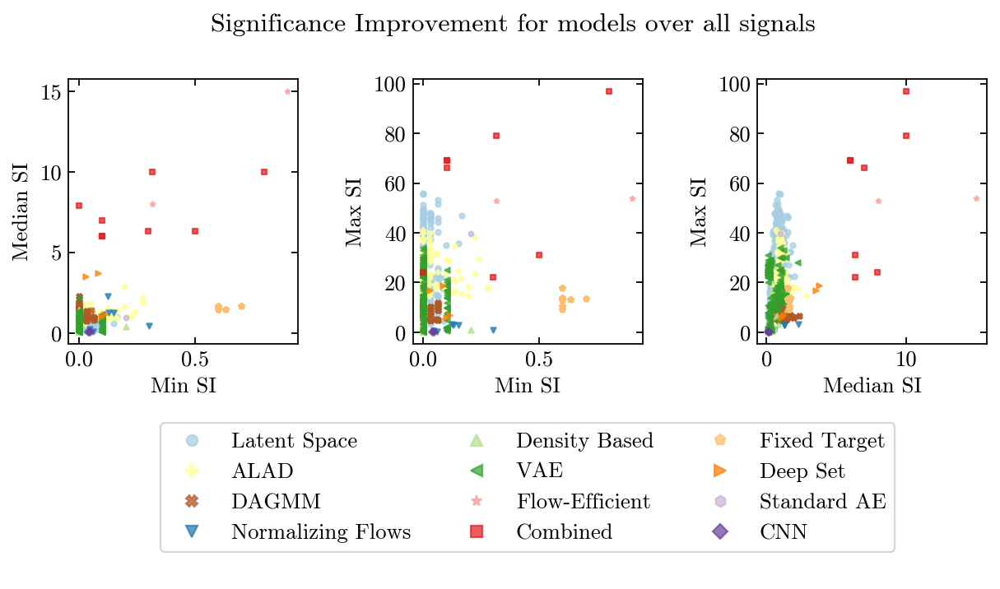

In [98]:
plt.figure(figsize=(9, 5))

gs0 = gs.GridSpec(2, 1, height_ratios=[3, 2], hspace=0.25)
gs00 = gs.GridSpecFromSubplotSpec(1, 3, gs0[0], wspace=0.5)
plt.subplot(gs00[0])
for i, model in enumerate(mymodel_list):
    tmpdf=model
    plt.scatter(tmpdf['MinSigI'], tmpdf['MedianSigI'], color=mycolors[i], marker=mymarkers[i], s=8, alpha=0.7, rasterized=True)
plt.xlabel('Min SI')
plt.ylabel('Median SI')


plt.subplot(gs00[1])
for i, model in enumerate(mymodel_list):
    tmpdf=model
    plt.scatter(tmpdf['MinSigI'], tmpdf['MaxSigI'], color=mycolors[i], marker=mymarkers[i], s=8, alpha=0.7, rasterized=True)
plt.xlabel('Min SI')
plt.ylabel('Max SI')



plt.subplot(gs00[2])
for i, model in enumerate(mymodel_list):
    tmpdf=model
    plt.scatter(tmpdf['MedianSigI'], tmpdf['MaxSigI'], color=mycolors[i], marker=mymarkers[i], s=8, alpha=0.7, rasterized=True)
plt.xlabel('Median SI')
plt.ylabel('Max SI')

plt.suptitle('Significance Improvement for models over all signals')  # ' + ' $(\epsilon_S / \sqrt{\epsilon_B})$' + '


plt.subplot(gs0[1])
plt.legend([Line2D([0], [0], color=mycolors[i], marker=mymarkers[i], alpha=0.7, linestyle='None') for i in range(12)],
           ['Latent Space', 'ALAD', 'DAGMM',
            'Normalizing Flows', 'Density Based', 'VAE',
            'Flow-Efficient', 'Combined', 'Fixed Target',
            'Deep Set', 'Standard AE', 'CNN'
           ],
           ncol=3,
           loc='center'
          )
plt.axis('off')
plt.savefig('SummaryOfSummaries_modelclustering.pdf', bbox_inches='tight')
plt.show()

In [99]:
from mpl_toolkits.mplot3d import Axes3D 

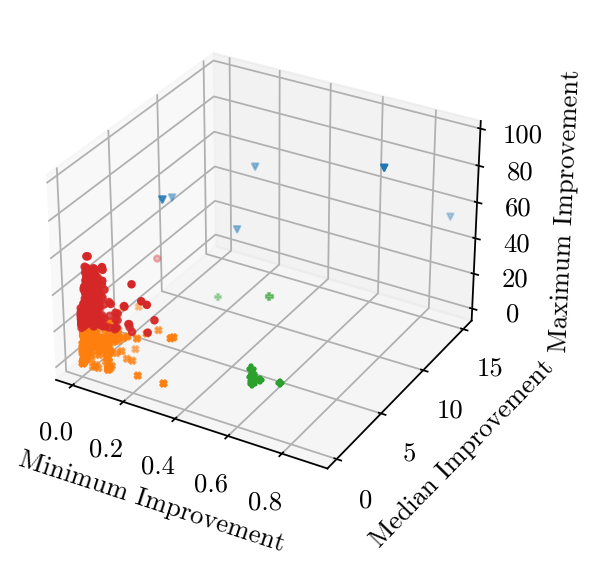

In [100]:
fig = plt.figure(figsize=(4, 4))
ax = plt.subplot(1, 1, 1, projection='3d')
for i in range(kmint):
    tmpdf=SI_DF[SI_DF['km']==i]
    ax.scatter(xs=tmpdf['MinSigI'], ys=tmpdf['MedianSigI'], zs=tmpdf['MaxSigI'], color=f'C{3-i}', marker=mymarkers[i], s=8)

ax.set_xlabel('Minimum Improvement')
ax.set_ylabel('Median Improvement')
ax.set_zlabel('Maximum Improvement')
# ax.view_init(30, 90)
fig.canvas.toolbar_visible = True
display(fig.canvas)
plt.savefig('Summary_3d.pdf', bbox_inches='tight')

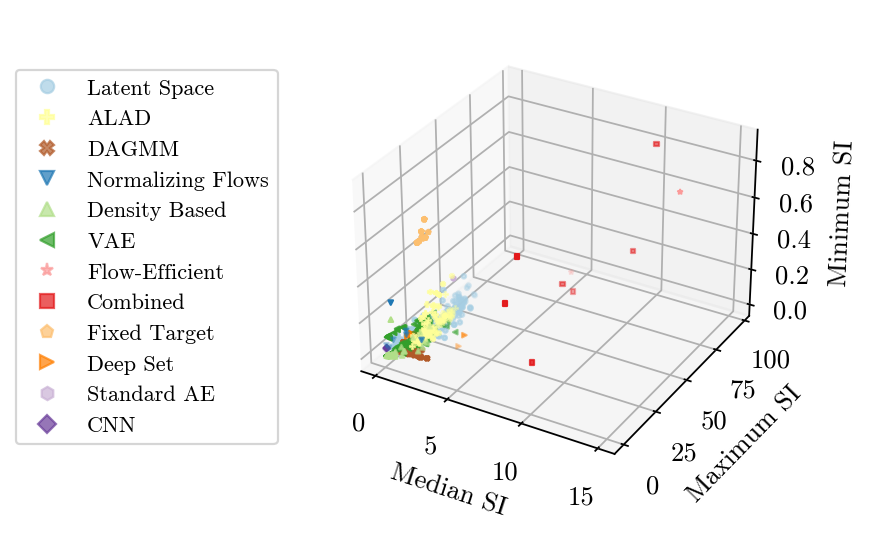

In [101]:
fig = plt.figure(figsize=(6, 4))
gs0 = gs.GridSpec(1, 2, width_ratios=[1, 2], hspace=0.5)

plt.subplot(gs0[0])
plt.legend([Line2D([0], [0], color=mycolors[i], marker=mymarkers[i], alpha=0.7, linestyle='None') for i in range(12)],
           ['Latent Space', 'ALAD', 'DAGMM',
            'Normalizing Flows', 'Density Based', 'VAE',
            'Flow-Efficient', 'Combined', 'Fixed Target',
            'Deep Set', 'Standard AE', 'CNN'
           ],
           ncol=1,
           loc='center',
           fontsize=10
          )
plt.axis('off')


ax = plt.subplot(gs0[1], projection='3d')
for i, model in enumerate(mymodel_list):
    tmpdf=model
    ax.scatter(zs=tmpdf['MinSigI'], xs=tmpdf['MedianSigI'], ys=tmpdf['MaxSigI'], color=mycolors[i], marker=mymarkers[i], s=4)

ax.set_zlabel('Minimum SI')
ax.set_xlabel('Median SI')
ax.set_ylabel('Maximum SI')
# ax.view_init(30, 90)
fig.canvas.toolbar_visible = True
display(fig.canvas)
plt.savefig('Summary_3d_modelclustering.pdf', bbox_inches='tight')

We now want to run the models which have a meidan improvement of at least 2.0 on the secret dataset. Find these models to alert those who need to analyze the next dataset.

In [102]:
highscores = list(SI_DF[SI_DF['MedianSigI'] > 2]['Model'])
BaseModels = [
    ['AL', AL['Model']],
    ['PJ', PJ['Model']],
    ['AM',  AM['Model']],
    ['LH_VAE', LH_VAE['Model']],
    ['LH_Flow', LH_Flow['Model']],
    ['LH_Combined', LH_Combined['Model']],
    ['LH_Fixed', LH_Fixed['Model']],
    ['BO', BO['Model']],
    ['RR_ALAD', RR_ALAD['Model']],
    ['RR_DAGM', RR_DAGM['Model']],
    ['BR', BR['Model']],
    ['JD_VAE', JD_VAE['Model']],
    ['JD_BVAE', JD_BVAE['Model']]
]

topmethods = []
for person, models in BaseModels:
    models = models.unique()
    for model in models:
        for hs in highscores:
            if hs == model:
                print(person, hs, SI_DF[SI_DF['Model']==model]['MedianSigI'])
                topmethods.append([person, hs, float(SI_DF[SI_DF['Model']==model]['MedianSigI'])])

PJ VAE_PlanarFlow 289    2.283526
Name: MedianSigI, dtype: float64
LH_VAE VAE-dynamic-beta1-z13_Radius 462    2.2
Name: MedianSigI, dtype: float64
LH_Flow Flow-Efficient_Likelihood 471    15.0
Name: MedianSigI, dtype: float64
LH_Flow Flow-Efficient-No-E_Likelihood 472    8.0
Name: MedianSigI, dtype: float64
LH_Combined Combined-FixedTarget-Flow-AND_Fixed target MSE + Flow Likelihood 473    10.0
Name: MedianSigI, dtype: float64
LH_Combined Combined-FixedTarget-Flow-OR_Fixed target MSE + Flow Likelihood 474    6.3
Name: MedianSigI, dtype: float64
LH_Combined Combined-FixedTarget-Flow-PROD_Fixed target MSE + Flow Likelihood 475    7.905694
Name: MedianSigI, dtype: float64
LH_Combined Combined-FixedTarget-Flow-AVG_Fixed target MSE + Flow Likelihood 476    10.0
Name: MedianSigI, dtype: float64
LH_Combined Combined-FixedTargetKL-Flow-AND_Fixed target KL + Flow Likelihood 477    7.0
Name: MedianSigI, dtype: float64
LH_Combined Combined-FixedTargetKL-Flow-OR_Fixed target KL + Flow Likelihood 4

In [103]:
sortedargs = np.argsort(np.array(topmethods)[:, 2].astype(float))

In [104]:
with open('HighMedianScores.txt', 'w') as f:
    f.write('File, Model, MedianSignificanceImprovement\n')
    for arg in sortedargs:
        print(', '.join(np.array(topmethods[arg])))
        f.write(', '.join(np.array(topmethods[arg])))
        f.write('\n')


RR_ALAD, ALAD_ld10_lr1e-5_bs5000_epoch2000_enc512_F_sc, 2.198706643151088
LH_VAE, VAE-dynamic-beta1-z13_Radius, 2.1999999999999997
PJ, VAE_PlanarFlow, 2.283526101906846
RR_DAGM, DAGMM_10_1e-07_1000_0.01_0.01_50_15_8, 2.314541850035057
RR_DAGM, DAGMM_10_1e-07_1000_0.001_0.01_50_15_8, 2.314541850035057
RR_ALAD, ALAD_ld10_lr1e-5_bs500_epoch2000_enc512_F_sc, 2.8511530398322846
BO, DeepSet Fixed target KL weight_1.0, 3.503582933762497
BO, DeepSet Fixed target KL weight_10.0, 3.74761070720423
LH_Combined, Combined-FixedTargetKL-Flow-PROD_Fixed target KL + Flow Likelihood, 6.0
LH_Combined, Combined-FixedTargetKL-Flow-AVG_Fixed target KL + Flow Likelihood, 6.0
LH_Combined, Combined-FixedTarget-Flow-OR_Fixed target MSE + Flow Likelihood, 6.3
LH_Combined, Combined-FixedTargetKL-Flow-OR_Fixed target KL + Flow Likelihood, 6.3
LH_Combined, Combined-FixedTargetKL-Flow-AND_Fixed target KL + Flow Likelihood, 7.000000000000001
LH_Combined, Combined-FixedTarget-Flow-PROD_Fixed target MSE + Flow Likeliho

Make a summary plot from the group with the highest improvements.

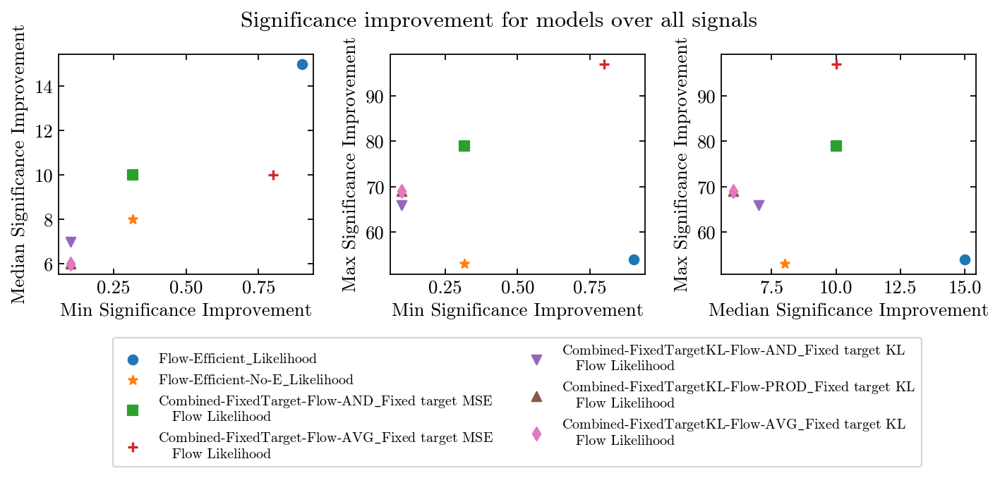

In [105]:
plt.figure(figsize=(9, 4))
gs0 = gs.GridSpec(2, 1, height_ratios=[3, 1])
gs00 = gs.GridSpecFromSubplotSpec(1, 3, gs0[0], wspace=0.3, hspace=5)
i=3
plt.subplot(gs00[0])
markerdict = {0: 'o',
              1: '*',
              2: 's',
              3: '+',
              4: 'v',
              5: '^',
              6: 'd',
              7: 'p'
             }

tmpdf=SI_DF[SI_DF['km']==i]
for kk, mod in enumerate(list(tmpdf['Model'])):
    tmpdf2=tmpdf[tmpdf['Model'] == mod]
    plt.scatter(tmpdf2['MinSigI'], tmpdf2['MedianSigI'], color=f'C{kk}',
                marker=markerdict[kk]
               )
#     plt.text(tmpdf2['MinSigI'], tmpdf2['MedianSigI'], mod.replace('VAE_beta_1.0', 'Fixed KL').replace('+', '\n'),
#              fontsize=8,
#              ha='left' if float(tmpdf2['MinSigI']) < 0.04 else 'right'
#             )
plt.xlabel('Min Significance Improvement')
plt.ylabel('Median Significance Improvement')

plt.subplot(gs00[1])

tmpdf=SI_DF[SI_DF['km']==i]
for kk, mod in enumerate(list(tmpdf['Model'])):
    tmpdf2=tmpdf[tmpdf['Model'] == mod]
    plt.scatter(tmpdf2['MinSigI'], tmpdf2['MaxSigI'], color=f'C{kk}', label=mod.replace('VAE_beta_1.0', '-Fixed KL').replace('_', r'$\_$').replace('+', '\n'),
               marker=markerdict[kk])
plt.xlabel('Min Significance Improvement')
plt.ylabel('Max Significance Improvement')


plt.subplot(gs00[2])

tmpdf=SI_DF[SI_DF['km']==i]
for kk, mod in enumerate(list(tmpdf['Model'])):
    tmpdf2=tmpdf[tmpdf['Model'] == mod]
    plt.scatter(tmpdf2['MedianSigI'], tmpdf2['MaxSigI'], 
                color=f'C{kk}',
                marker=markerdict[kk]
               )
plt.xlabel('Median Significance Improvement')
plt.ylabel('Max Significance Improvement')

plt.subplot(gs0[1])
for kk, mod in enumerate(list(tmpdf['Model'])):
    tmpdf2=tmpdf[tmpdf['Model'] == mod]
    plt.scatter([], [], color=f'C{kk}',
                marker=markerdict[kk],
                label=mod.replace('VAE_beta_1.0', '-Fixed KL').replace('_', r'$\_$').replace('+', '\n  '),
               )
plt.legend(fontsize=9,
           loc='center',
           ncol=2
          )
plt.axis('off')

plt.tight_layout(w_pad=10)
plt.suptitle('Significance improvement for models over all signals' , y=1.05)  # ' + ' $(\epsilon_S / \sqrt{\epsilon_B})$' + '

plt.savefig('SummaryOfSummaries_best.pdf', bbox_inches='tight')
plt.show()

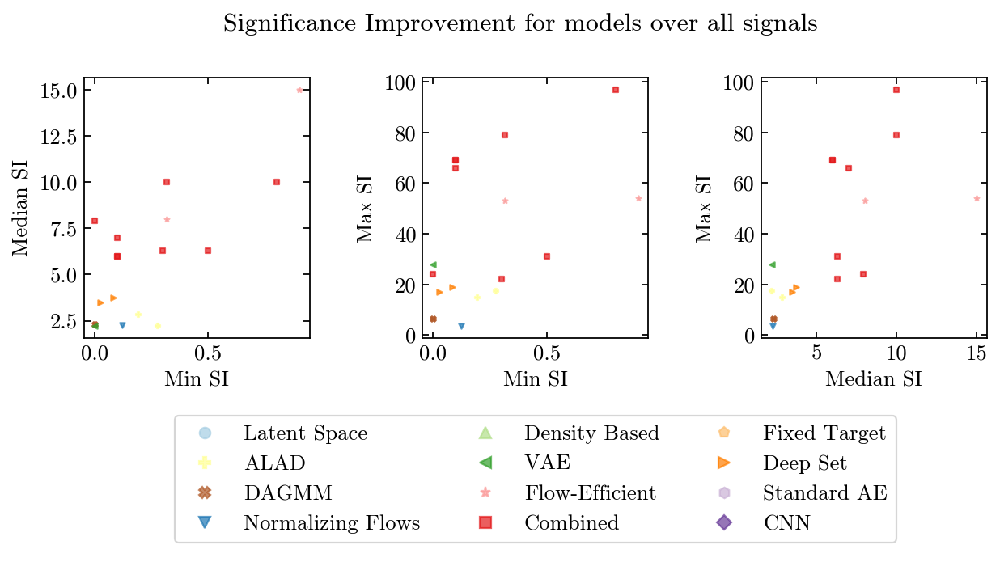

In [106]:
plt.figure(figsize=(9, 5))

gs0 = gs.GridSpec(2, 1, height_ratios=[3, 2], hspace=0.25)
gs00 = gs.GridSpecFromSubplotSpec(1, 3, gs0[0], wspace=0.5)
plt.subplot(gs00[0])
for i, model in enumerate(mymodel_list):
    tmpdf=model
    tmpdf = tmpdf[tmpdf['MedianSigI'] > 2]
    plt.scatter(tmpdf['MinSigI'], tmpdf['MedianSigI'], color=mycolors[i], marker=mymarkers[i], s=8, alpha=0.7, rasterized=True)
plt.xlabel('Min SI')
plt.ylabel('Median SI')


plt.subplot(gs00[1])
for i, model in enumerate(mymodel_list):
    tmpdf=model
    tmpdf = tmpdf[tmpdf['MedianSigI'] > 2]
    plt.scatter(tmpdf['MinSigI'], tmpdf['MaxSigI'], color=mycolors[i], marker=mymarkers[i], s=8, alpha=0.7, rasterized=True)
plt.xlabel('Min SI')
plt.ylabel('Max SI')



plt.subplot(gs00[2])
for i, model in enumerate(mymodel_list):
    tmpdf=model
    tmpdf = tmpdf[tmpdf['MedianSigI'] > 2]
    plt.scatter(tmpdf['MedianSigI'], tmpdf['MaxSigI'], color=mycolors[i], marker=mymarkers[i], s=8, alpha=0.7, rasterized=True)
plt.xlabel('Median SI')
plt.ylabel('Max SI')

plt.suptitle('Significance Improvement for models over all signals')  # ' + ' $(\epsilon_S / \sqrt{\epsilon_B})$' + '


plt.subplot(gs0[1])
plt.legend([Line2D([0], [0], color=mycolors[i], marker=mymarkers[i], alpha=0.7, linestyle='None') for i in range(12)],
           ['Latent Space', 'ALAD', 'DAGMM',
            'Normalizing Flows', 'Density Based', 'VAE',
            'Flow-Efficient', 'Combined', 'Fixed Target',
            'Deep Set', 'Standard AE', 'CNN'
           ],
           ncol=3,
           loc='center'
          )
plt.axis('off')
plt.savefig('SummaryOfSummaries_highmedian_modelclustering.pdf', bbox_inches='tight')
plt.show()

Finally, make a summary plot for the physics models.

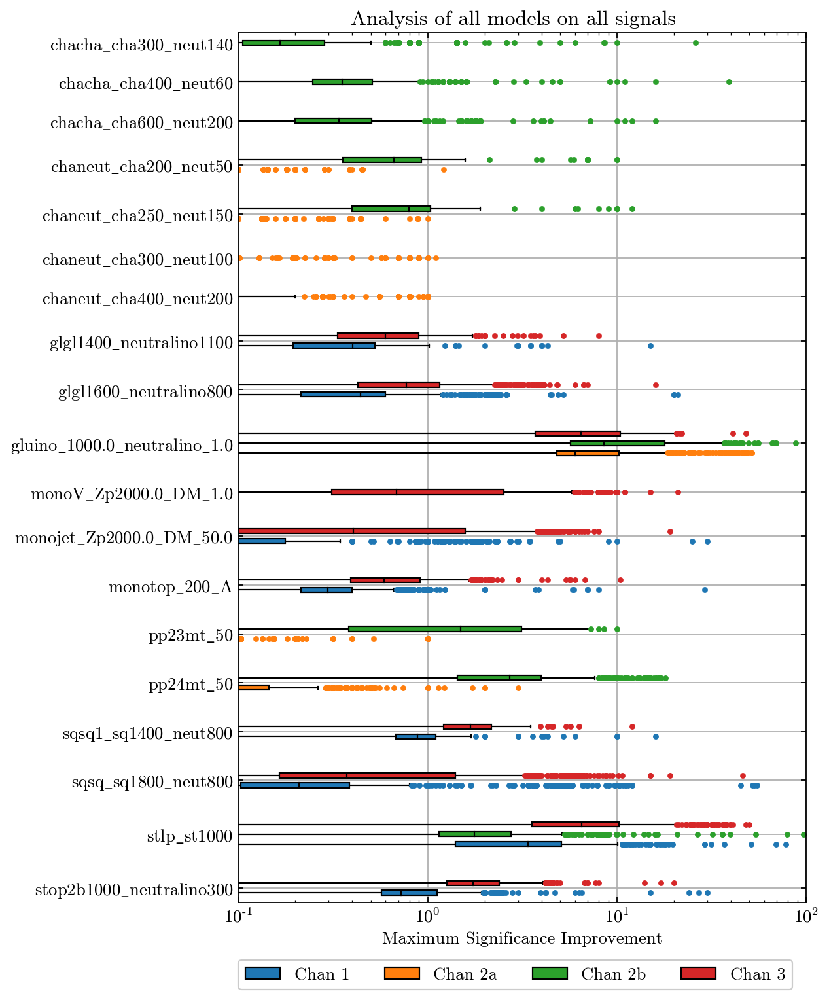

In [107]:
counter = 0
yvs = []
ListSigImp = []
my_yticks = []
my_ynames = []
mycolors = []
colordict = {'1': 'C0', '2a': 'C1', '2b': 'C2', '3': 'C3'}
plt.figure(figsize=(7, 11))
for sig in np.sort(AllSigs)[::-1]:
    tmp_df = AllCombined[AllCombined['Signal'] == sig]
    channels = list(tmp_df.Chan.unique())
    lc = len(channels)
    
    tmp_yn = []
    
    for i, chan in enumerate(channels):
        tmp_df = AllCombined[(AllCombined['Signal'] == sig) & (AllCombined['Chan'] == chan)]
        ListSigImp.append(tmp_df['SI_All'])
        yvs.append(counter)
        tmp_yn.append(counter)
        counter += 1
        mycolors.append(colordict[chan])
    counter += 3
    my_yticks.append(np.mean(tmp_yn))
    my_ynames.append(sig.replace('_', '$\_$'))
# plt.subplot(1, 4, 1)    
bbox1 = plt.boxplot(np.array(ListSigImp).T,
            vert=False,
            manage_ticks=False,
            patch_artist=True,
            medianprops={'color':'k'},
            positions=yvs
           )
plt.yticks(my_yticks, my_ynames)
plt.xlabel('Maximum Significance Improvement')
for patch, flier, color in zip(bbox1['boxes'], bbox1['fliers'], mycolors):
    patch.set_facecolor(color)
    flier.set_markerfacecolor(color)
    flier.set_markerfacecolor(color)
    flier.set_markersize(3)
    flier.set_markeredgecolor(color)
plt.ylim(min(yvs)-1, max(yvs)+1)
plt.xscale('log')
plt.xlim(0.1, 100)
plt.grid()
    
    
legend_elements = [Patch(facecolor='C0', edgecolor='k',
                         label='Chan 1'),
                   Patch(facecolor='C1', edgecolor='k',
                         label='Chan 2a'),
                   Patch(facecolor='C2', edgecolor='k',
                         label='Chan 2b'),
                   Patch(facecolor='C3', edgecolor='k',
                         label='Chan 3')
                  ]
plt.legend(handles=legend_elements, 
           loc=(-0.0, -0.1), 
           labelspacing=1,
           ncol=4,
           facecolor='white',
           framealpha=1,
#            markerscale=100,
           frameon=True)
    
plt.suptitle('Analysis of all models on all signals', y=0.9)
plt.savefig('../reports/Plots/AllModelsAllSignals_SignificanceImprovement.pdf', bbox_inches='tight')
plt.show()
